# Real time object detection

In this notebook, we will run a object detection model based on YOLOv8. The objective is to be able to differentiate between different objects in the street: 2-wheeler, auto, bus, car, crosswalk, traffic signal, truck and van.

The initial dataset used in this project was already annotated, and can be found in the following [link](https://universe.roboflow.com/shruthi-b-w7llf/21-4-22).

Note: this notebook is based on the following [video](https:https://www.youtube.com/watch?v=wuZtUMEiKWY&t=375s&ab_channel=Roboflow//).

Note 2: this notebook was not run linearly, this might lead to some issues with the directory and their names.

## 1.1 Set up

In order to be able to run the model, first we need to set up the notebook. Let´s change the runtime accelarator into GPU.

In [ ]:
# Check that we are using GPU:
!nvidia-smi

Sun Feb 26 19:12:59 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.85.12    Driver Version: 525.85.12    CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   75C    P0    30W /  70W |      0MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

Now let´s import and install all the packages needed for the assigment.

In [ ]:
# Installation of packages:
!pip install ultralytics
!pip install roboflow

# Importation of packages:
import os
from IPython import display
from ultralytics import YOLO
from IPython.display import display, Image
from roboflow import Roboflow

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 301.9/301.9 KB 3.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 184.3/184.3 KB 12.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 140.6/140.6 KB 9.9 MB/s eta 0:00:00
  Attempting uninstall: urllib3
    Found existing installation: urllib3 1.24.3
    Uninstalling urllib3-1.24.3:
      Successfully uninstalled urllib3-1.24.3
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.1/50.1 KB 1.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 KB 7.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 KB 6.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for wget: filename=wget-3.2-py3-none-any.whl size=9674 sha256=1d57c4a532d63652175527c6df928e230f9dbdcc3

We will create the variable HOME, which will be used in order to quickly access the folders were the datasets and the results are going to be saved.

In [ ]:
HOME = os.getcwd()
print(HOME)

/content


Finally, let´s just establish some aspects of YOLO.

In [ ]:
# display.clear_output()
!yolo checks

Ultralytics YOLOv8.0.47 🚀 Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (4 CPUs, 25.5 GB RAM, 25.8/166.8 GB disk)


# 1.2 Uploading the files from Roboflow

After merging the images and their respectives labels in Roboflow (and also solving manually some images for which the label did not existed), let´s upload all the training, validation and test datasets.

In [ ]:
# We go to Home:
%cd {HOME}

# Access to our datasets:
rf = Roboflow(api_key="pRKg4p771axFZRs2W6aQ")
project = rf.workspace("ie-ighjj").project("deep-learning-group-assignment-a38nh")
dataset = project.version(1).download("yolov8")

/content
loading Roboflow workspace...
loading Roboflow project...
Dependency ultralytics<=8.0.20 is required but found version=8.0.47, to fix: `pip install ultralytics<=8.0.20`


Extracting Dataset Version Zip to Deep-Learning---Group-Assignment-1 in yolov8:: 100%|██████████| 21776/21776 [00:03<00:00, 6793.90it/s]


Finally, let´s create the directory **datasets** in order to save all the information there. This will help us to correctly access the data with YOLO.

In [ ]:
# Creation of the directory datasets:
os.mkdir('datasets')

# Moving the downloaded folder from Roboflow into the new created directory:
!mv "Deep-Learning---Group-Assignment-1" "datasets/"

# 1.3 Training the model

## 1.3.1 Baseline:
First, let´s establish a baseline model from which we should try to improve later on. In this time, we will just train the model with 10 iterations (epochs). Please also note that in Roboflow we created some augmentations, which could be of help in the object detection. The techniques used were:

- **Auto-Orient**: ensures that images are correctly oriented before being processed by the model, which can improve the accuracy of the model and its ability to generalize to new images.
- **Resize** (640x640): important for several reasons such as: standarization of the image size in the whole data set, faster processing, efficient use of the memory and to eliminate noise and focus on the important aspects of each image.  
- **Flip**: Flipping an image horizontally or vertically can create new images with different orientations or perspectives, which can help the model to learn features that are invariant to changes in orientation or perspective.generalise better.
- **90° Rotate**: Similar idea to flipping.

In [ ]:
# State model
model = YOLO("yolov8n.pt")

# Train model
model.train(data="/content/datasets/Deep-Learning---Group-Assignment-1/data.yaml", epochs=10)

Ultralytics YOLOv8.0.47 🚀 Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)
yolo/engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/datasets/Deep-Learning---Group-Assignment-1/data.yaml, epochs=10, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=False, optimizer=SGD, verbose=True, seed=0, deterministic=True, single_cls=False, image_weights=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, min_memory=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, hide_labels=False, hide_conf=False, vid_stride=1, line_thickness=3, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, boxes=True, format=torchscript, keras=Fal

Great, it looks like the first model worked. Now let's take a look at the confussion matrix.

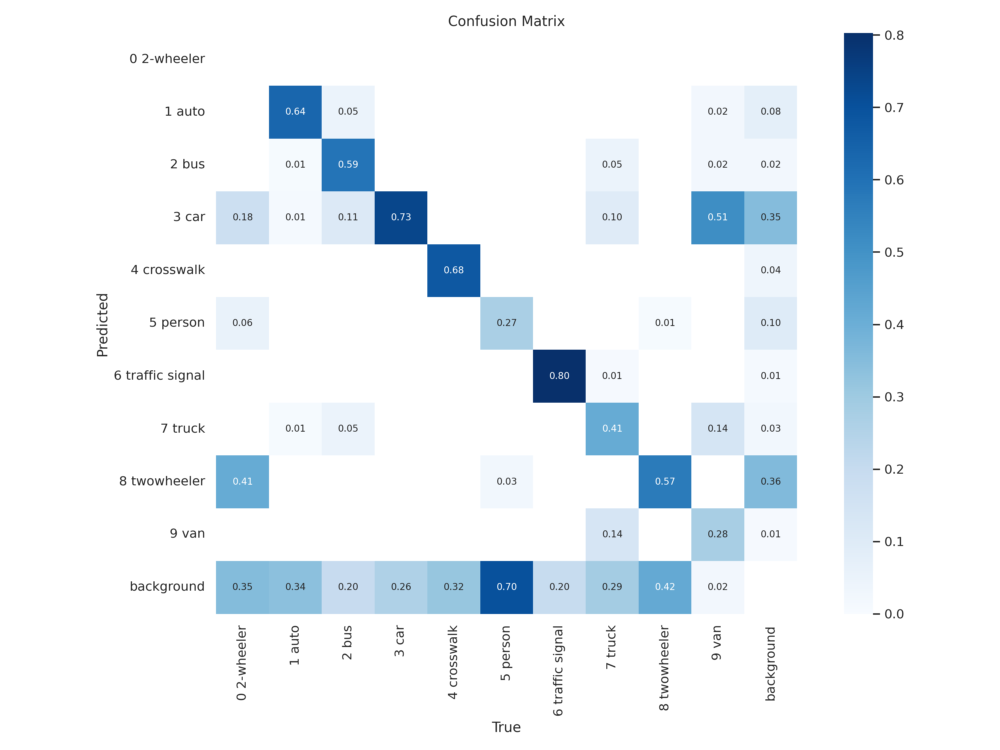

In [ ]:
# Show confussion matrix
Image(filename=f'{HOME}/runs/detect/train/confusion_matrix.png', width=600)

When an object is detected, it is usually categorised as the correct class (that's why the matrix is quite sparse). But it looks like the model struggles to detect objects (the last row of the matrix is quite large).

Let's look at the training losses.

In [1]:
# Show training losses
Image(filename=f'{HOME}/runs/detect/train/results.png', width=600)

NameError: name 'Image' is not defined

Clearly we need more epochs to train (box_loss and cls_loss are yet not flattened).

Lastly, let's take a look at some of the examples.

/content


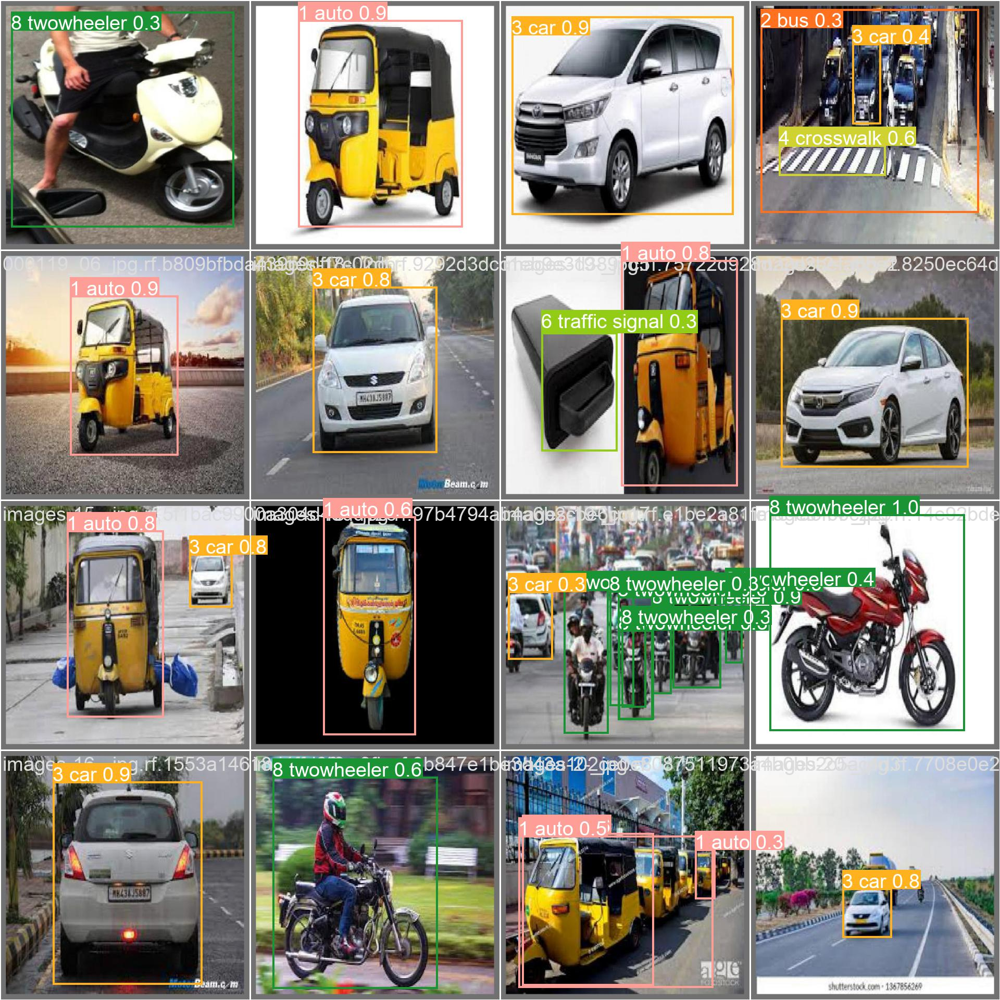

In [ ]:
# Change directory to home
%cd {HOME}

# Show examples
Image(filename=f'{HOME}/runs/detect/train/val_batch0_pred.jpg', width=600)

/content


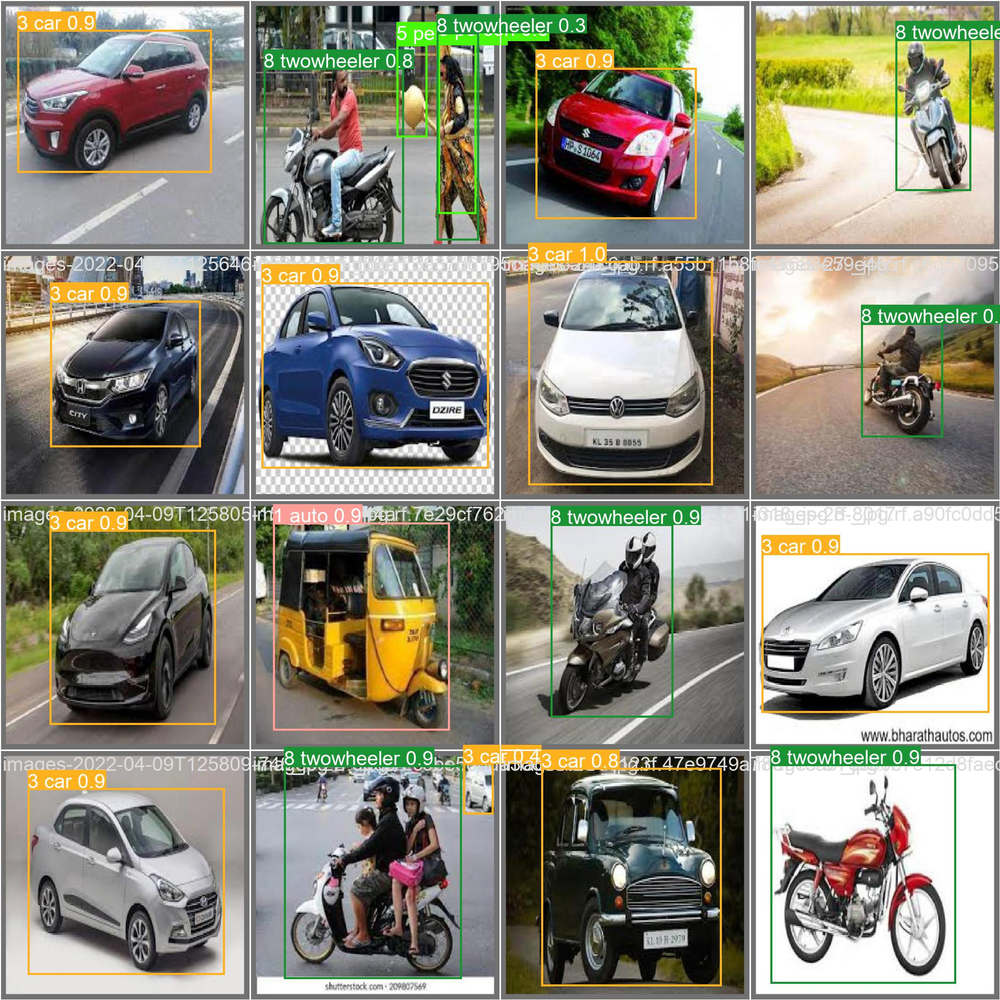

In [ ]:
# Change directory to home
%cd {HOME}

# Show examples
Image(filename=f'{HOME}/runs/detect/train/val_batch2_pred.jpg', width=600)

## 1.3.2 Second Model
Now, let's try to improve the previous model. The main changes will be:
- **More epochs**: as seen before, the model still hadn't stabilised when the training had finished (it was still learning), so more epochs will be used.
- **Learning rate decrease**: to 0.001, as more epochs will be used, this rate can be decreased.

In [ ]:
# Change directory
%cd {HOME}

# Train model
model.train(data="/content/datasets/Deep-Learning---Group-Assignment-1/data.yaml", epochs=25, lr0 = 0.001)

Ultralytics YOLOv8.0.47 🚀 Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)
yolo/engine/trainer: task=detect, mode=train, model=/content/runs/detect/train/weights/best.pt, data=/content/datasets/Deep-Learning---Group-Assignment-1/data.yaml, epochs=25, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=False, optimizer=SGD, verbose=True, seed=0, deterministic=True, single_cls=False, image_weights=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, min_memory=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, hide_labels=False, hide_conf=False, vid_stride=1, line_thickness=3, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, boxes=Tru

/content


Model summary: 225 layers, 3012798 parameters, 3012782 gradients, 8.2 GFLOPs

Transferred 70/355 items from pretrained weights
optimizer: SGD(lr=0.001) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias
train: Scanning /content/datasets/Deep-Learning---Group-Assignment-1/train/labels.cache... 9421 images, 0 backgrounds, 0 corrupt: 100%|██████████| 9421/9421 [00:00<?, ?it/s]
train: WARNING ⚠️ /content/datasets/Deep-Learning---Group-Assignment-1/train/images/1570811000938_jpg.rf.9fdc03b95a7c697acd55f71c61120fd0.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /content/datasets/Deep-Learning---Group-Assignment-1/train/images/1570811000938_jpg.rf.f2f6b1fb85c8e15bd96d879b0b8ecebe.jpg: 1 duplicate labels removed
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 4784, len(boxes) = 26494. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segme

Again, let's take a look at the confussion matrix.

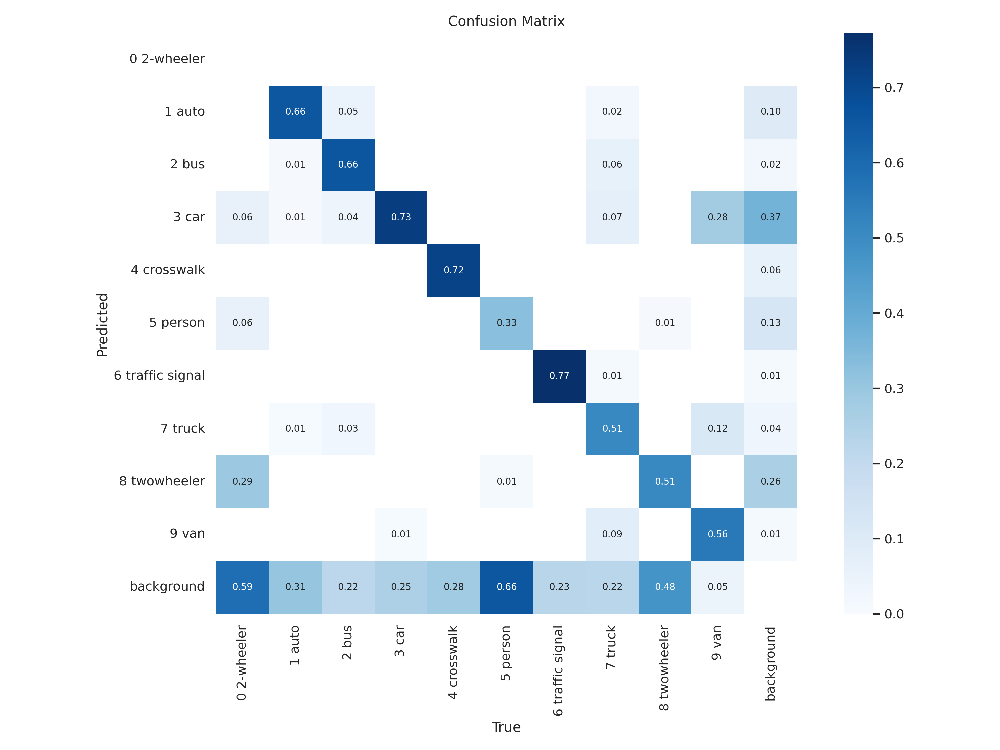

In [ ]:
# Show confussion matrix
Image(filename=f'{HOME}/runs/detect/train2/confusion_matrix.png', width=600)

It looks like the confussion matrix (and thus, the results) don't seem to be much better.

Let's take a look at the loss curves.

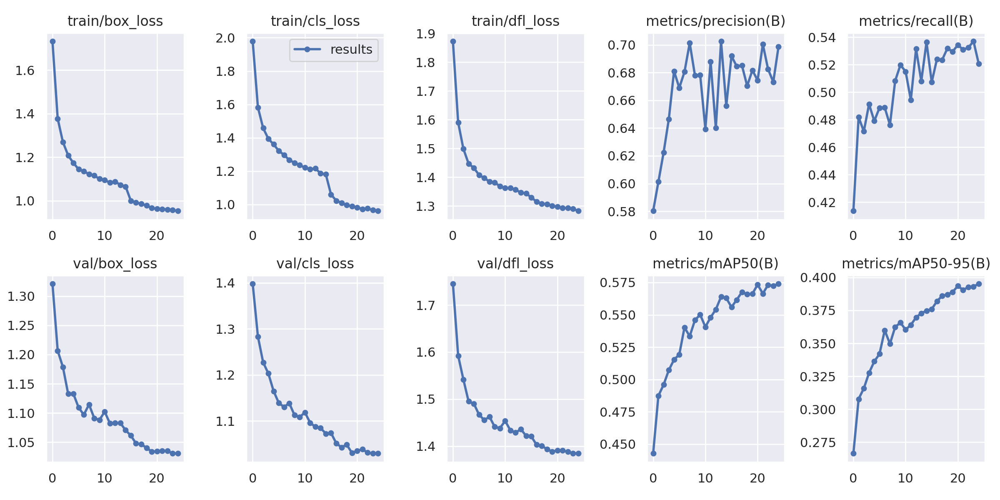

In [ ]:
# Show loss curves
Image(filename=f'{HOME}/runs/detect/train2/results.png', width=600)

This time it looks like these curves are much more stable, this is good news!

Finally, let's show some examples.

/content


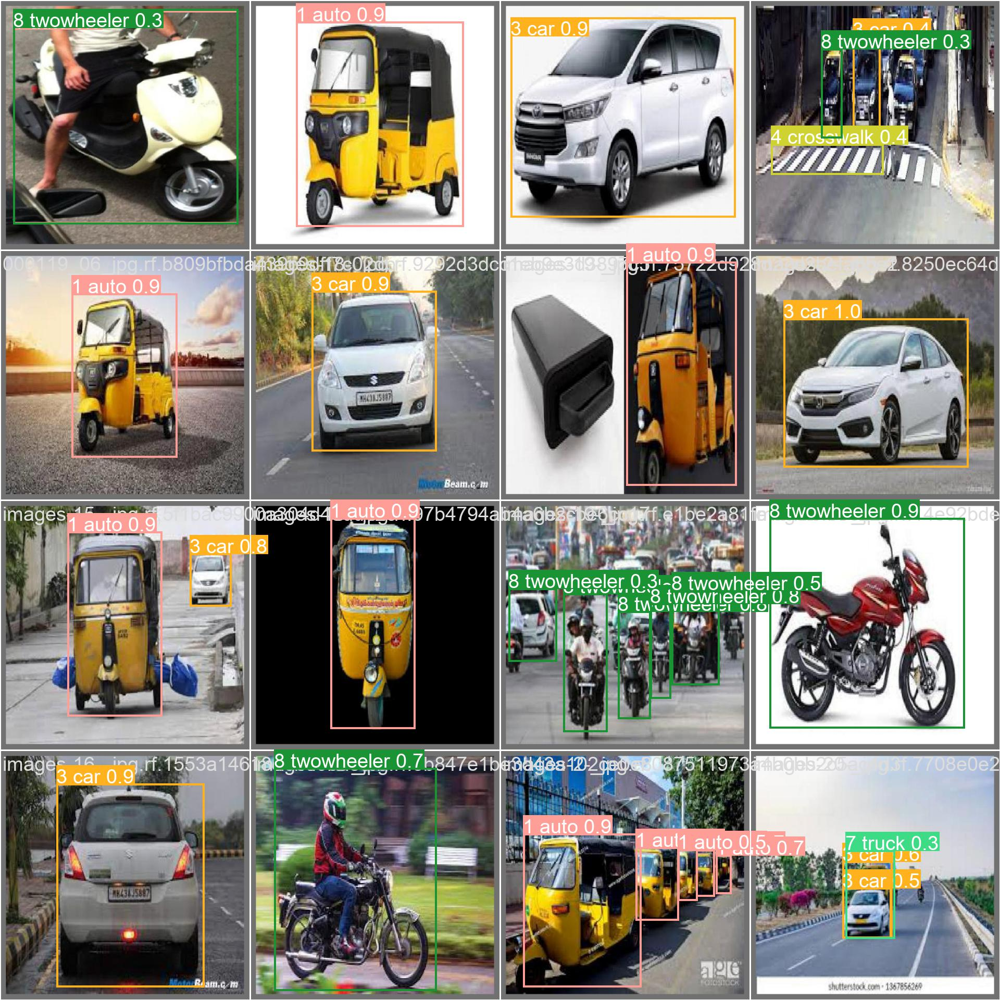

In [ ]:
# Change directory
%cd {HOME}

# Show images
Image(filename=f'{HOME}/runs/detect/train2/val_batch0_pred.jpg', width=600)

/content


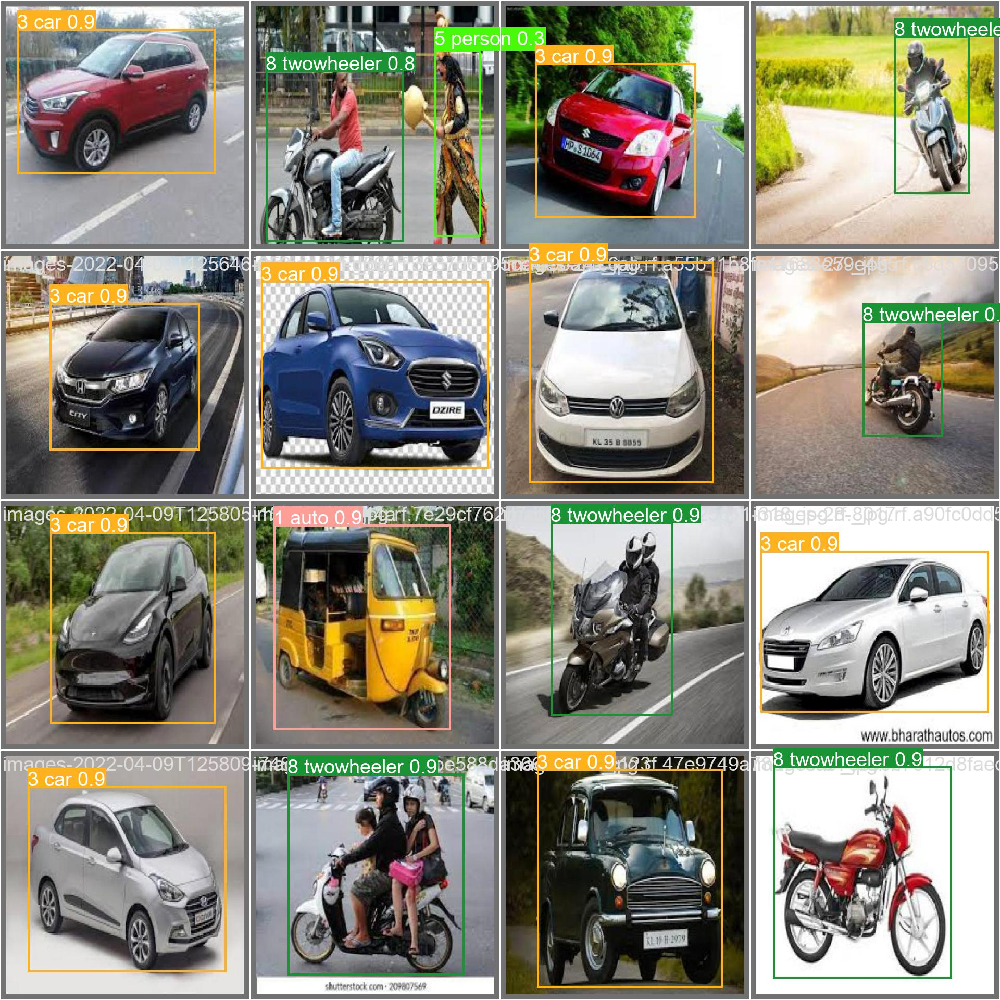

In [ ]:
# Change directory
%cd {HOME}

# Show images
Image(filename=f'{HOME}/runs/detect/train2/val_batch2_pred.jpg', width=600)

## 1.3.3 Third model
As the previous model did not improve in terms of accuracy (and confussion matrix), it was decided to do more pre-processing and augmentation steps done in RoboFlow. These are:

Pre-processing:
- **Grayscale**: in our detection task, we do not take any useful output from the colour, and the grayscale can help to reduce the complexity of the model, as it does not have a combination of green, blue and red for the convulational neural network. 
- **Tile**: used to capture smaller objects, than on any video it can appear (as the street is a continuous object that goes until the horizent usually and when that happens, the objects gets smaller).

Augmentation:
-  **Random Crop**: used to be able to capture the vehicles on more frames of the image (they do not always appear completed, this helps to capture)
- **Cutout**: we have some oclussion, as we have a lot of vehicles that overlap each other. To cutout parts of the image, is going to be helpful to avoid this problems.

Note that these steps are additionals to the previous one used.

In addition we run the model with more epochs, as the previous graph indicates there is still some space to improve, although this is minor when compared to the previous models.

In [ ]:
# Change to home directory
%cd {HOME}

# Get roboflow project
rf = Roboflow(api_key="pRKg4p771axFZRs2W6aQ")
project = rf.workspace("ie-ighjj").project("deep-learning-group-assignment-a38nh")

# Download dataset
dataset = project.version(2).download("yolov8")

/content
loading Roboflow workspace...
loading Roboflow project...
Dependency ultralytics<=8.0.20 is required but found version=8.0.47, to fix: `pip install ultralytics<=8.0.20`


Extracting Dataset Version Zip to Deep-Learning---Group-Assignment-2 in yolov8:: 100%|██████████| 66228/66228 [00:09<00:00, 7231.19it/s]


In [ ]:
# Import locale library
import locale

# Get correct encoding
def getpreferredencoding(do_setlocale = True):
    return "UTF-8"

# Apply to locale
locale.getpreferredencoding = getpreferredencoding

In [ ]:
# Moving the downloaded folder from Roboflow into the new created directory:
!mv "Deep-Learning---Group-Assignment-2" "datasets/"

In [ ]:
# Change directory to home
%cd {HOME}

# Train model
model.train(data="/content/datasets/Deep-Learning---Group-Assignment-2/data.yaml", epochs=35, lr0 = 0.001)

Ultralytics YOLOv8.0.47 🚀 Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)
yolo/engine/trainer: task=detect, mode=train, model=/content/runs/detect/train/weights/best.pt, data=/content/datasets/Deep-Learning---Group-Assignment-2/data.yaml, epochs=35, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=False, optimizer=SGD, verbose=True, seed=0, deterministic=True, single_cls=False, image_weights=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, min_memory=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, hide_labels=False, hide_conf=False, vid_stride=1, line_thickness=3, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, boxes=Tru

/content


Model summary: 225 layers, 3012798 parameters, 3012782 gradients, 8.2 GFLOPs

Transferred 355/355 items from pretrained weights
optimizer: SGD(lr=0.001) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias
train: Scanning /content/datasets/Deep-Learning---Group-Assignment-2/train/labels... 27264 images, 1594 backgrounds, 0 corrupt: 100%|██████████| 27264/27264 [00:16<00:00, 1622.04it/s]
train: WARNING ⚠️ /content/datasets/Deep-Learning---Group-Assignment-2/train/images/1570811000938_jpg.rf.1fac803c15ddedd5c3a8ca23b9e12040.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /content/datasets/Deep-Learning---Group-Assignment-2/train/images/1570811000938_jpg.rf.25d9ced291315615b69040a969d74466.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /content/datasets/Deep-Learning---Group-Assignment-2/train/images/1570811000938_jpg.rf.269f196982b88d716b96faafbf133e41.jpg: 1 duplicate labels removed
train: WARNING ⚠️ /content/datasets/Deep-Learning---Group-Assignment-2/train

Now, let's take a look at the confussion matrix.

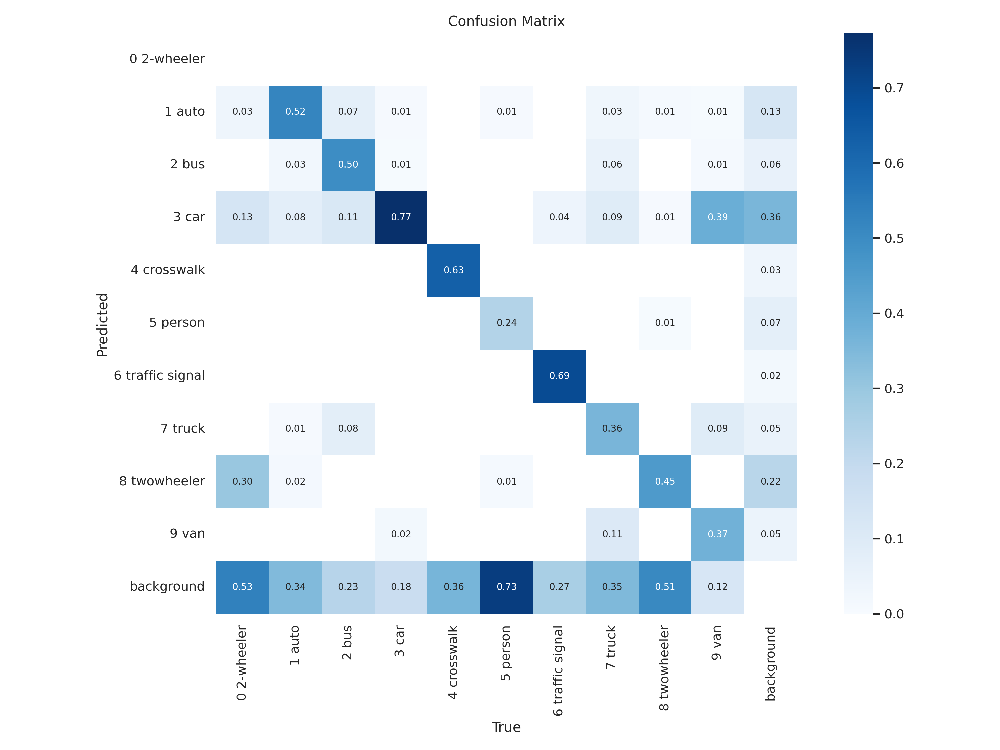

In [ ]:
# Show confussion matrix
Image(filename=f'{HOME}/runs/detect/train3/confusion_matrix.png', width=600)

Great! Now we can actually see an improvement in the confussion matrix. You can clearly see that the pre-processing of images has a strong effect on the performance of the model.

Let's take a look at the training losses.

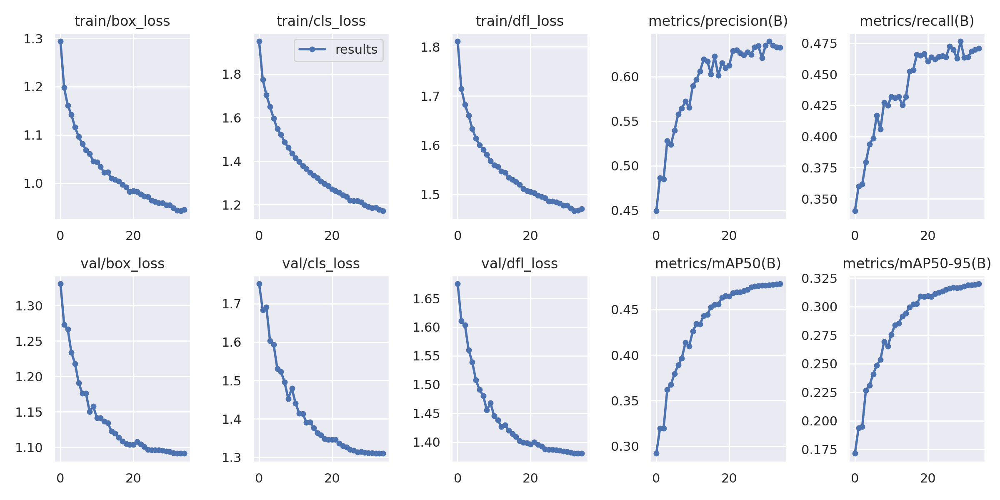

In [ ]:
# Show losses
Image(filename=f'{HOME}/runs/detect/train3/results.png', width=600)

Again, you can see that the losses are more or less flat at the end.

Now, let's look at some examples.

/content


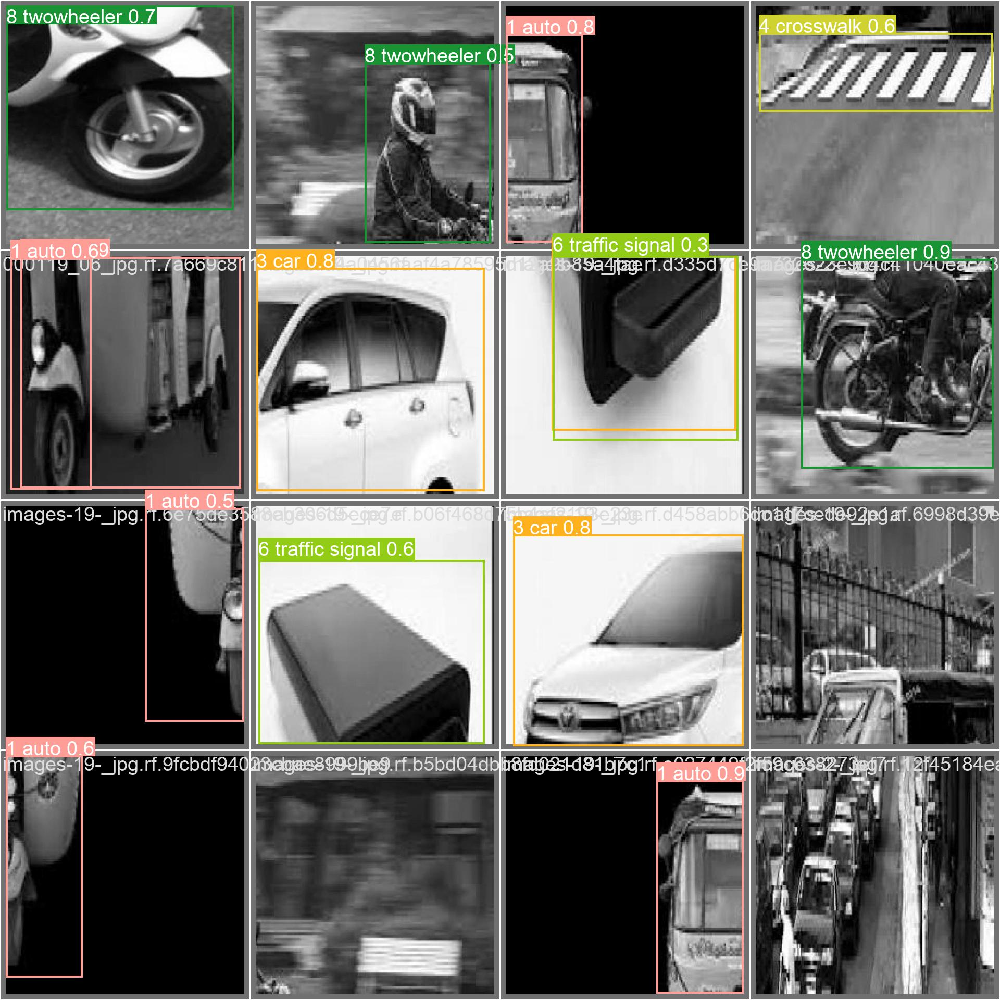

In [ ]:
# Change directory
%cd {HOME}

# Show images
Image(filename=f'{HOME}/runs/detect/train3/val_batch0_pred.jpg', width=600)

/content


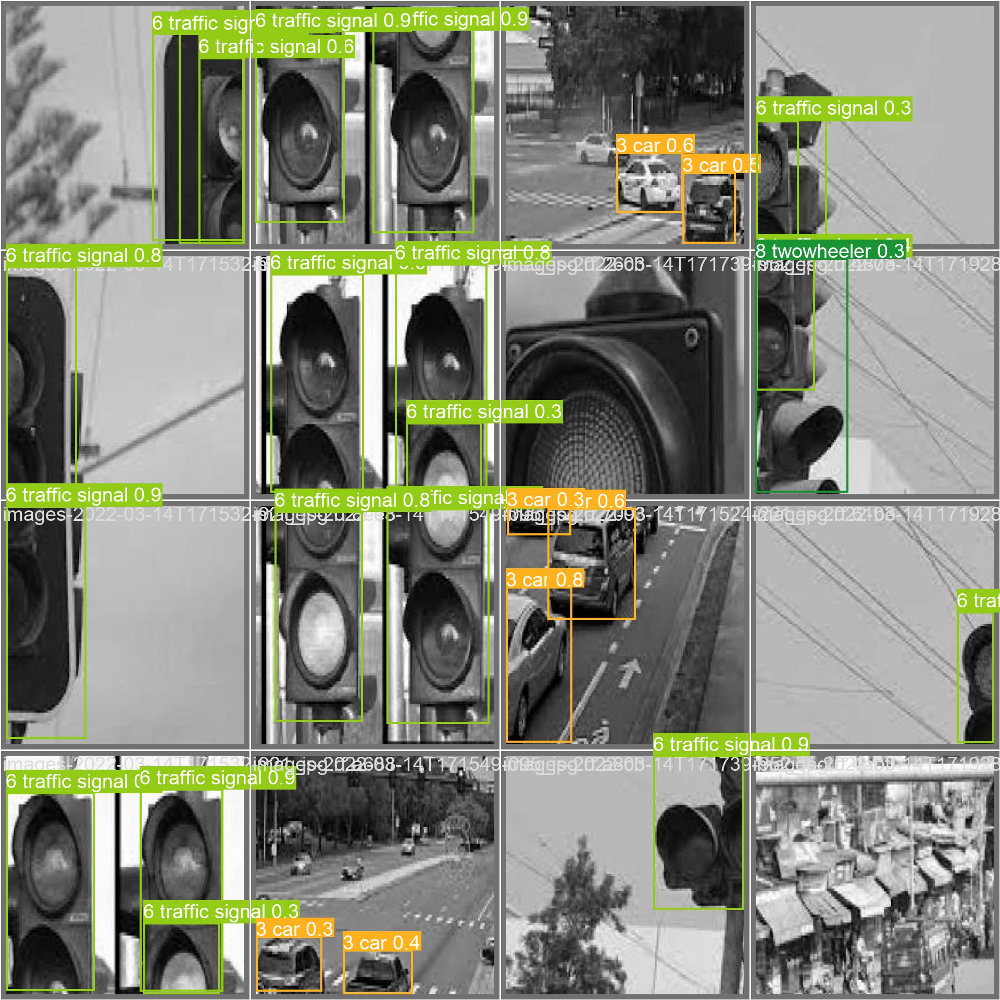

In [ ]:
# Change directory
%cd {HOME}

# Show images
Image(filename=f'{HOME}/runs/detect/train3/val_batch2_pred.jpg', width=600)

## 1.3.4 Fourth model
Lastly, on the fourth model, we will introduce two changes:
- **Lower learning rate**: 0.0001
- **Less epochs to speed up training**: this has more to do with technical limitations and the limited use of GPU on Google Colab.

In [9]:
# Change home directory
%cd {HOME}

# State model
model = YOLO("yolov8n.pt")

# Train model
model.train(data="/content/datasets/Deep-Learning---Group-Assignment-2/data.yaml", epochs=30, lr0 = 0.0001)

/content


  0%|          | 0.00/6.23M [00:00<?, ?B/s]

Ultralytics YOLOv8.0.47 🚀 Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)
yolo/engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/datasets/Deep-Learning---Group-Assignment-2/data.yaml, epochs=30, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=False, optimizer=SGD, verbose=True, seed=0, deterministic=True, single_cls=False, image_weights=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, min_memory=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, hide_labels=False, hide_conf=False, vid_stride=1, line_thickness=3, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, boxes=True, format=torchscript, keras=Fal

  0%|          | 0.00/755k [00:00<?, ?B/s]

Overriding model.yaml nc=80 with nc=10

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.Conv                  [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.Conv                  [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.C2f                   [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.Conv                  [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.C2f                   [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.Conv                  [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.C2f                   [128, 128, 2, True]           
  7                  -1  1    295424  ultralytic

Again, now let's take a look at the confussion matrix

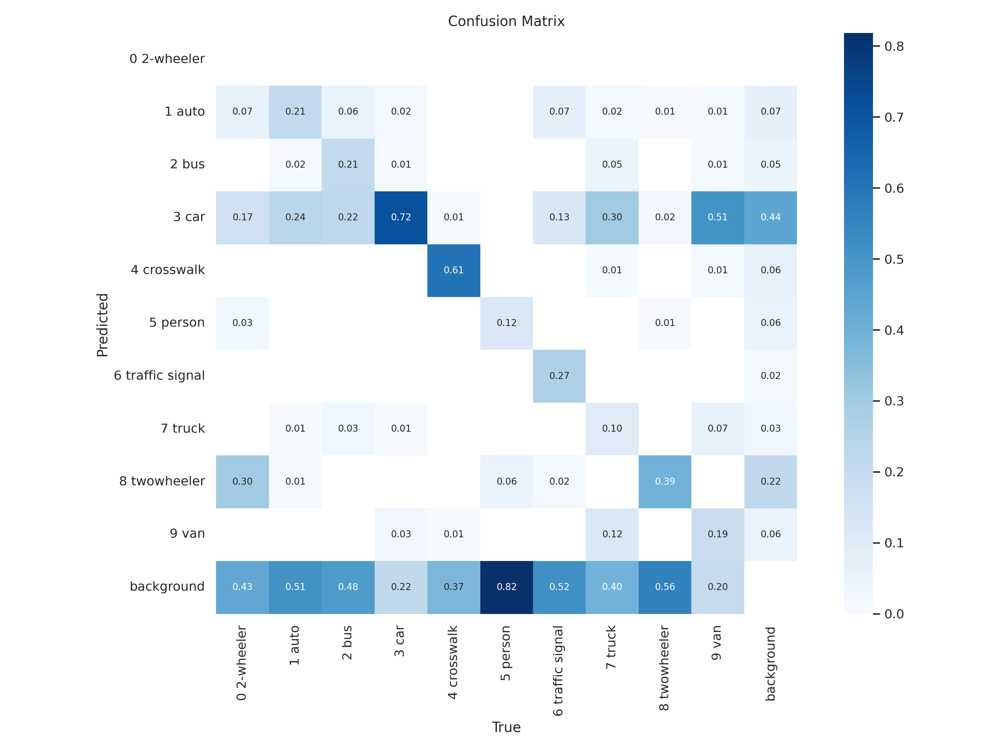

In [15]:
# Confusion matrix
Image(filename=f'{HOME}/runs/detect/train/confusion_matrix.png', width=600)

And the training losses

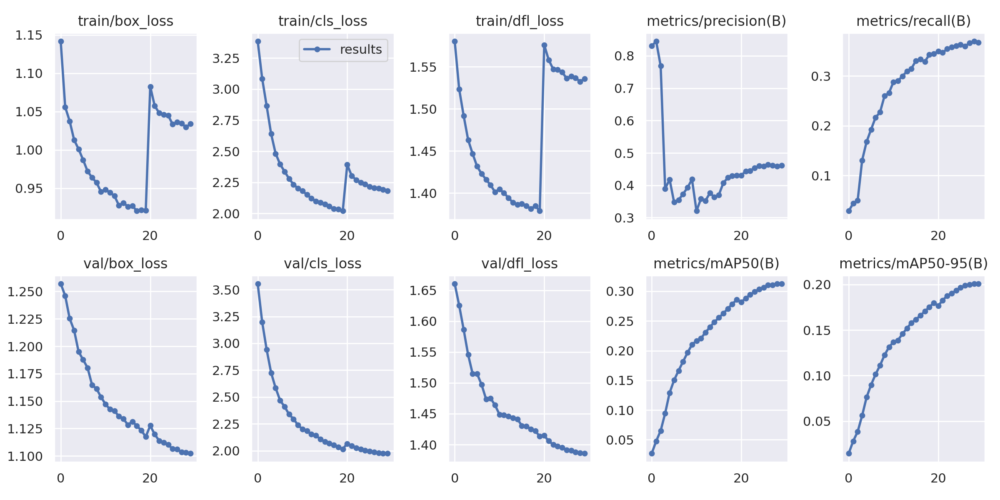

In [16]:
Image(filename=f'{HOME}/runs/detect/train/results.png', width=600)

It's interesting to see that some of the losses still would need some more epochs, but the general performance has improved.

Now let's take a look at some images.

/content


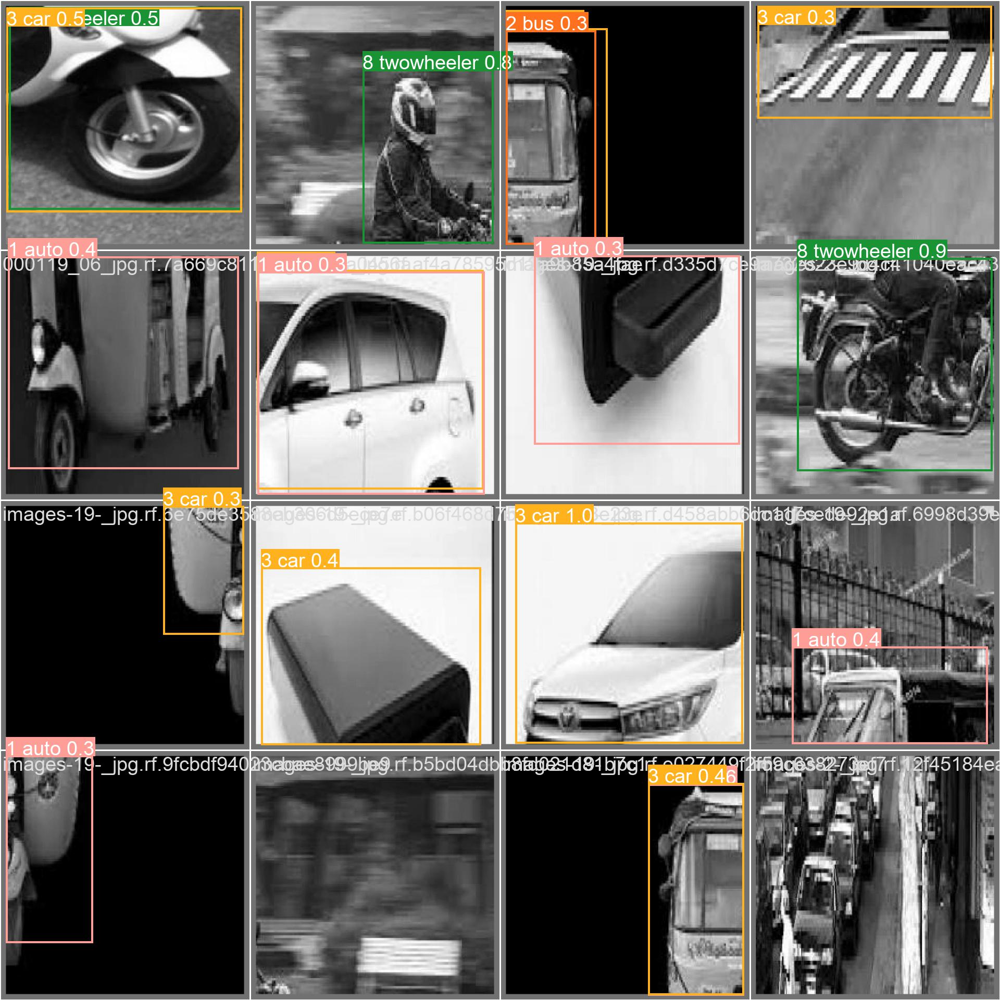

In [17]:
# Change home directory
%cd {HOME}

# Display images
Image(filename=f'{HOME}/runs/detect/train/val_batch0_pred.jpg', width=600)

/content


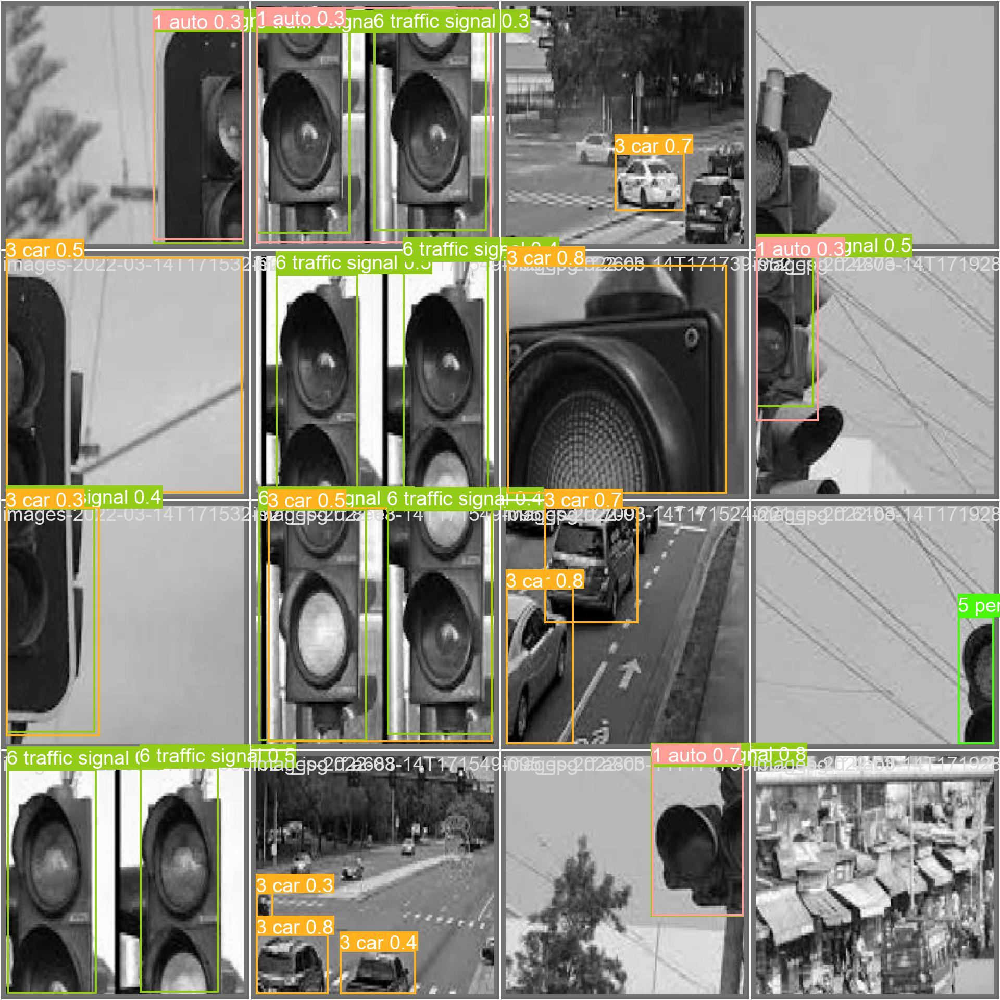

In [19]:
%cd {HOME}
Image(filename=f'{HOME}/runs/detect/train/val_batch2_pred.jpg', width=600)

## 1.3.5 Fifth model
The performance increase has been minimal in the previous two iterations. For this reason, it was decided to take the large dataset (the one used in the previous model) and apply it to a more advanced Yolov8 version.

The largest changes are:
- Range for the learning rate: 0.01 - 0.0001
- Momentum: 0.8
- Less epochs to fast up training.
- A better version of Yolov8 (altought it takes more to train).

In [13]:
# Change directory
%cd {HOME}

# Get new yolo model
model = YOLO("yolov8s.pt")

# Train model
model.train(data="/content/datasets/Deep-Learning---Group-Assignment-2/data.yaml", epochs=30, lr0= 0.01 ,lrf = 0.0001, momentum = 0.8)

/content


  0%|          | 0.00/21.5M [00:00<?, ?B/s]

Ultralytics YOLOv8.0.47 🚀 Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)
yolo/engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/content/datasets/Deep-Learning---Group-Assignment-2/data.yaml, epochs=30, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=None, exist_ok=False, pretrained=False, optimizer=SGD, verbose=True, seed=0, deterministic=True, single_cls=False, image_weights=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, min_memory=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, hide_labels=False, hide_conf=False, vid_stride=1, line_thickness=3, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, boxes=True, format=torchscript, keras=Fal

Now that the model is trained, let's take a look at the confussion matrix

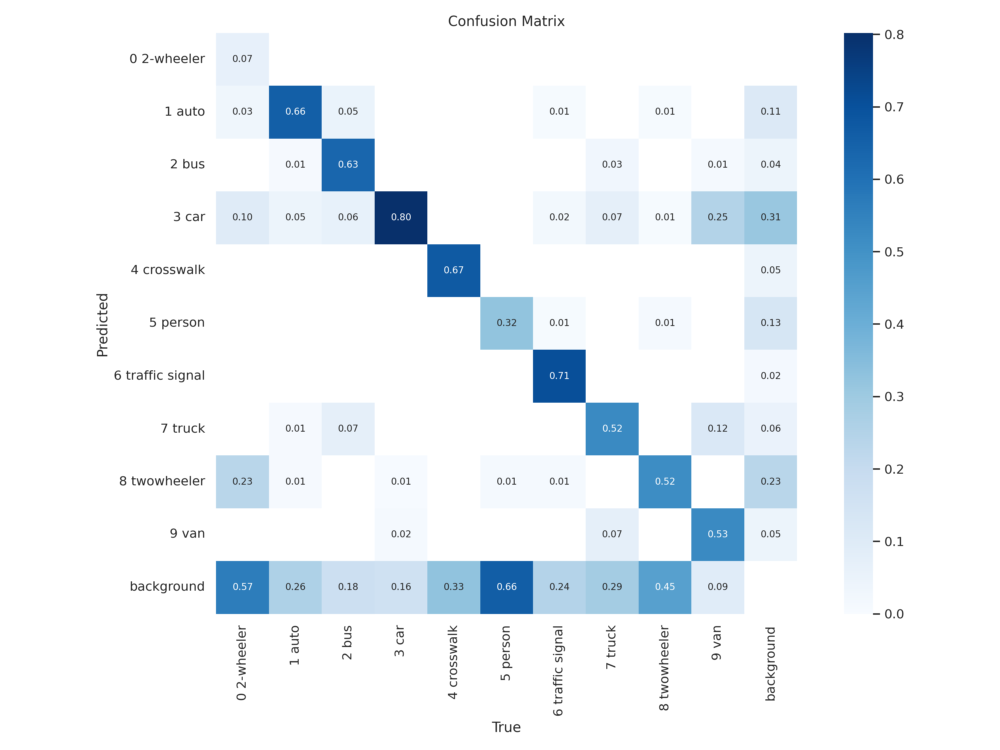

In [20]:
# Show confusion matrix
Image(filename=f'{HOME}/runs/detect/train2/confusion_matrix.png', width=600)

The increase in performance is now more noteworthy. Let's take a look at the training loss

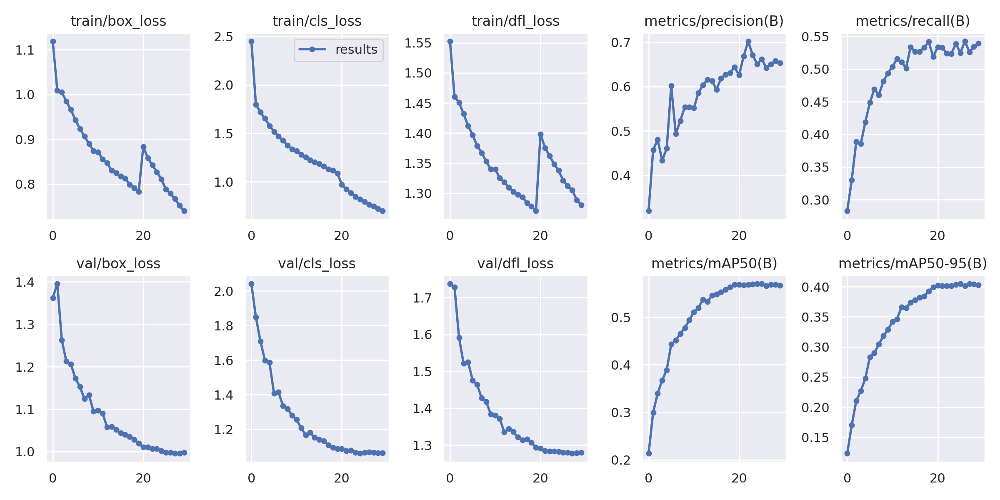

In [21]:
# Show loss curves
Image(filename=f'{HOME}/runs/detect/train2/results.png', width=600)

The loss curves show that some more epochs might be beneficial to the model. Still, this is limited by the computing power.

Let's look at some example images.

/content


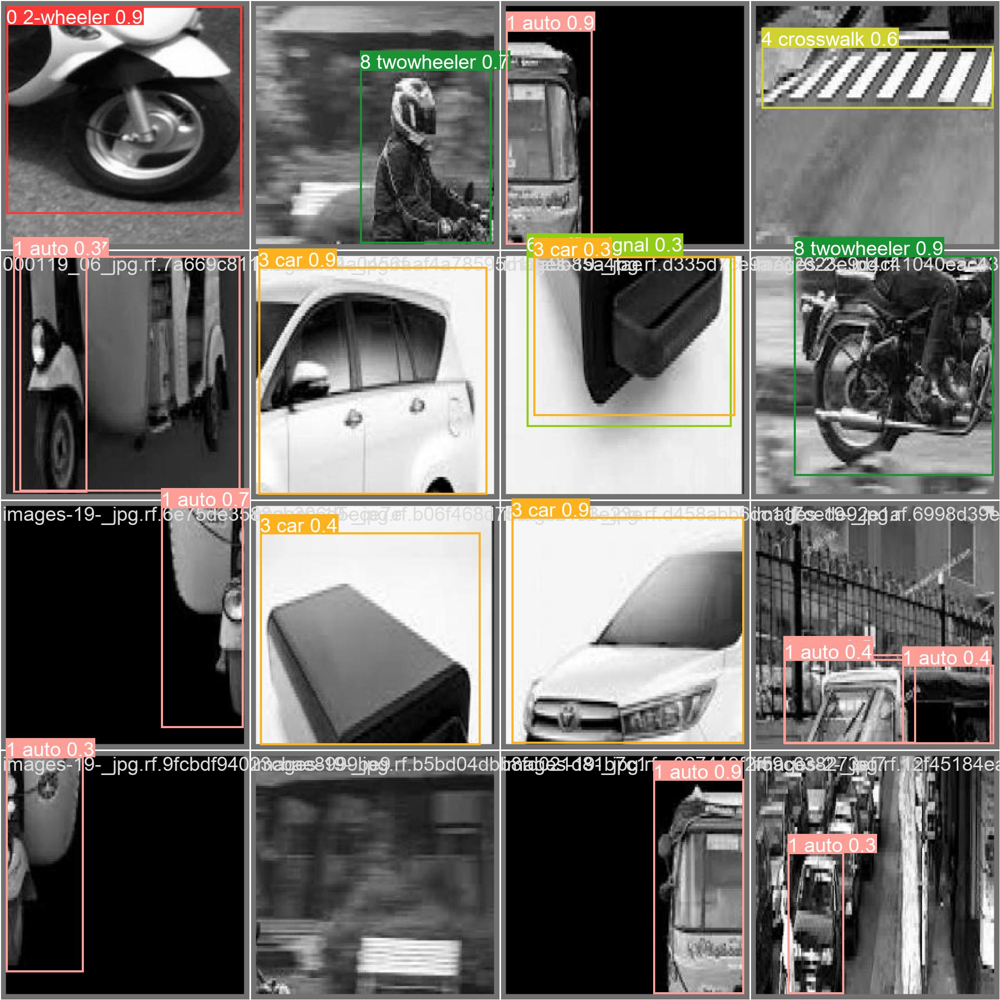

In [22]:
# Change directory
%cd {HOME}

# Display images
Image(filename=f'{HOME}/runs/detect/train2/val_batch0_pred.jpg', width=600)

/content


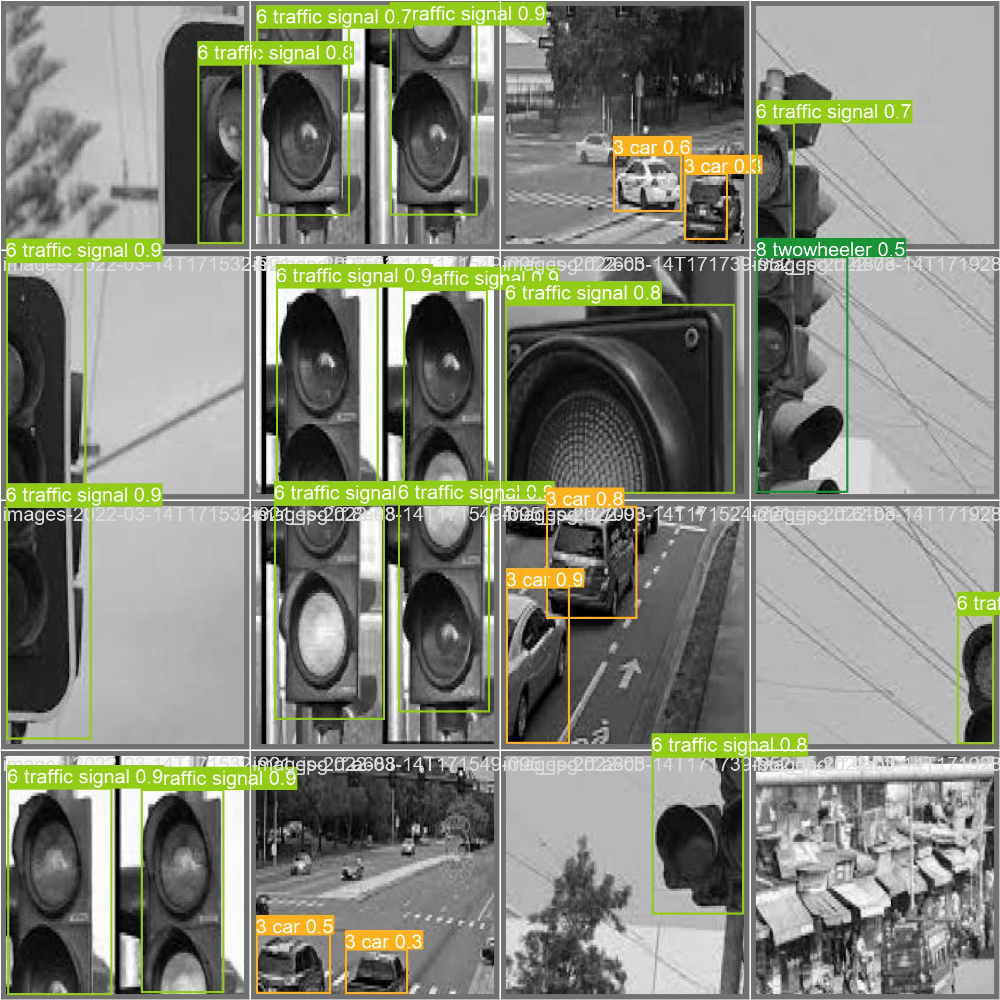

In [23]:
# Change directory
%cd {HOME}

# Display images
Image(filename=f'{HOME}/runs/detect/train2/val_batch2_pred.jpg', width=600)

# 1.4 Prediction on validation
On this step, we will run predictions on the validation dataset.

## 1.4.1 First Model
Let's run the predictions

In [ ]:
# Get model
model = YOLO("/content/runs/detect/train/weights/best.pt")

# Run validation
results_val_1 = model.val(source='/content/datasets/Deep-Learning---Group-Assignment-1/valid/images', conf=0.25, save=True, save_txt=True, save_conf=True)

Ultralytics YOLOv8.0.47 🚀 Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3007598 parameters, 0 gradients, 8.1 GFLOPs
val: Scanning /content/datasets/Deep-Learning---Group-Assignment-1/valid/labels.cache... 974 images, 0 backgrounds, 0 corrupt: 100%|██████████| 974/974 [00:00<?, ?it/s]
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 596, len(boxes) = 2767. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 61/61 [00:12<00:00,  5.07it/s]
                   all        974       2767      0.586      0.494      0.557      0.396
           0 2-wheeler        974         17          0          0          0          0
                1 auto        974        277        0.7      0.599      0.68

Now let's take a look at the confusion matrix.

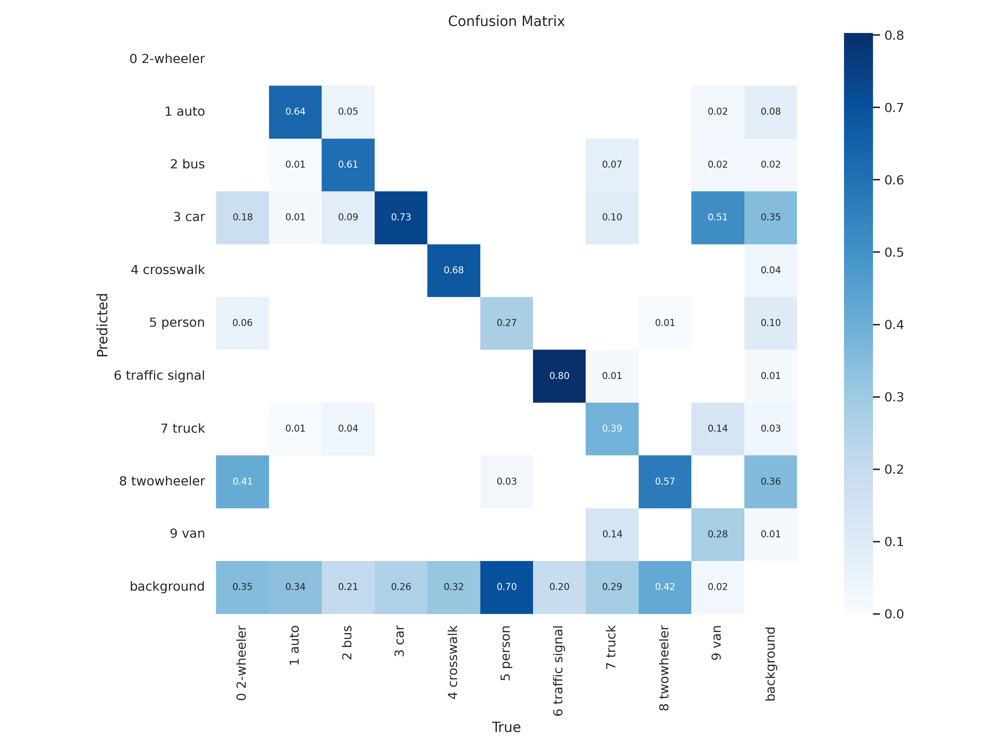

In [ ]:
# Display confusion matrix
Image(filename=f'/content/runs/detect/val/confusion_matrix.png', width=600)

Lastly, let's take a look at some of the performance curves

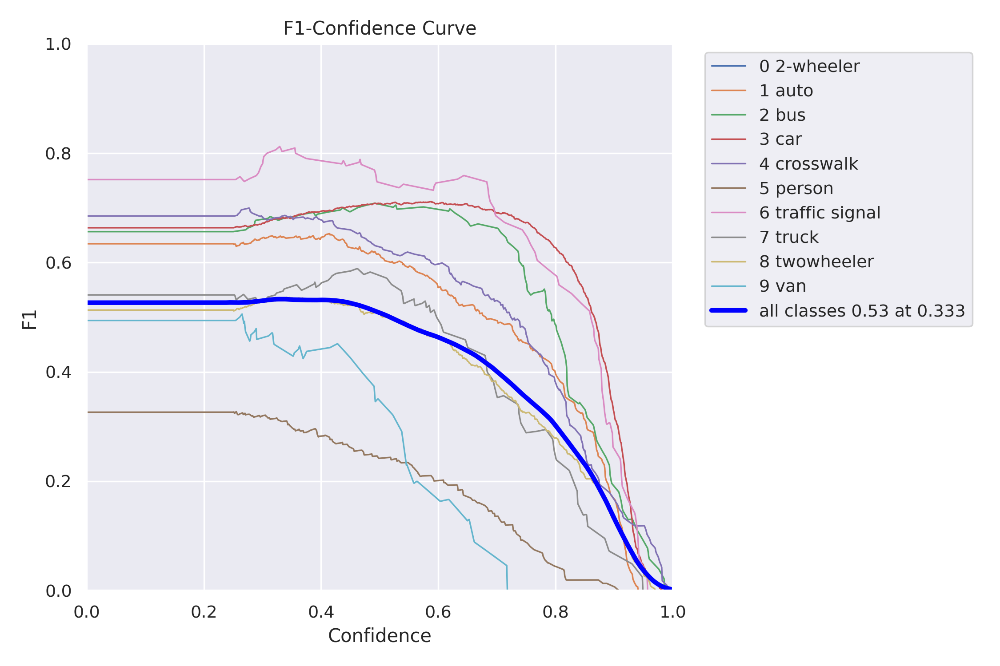

In [ ]:
Image(filename=f'/content/runs/detect/val/F1_curve.png', width=600)

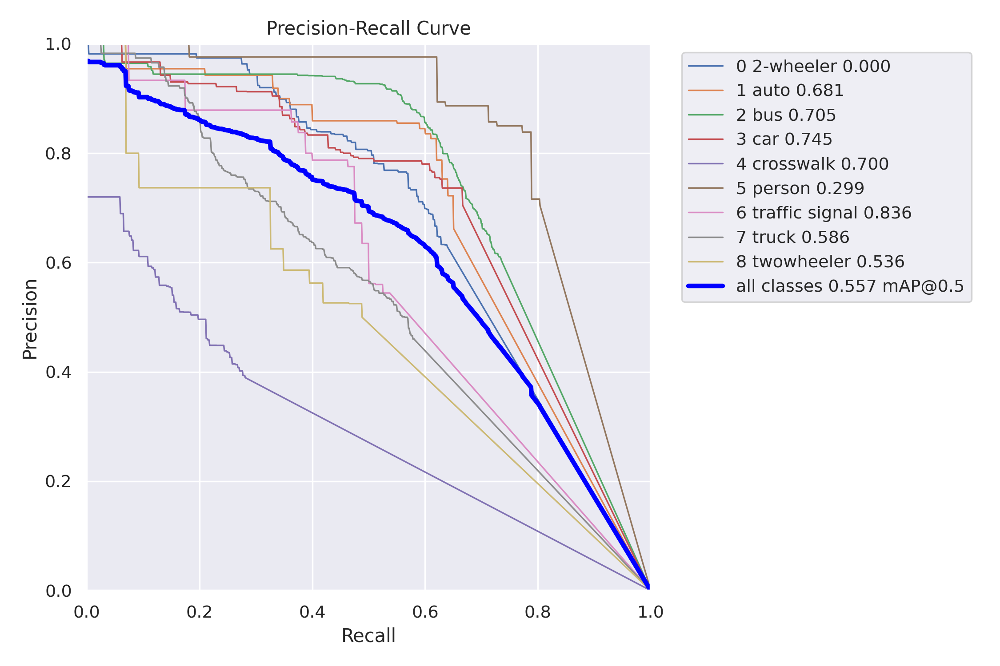

In [ ]:
Image(filename=f'/content/runs/detect/val/PR_curve.png', width=600)

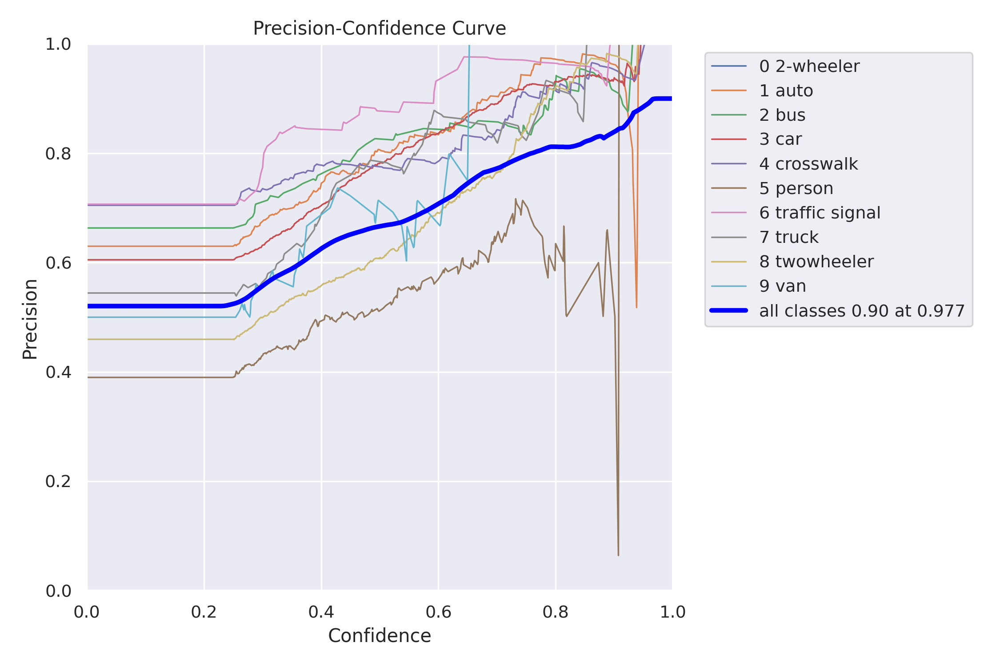

In [ ]:
Image(filename=f'/content/runs/detect/val/P_curve.png', width=600)

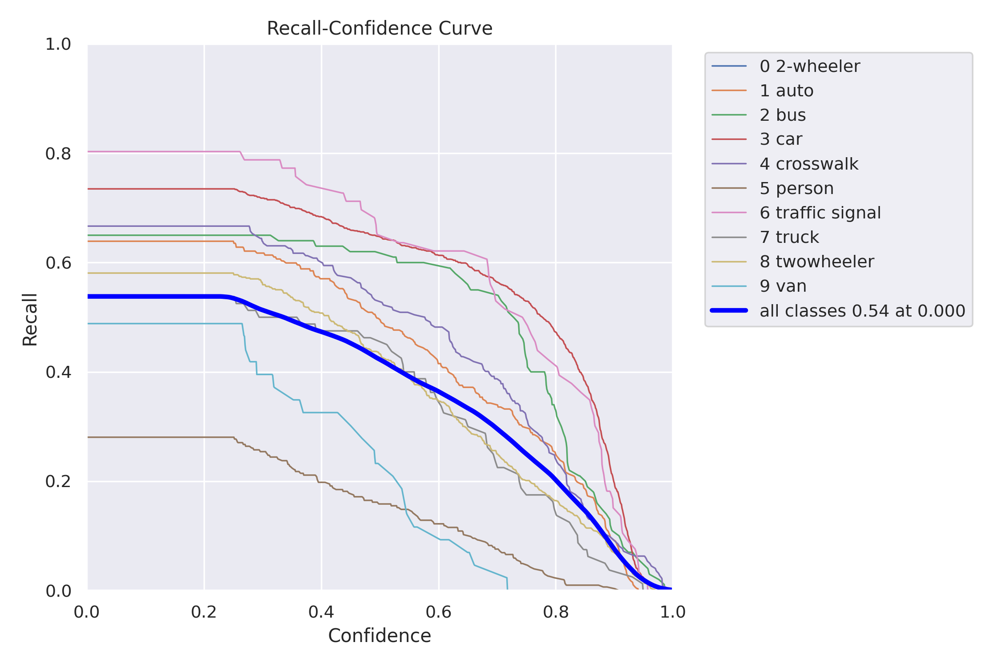

In [ ]:
Image(filename=f'/content/runs/detect/val/R_curve.png', width=600)

And now, let's take a look at some predictions

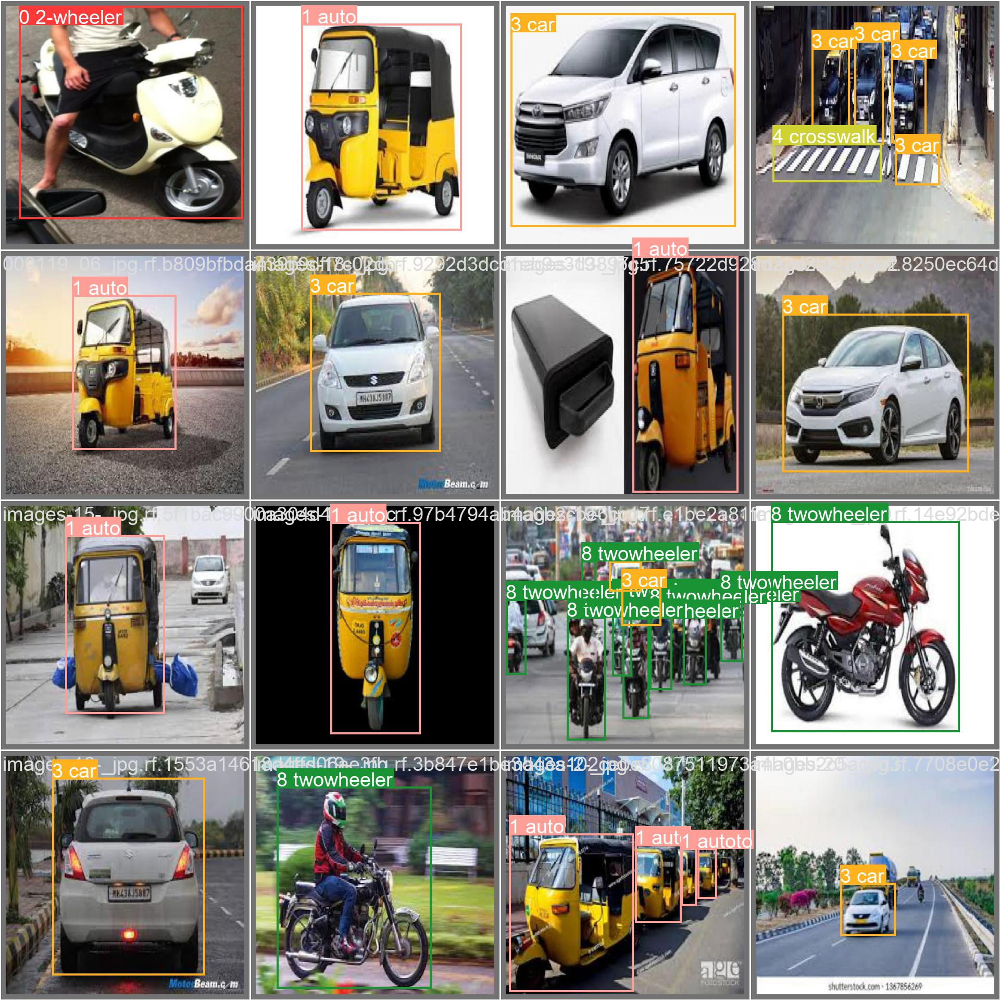

In [ ]:
# Display images
Image(filename=f'/content/runs/detect/val/val_batch0_labels.jpg', width=600)

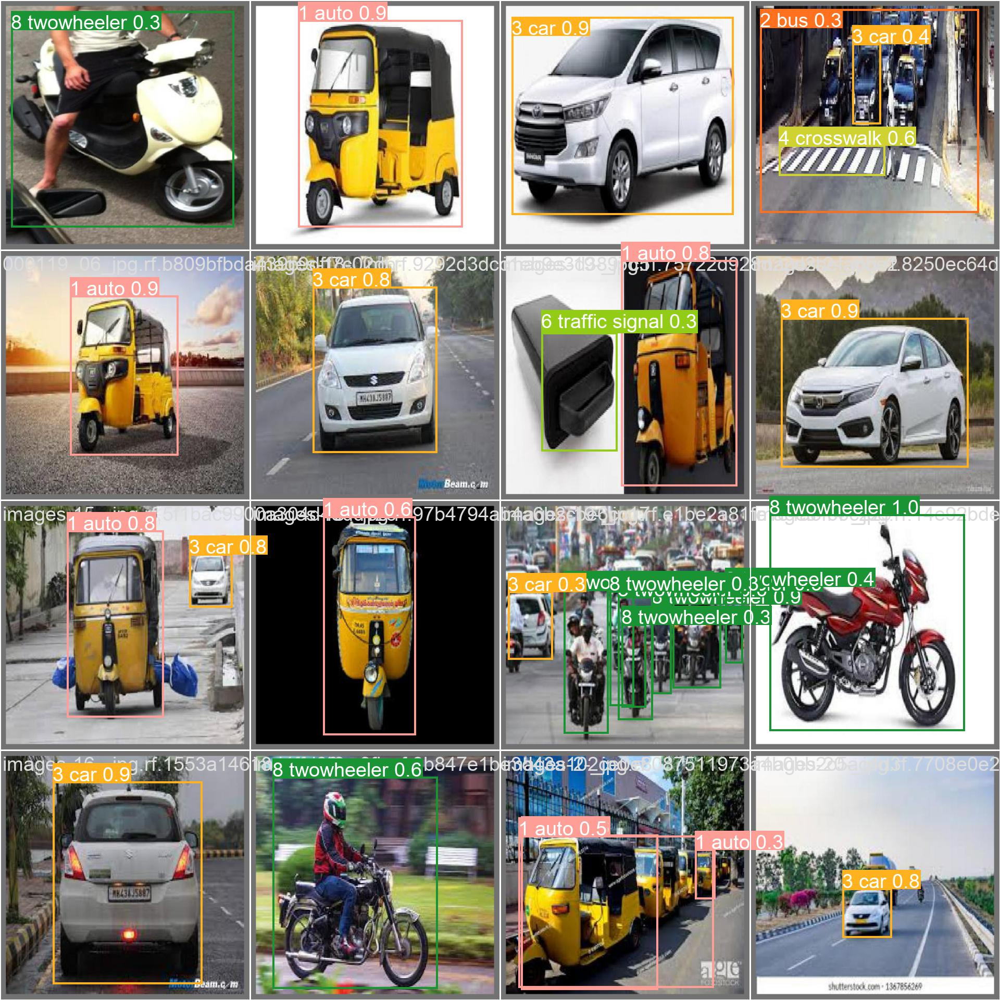

In [ ]:
# Display images
Image(filename=f'/content/runs/detect/val/val_batch0_pred.jpg', width=600)

## 1.4.2 Second Model
Let's run the same process for the second model

In [ ]:
# Get model
model = YOLO("/content/runs/detect/train2/weights/best.pt")

# Run validation
results_val_1 = model.val(source='/content/datasets/Deep-Learning---Group-Assignment-1/valid/images', conf=0.25, save=True, save_txt=True, save_conf=True)

Ultralytics YOLOv8.0.47 🚀 Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3007598 parameters, 0 gradients, 8.1 GFLOPs
val: Scanning /content/datasets/Deep-Learning---Group-Assignment-1/valid/labels.cache... 974 images, 0 backgrounds, 0 corrupt: 100%|██████████| 974/974 [00:00<?, ?it/s]
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 596, len(boxes) = 2767. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 61/61 [00:12<00:00,  4.86it/s]
                   all        974       2767      0.697      0.521      0.583      0.431
           0 2-wheeler        974         17          1          0          0          0
                1 auto        974        277      0.704      0.644       0.7

Now let's get the confusion matrix

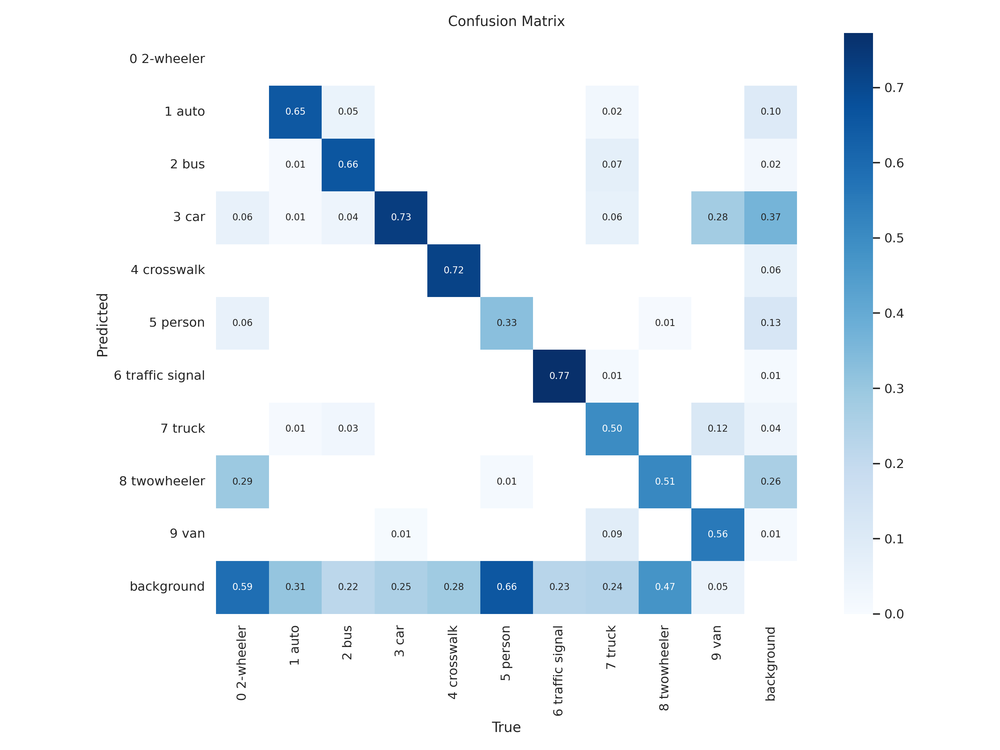

In [ ]:
# Show confusion matrix
Image(filename=f'/content/runs/detect/val2/confusion_matrix.png', width=600)

And now let's see the performance curves

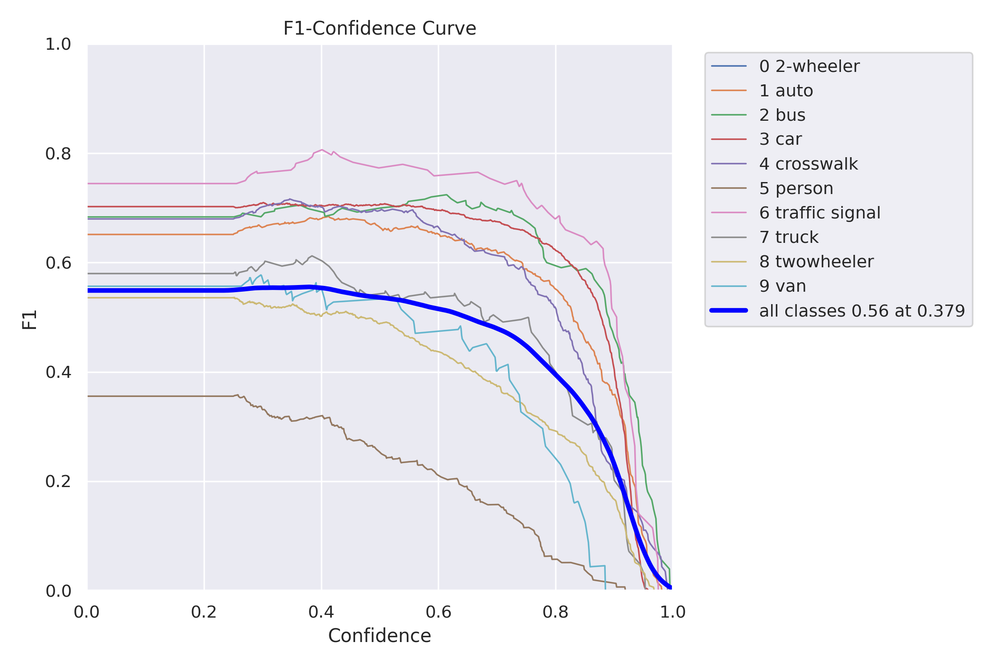

In [ ]:
Image(filename=f'/content/runs/detect/val2/F1_curve.png', width=600)

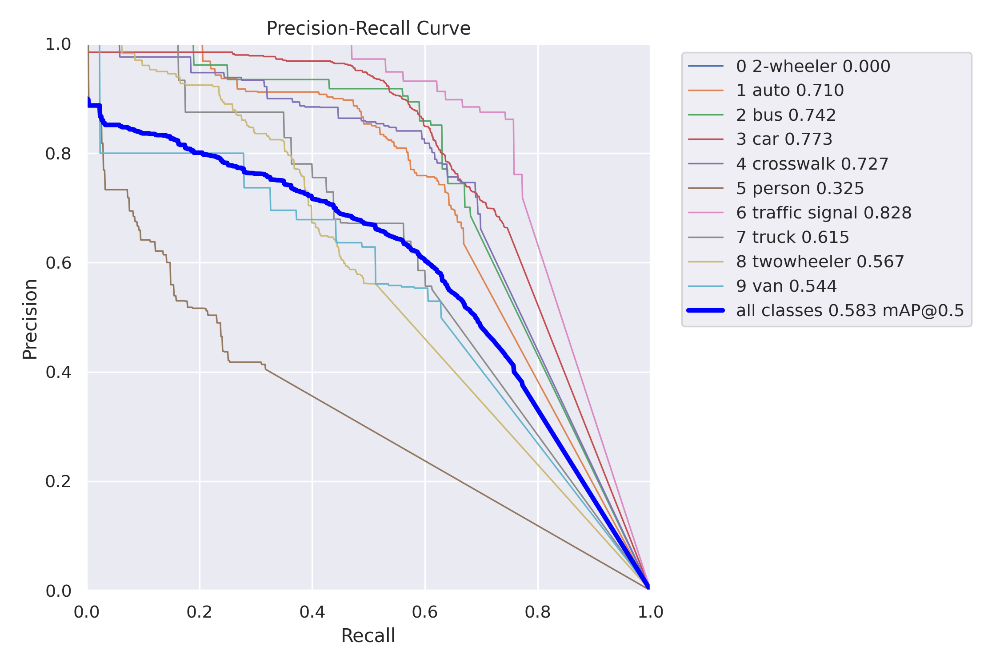

In [ ]:
Image(filename=f'/content/runs/detect/val2/PR_curve.png', width=600)

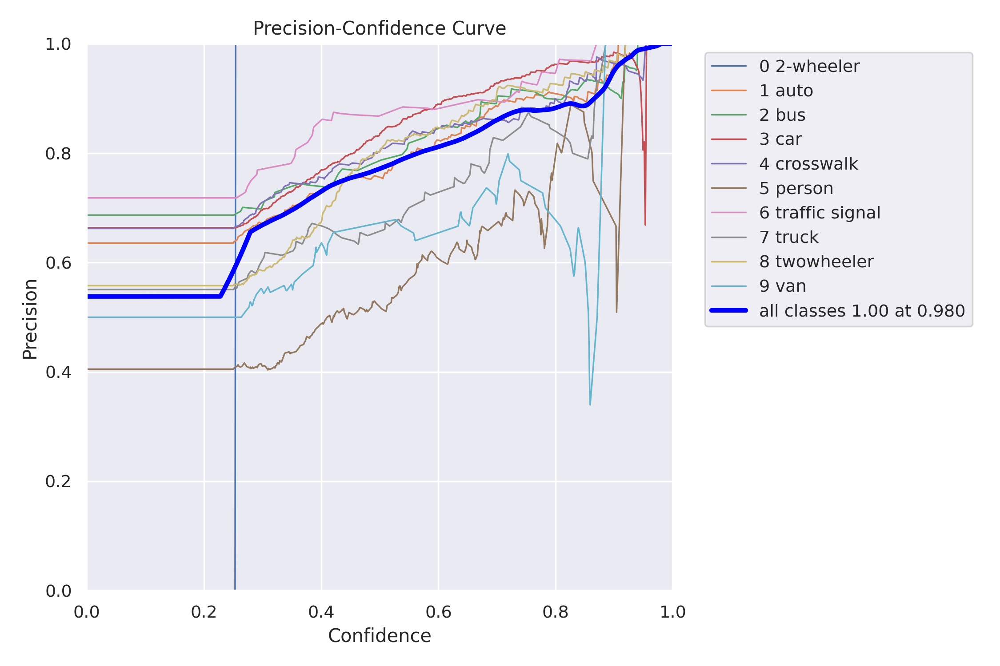

In [ ]:
Image(filename=f'/content/runs/detect/val2/P_curve.png', width=600)

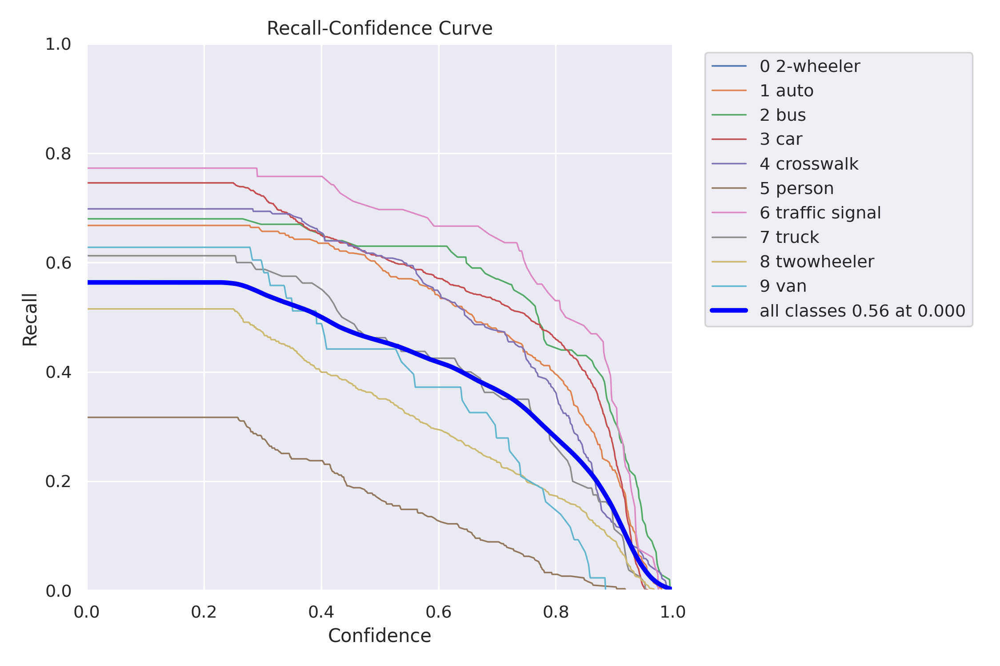

In [ ]:
Image(filename=f'/content/runs/detect/val2/R_curve.png', width=600)

Finally, let's see some examples

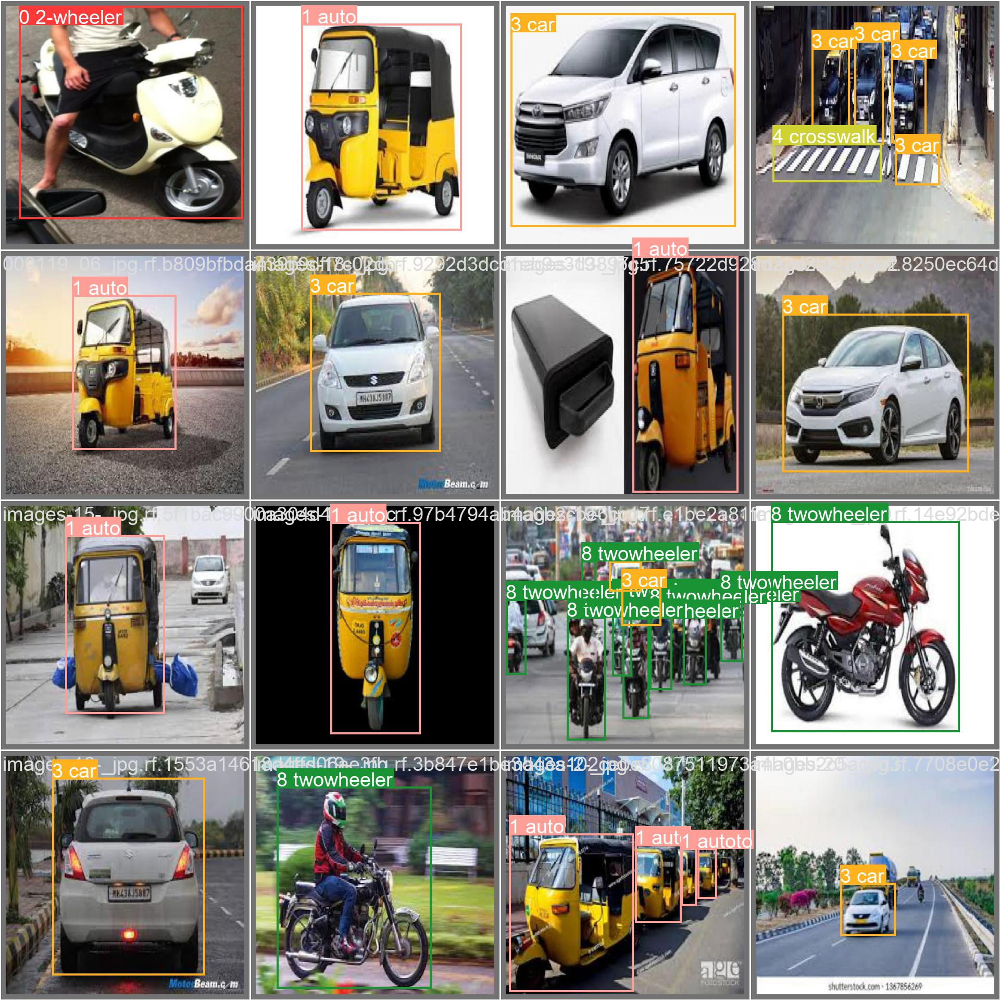

In [ ]:
Image(filename=f'/content/runs/detect/val2/val_batch0_labels.jpg', width=600)

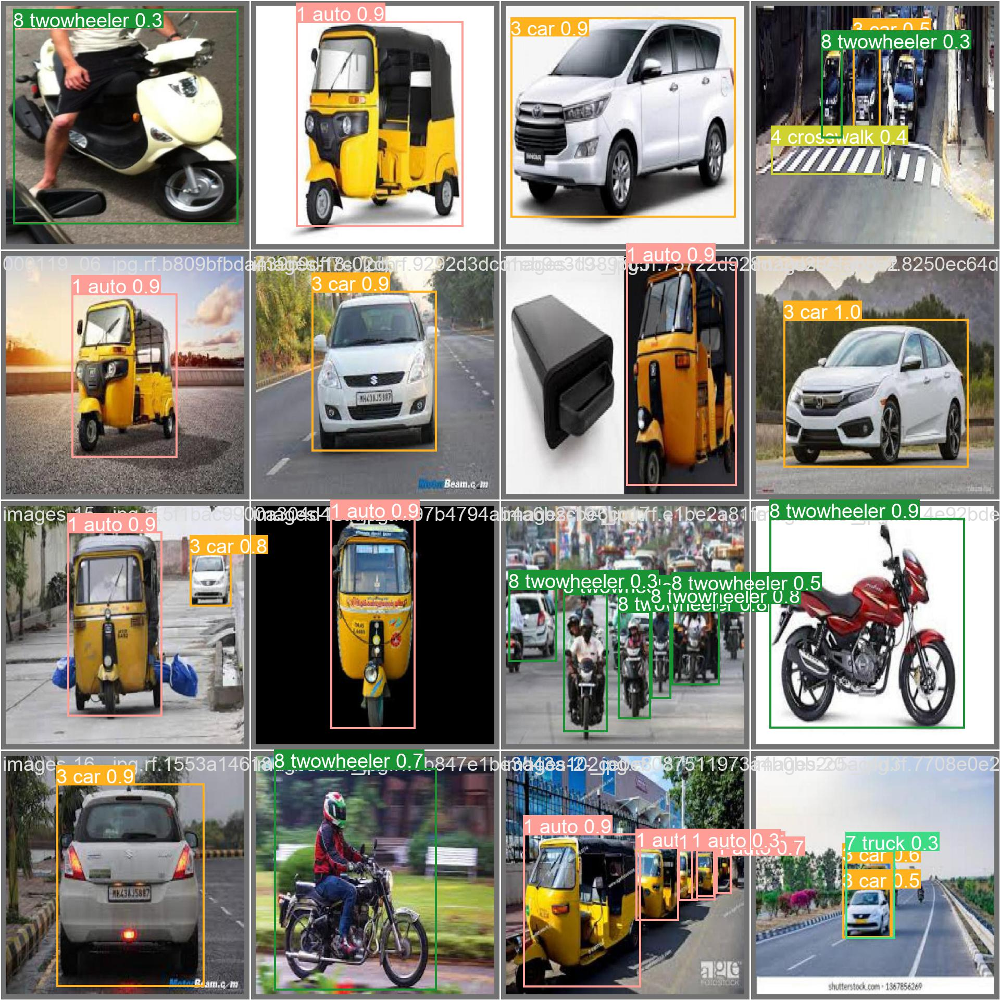

In [ ]:
Image(filename=f'/content/runs/detect/val2/val_batch0_pred.jpg', width=600)

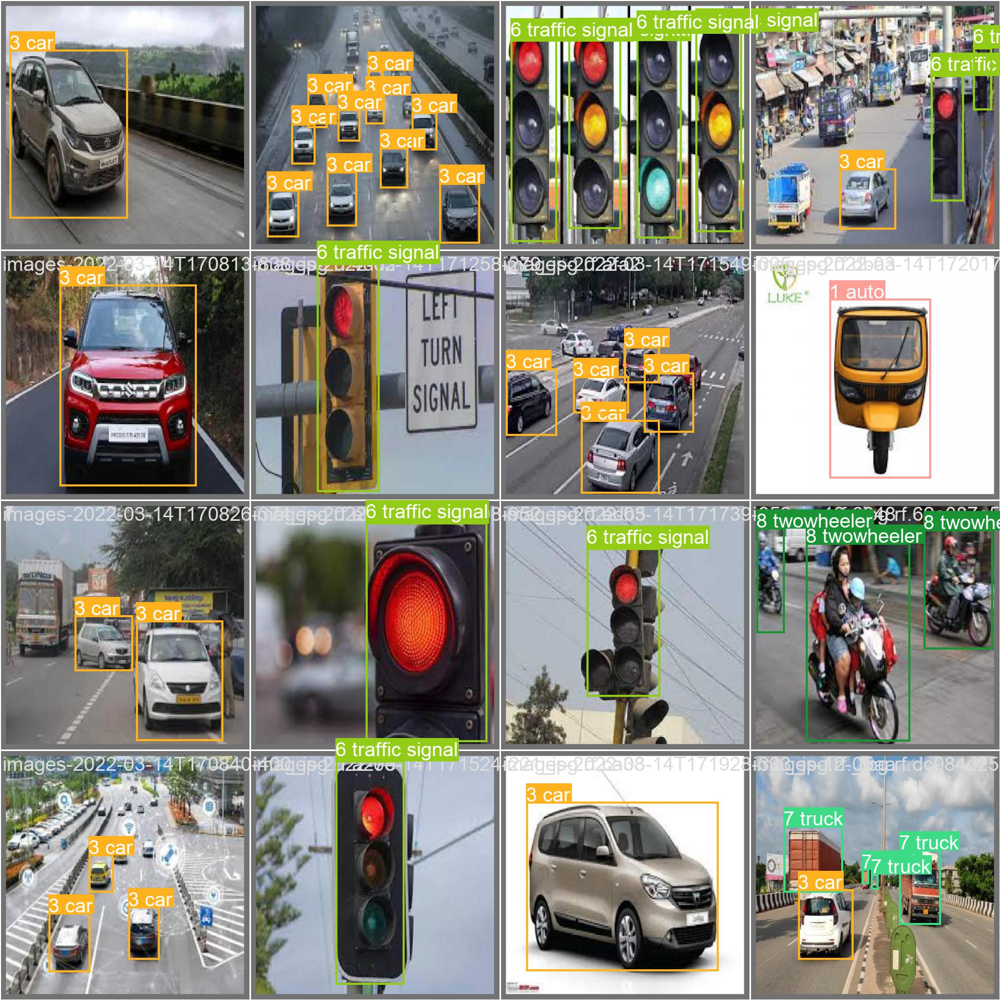

In [ ]:
Image(filename=f'/content/runs/detect/val2/val_batch1_labels.jpg', width=600)

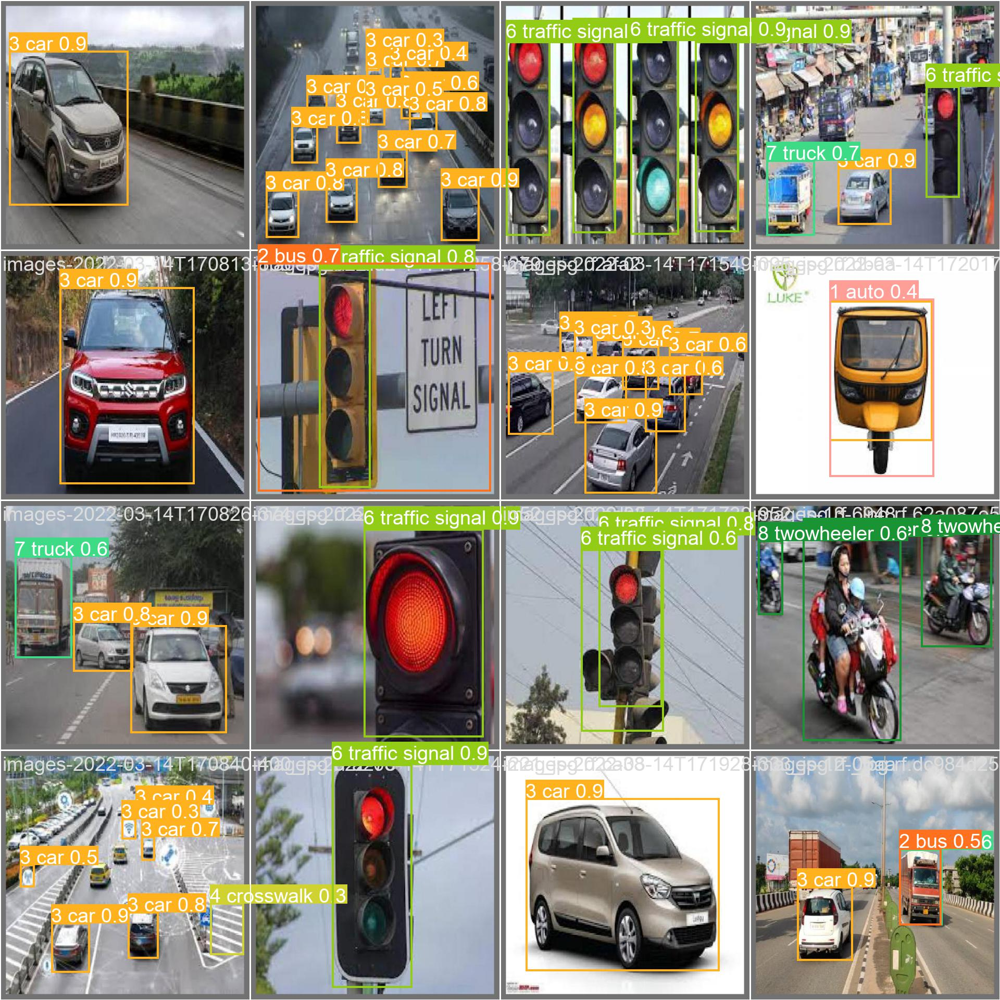

In [ ]:
Image(filename=f'/content/runs/detect/val2/val_batch1_pred.jpg', width=600)

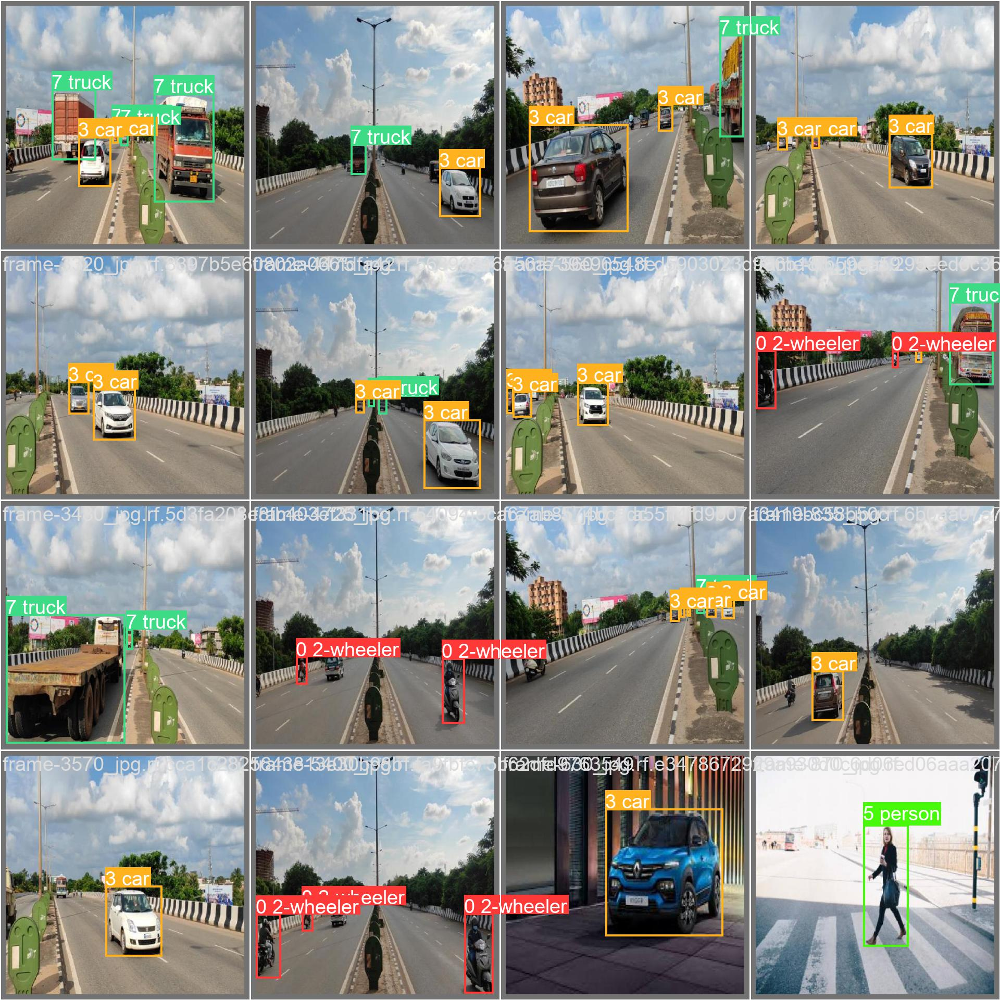

In [ ]:
Image(filename=f'/content/runs/detect/val2/val_batch2_labels.jpg', width=600)

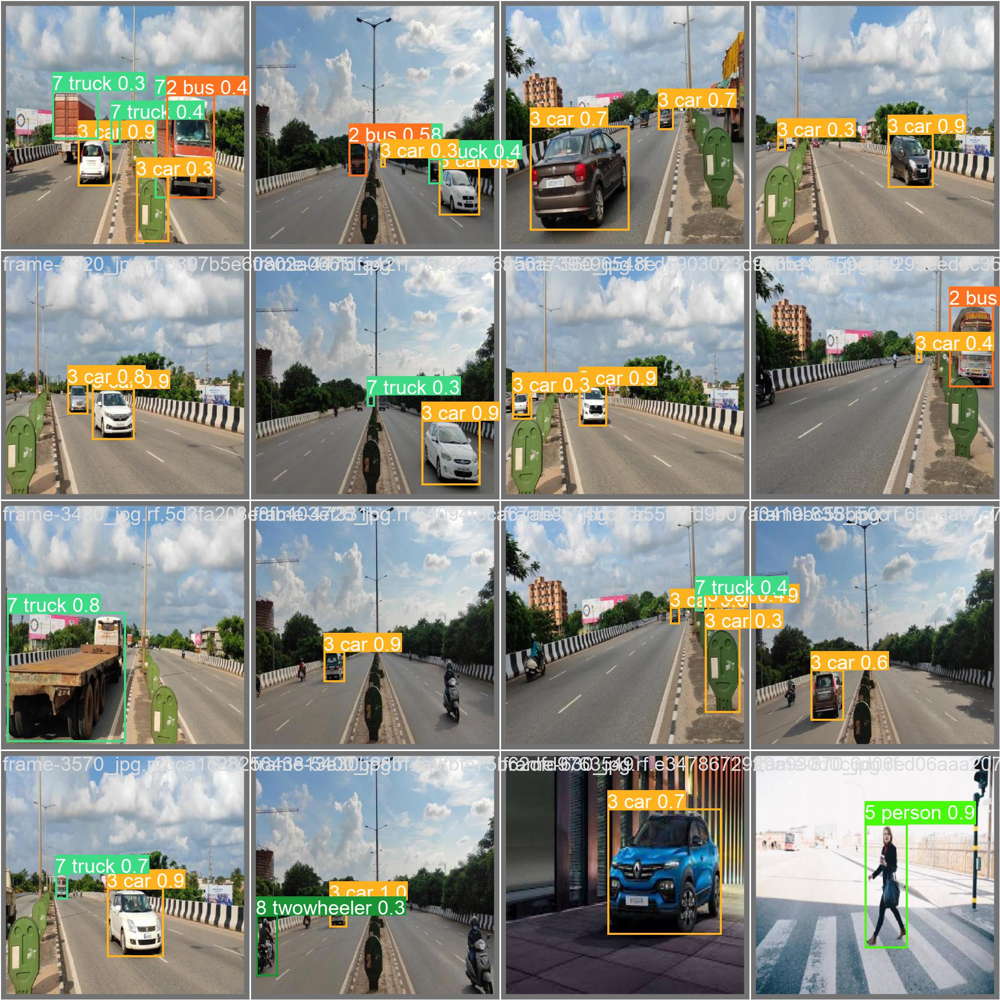

In [ ]:
Image(filename=f'/content/runs/detect/val2/val_batch2_pred.jpg', width=600)

## 1.4.3 Third Model
The same process will be run for the third model

In [ ]:
model = YOLO("/content/runs/detect/train3/weights/best.pt")
results_val_1 = model.val(source='/content/datasets/Deep-Learning---Group-Assignment-2/valid/images', conf=0.25, save=True, save_txt=True, save_conf=True)

Ultralytics YOLOv8.0.47 🚀 Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3007598 parameters, 0 gradients, 8.1 GFLOPs
val: Scanning /content/datasets/Deep-Learning---Group-Assignment-2/valid/labels.cache... 3896 images, 227 backgrounds, 0 corrupt: 100%|██████████| 3896/3896 [00:00<?, ?it/s]
val: WARNING ⚠️ /content/datasets/Deep-Learning---Group-Assignment-2/valid/images/c3_p1_82_jpg.rf.19a0b0fb05304dd14b75a8d39d277c01.jpg: 1 duplicate labels removed
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 626, len(boxes) = 6028. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 244/244 [00:36<00:00,  6.66it/s]
                   all       3896       6028      0.532       0.47      0.509      0

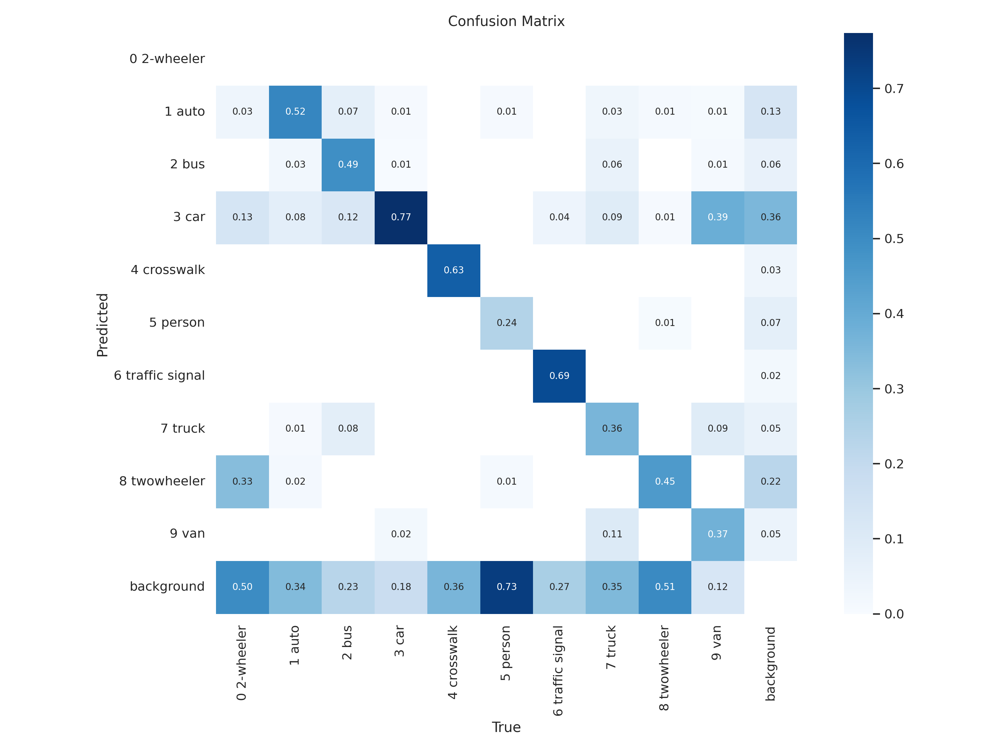

In [ ]:
Image(filename=f'/content/runs/detect/val3/confusion_matrix.png', width=600)

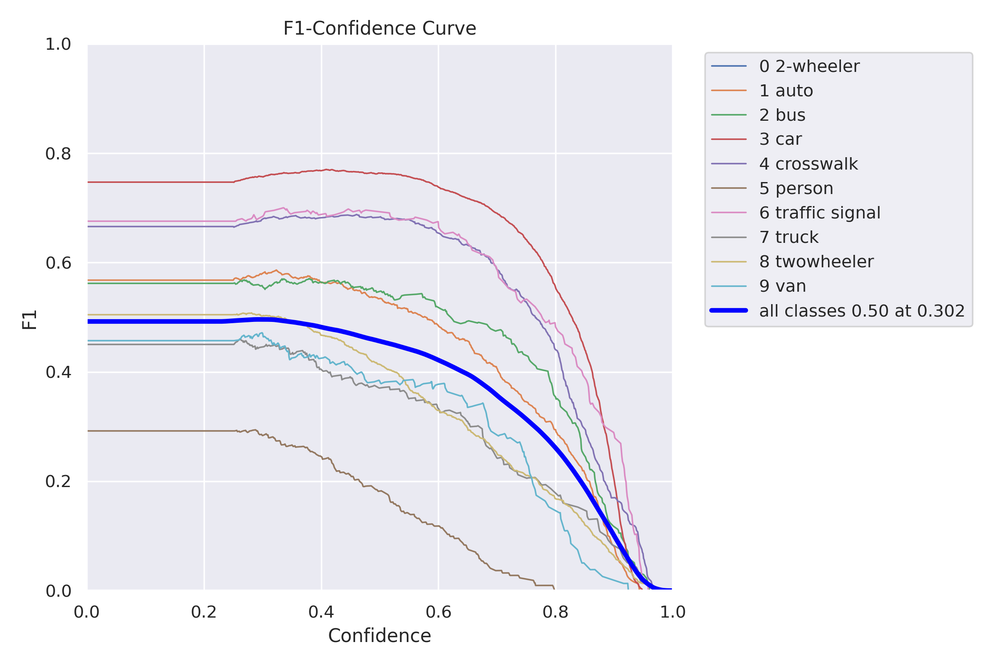

In [ ]:
Image(filename=f'/content/runs/detect/val3/F1_curve.png', width=600)

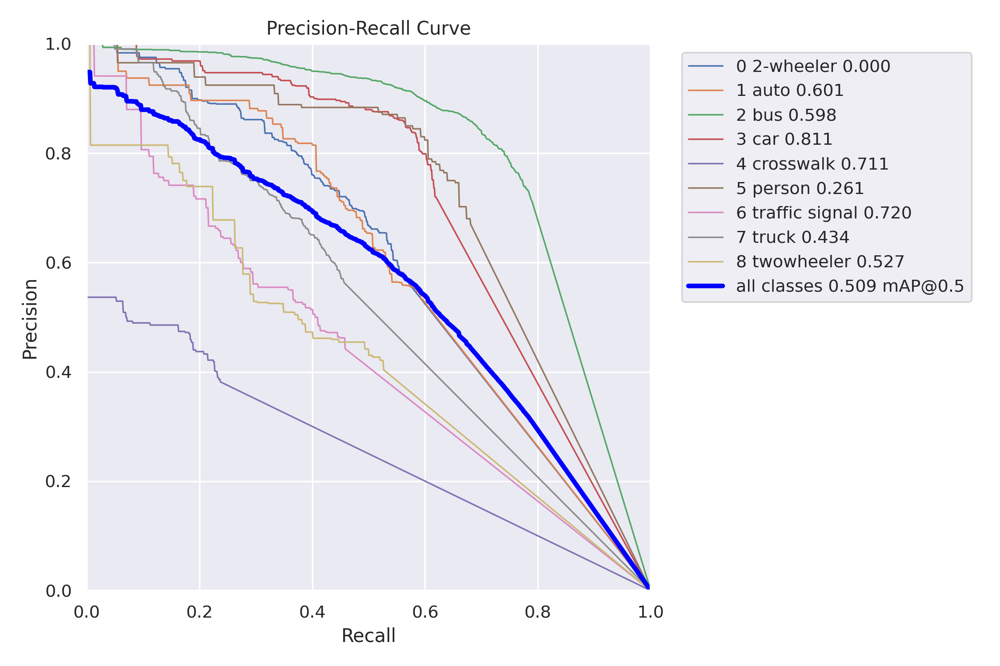

In [ ]:
Image(filename=f'/content/runs/detect/val3/PR_curve.png', width=600)

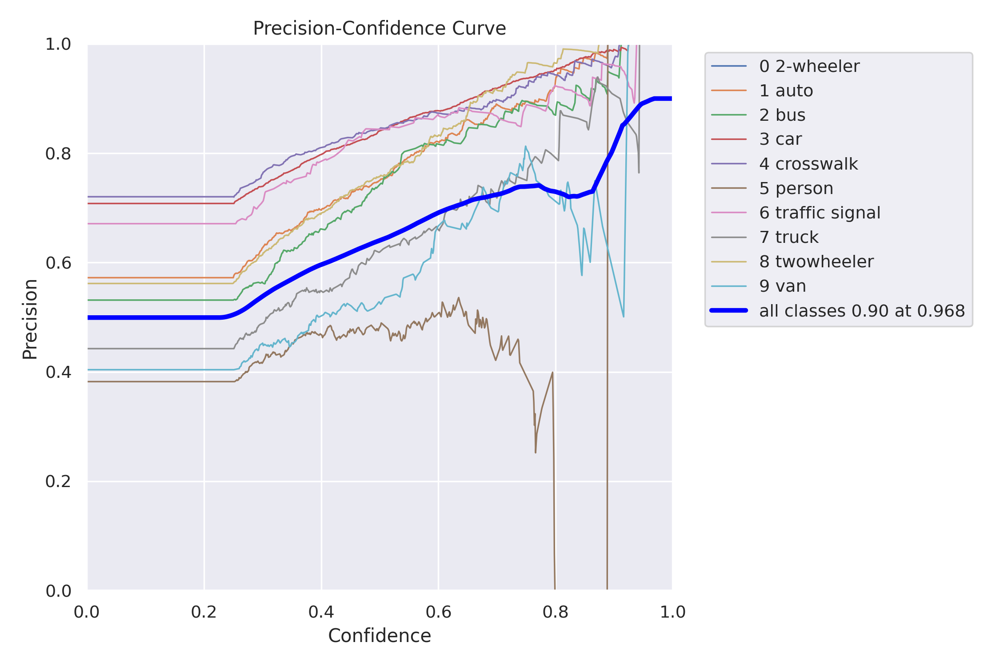

In [ ]:
Image(filename=f'/content/runs/detect/val3/P_curve.png', width=600)

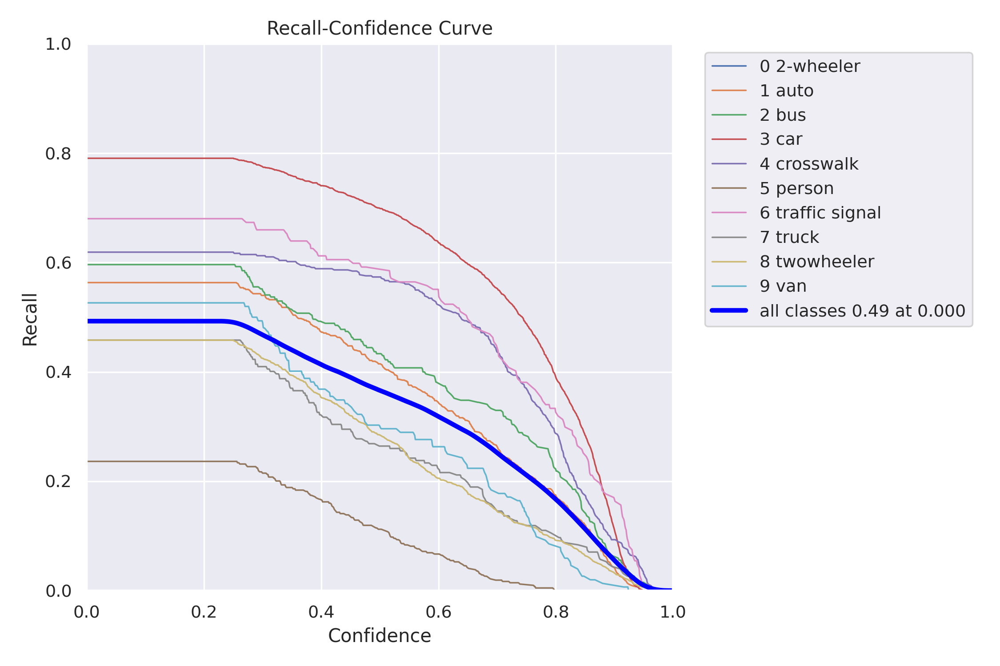

In [ ]:
Image(filename=f'/content/runs/detect/val3/R_curve.png', width=600)

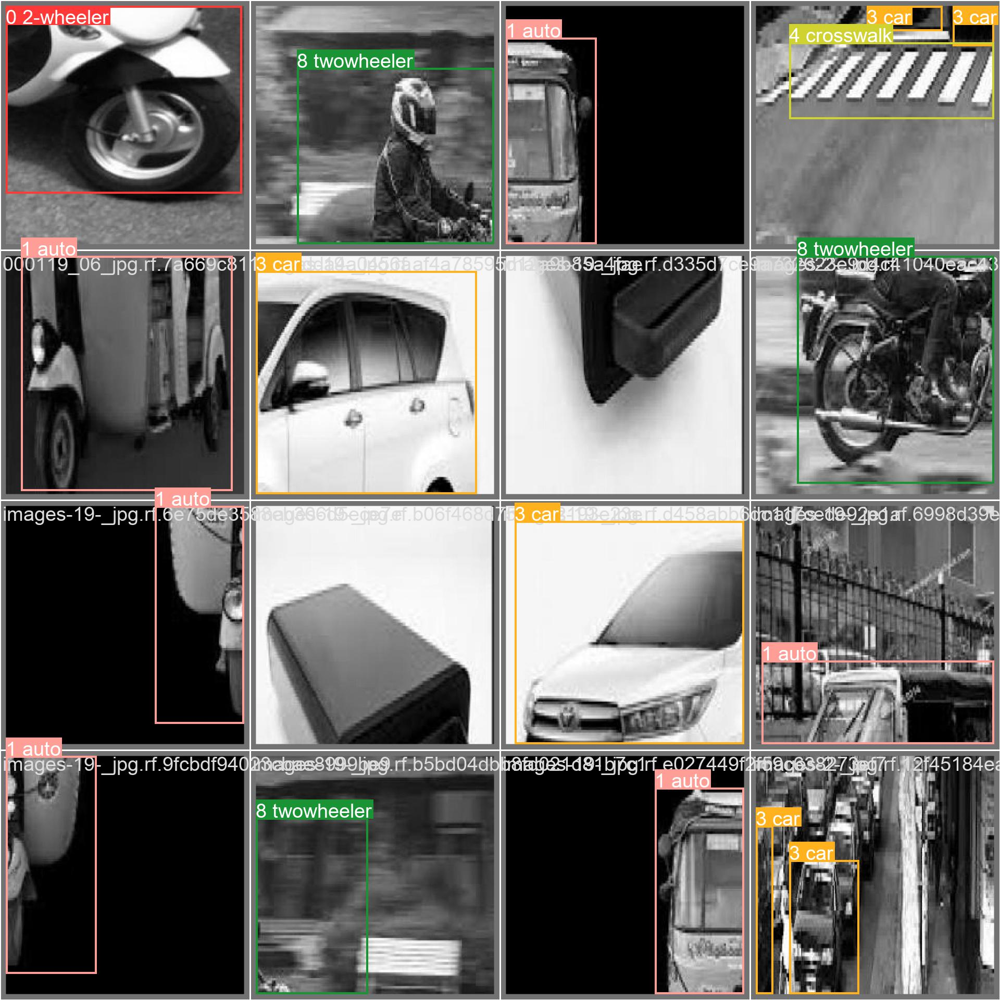

In [ ]:
Image(filename=f'/content/runs/detect/val3/val_batch0_labels.jpg', width=600)

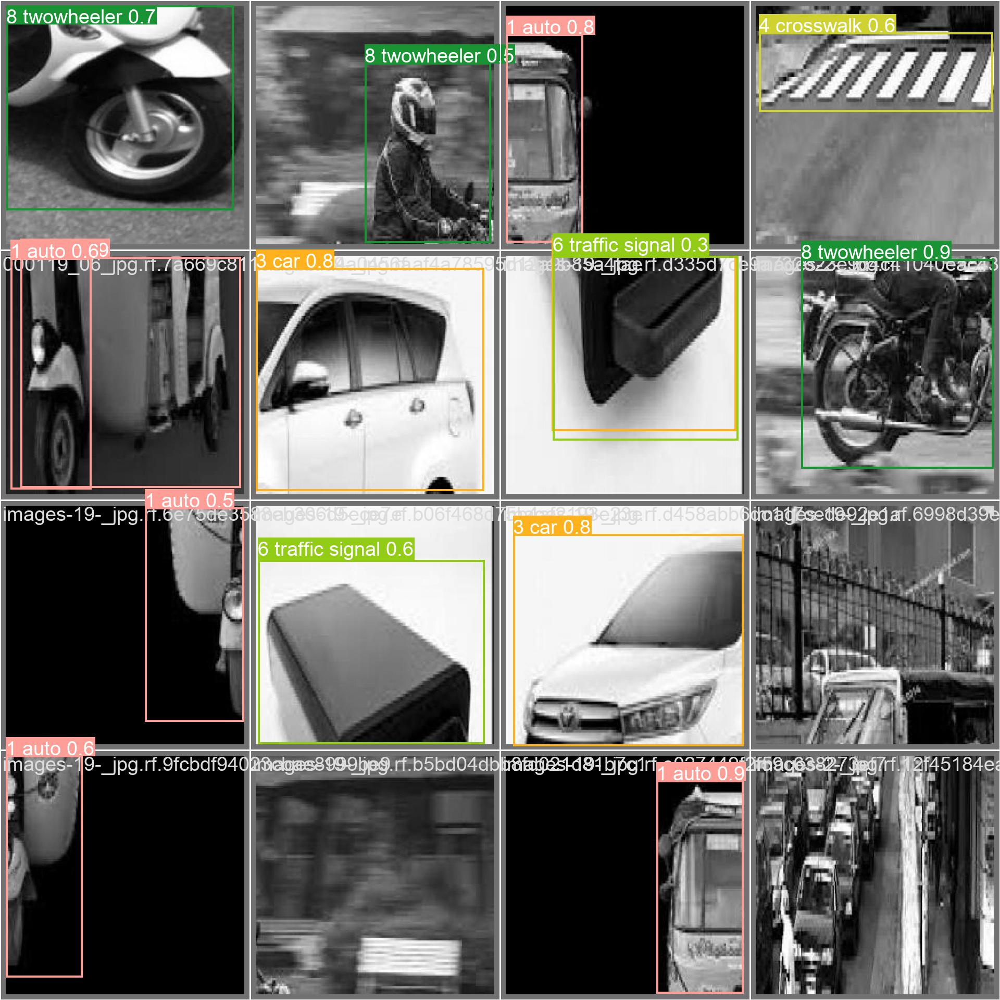

In [ ]:
Image(filename=f'/content/runs/detect/val3/val_batch0_pred.jpg', width=600)

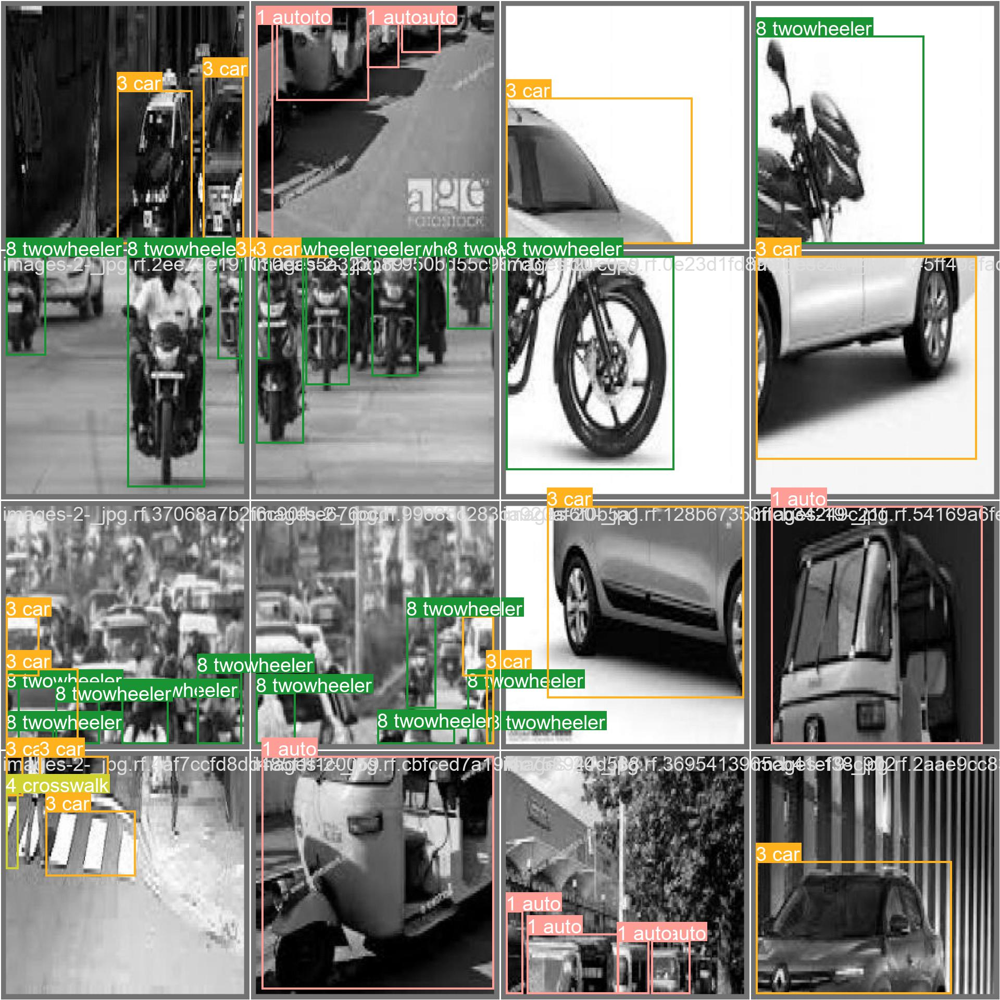

In [ ]:
Image(filename=f'/content/runs/detect/val3/val_batch1_labels.jpg', width=600)

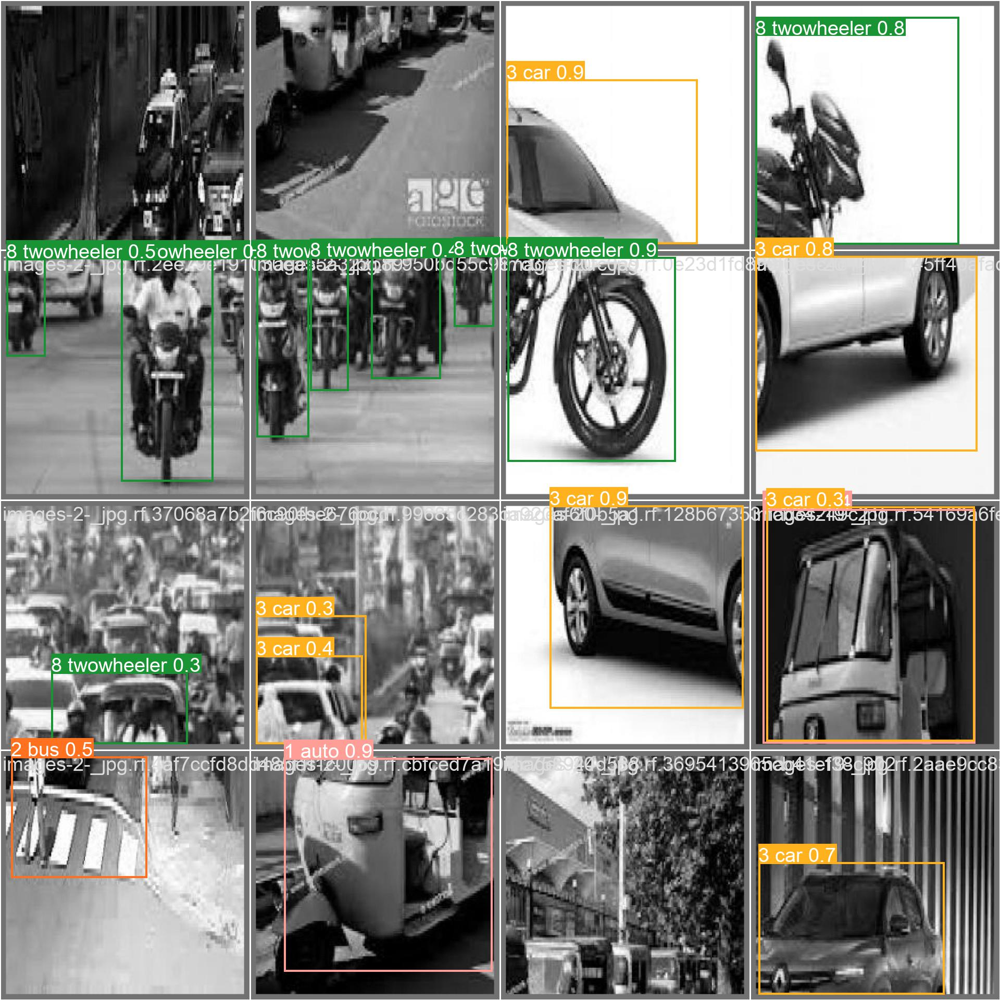

In [ ]:
Image(filename=f'/content/runs/detect/val3/val_batch1_pred.jpg', width=600)

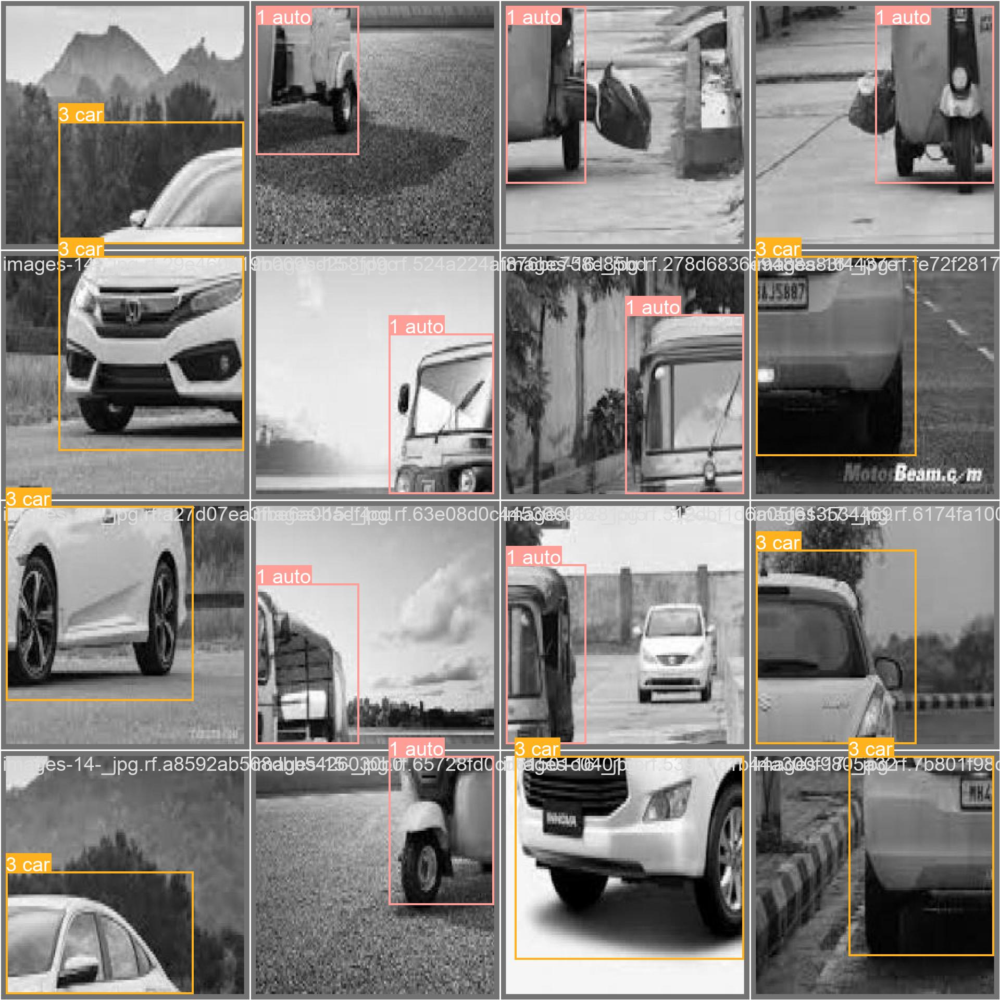

In [ ]:
Image(filename=f'/content/runs/detect/val3/val_batch2_labels.jpg', width=600)

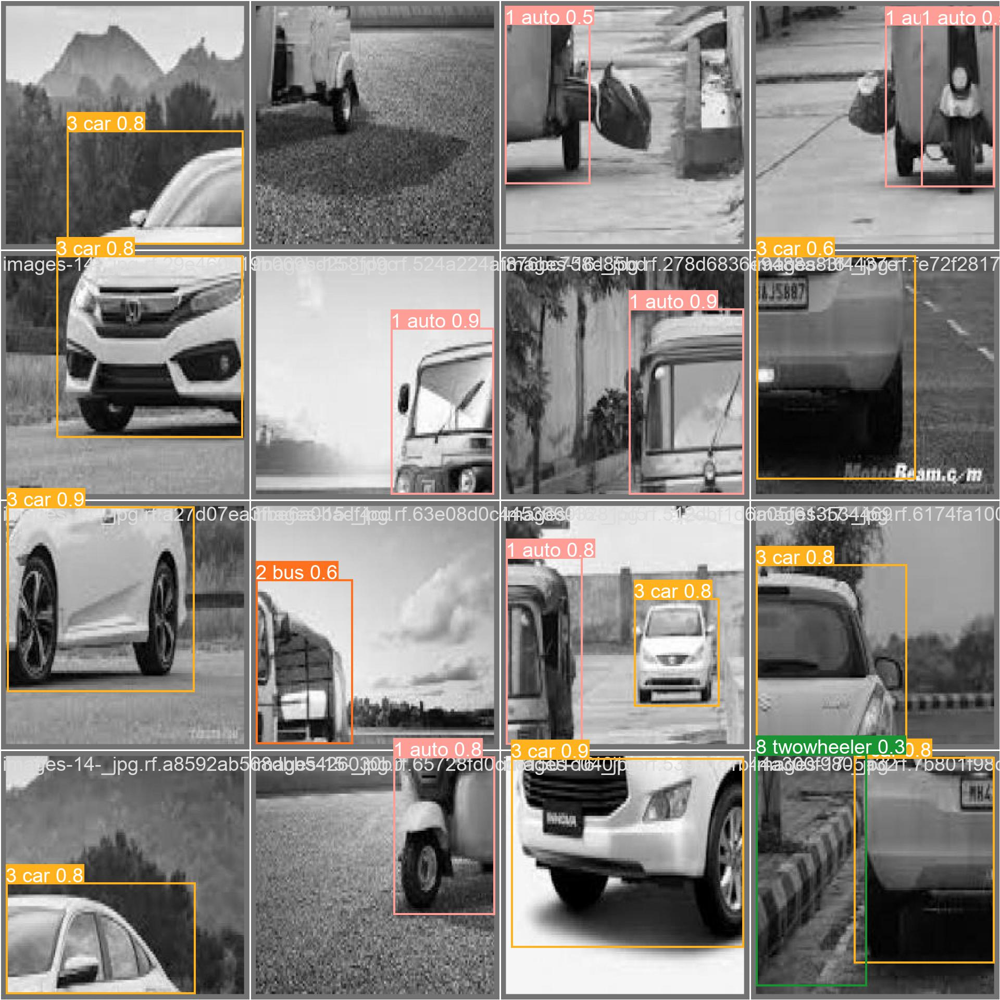

In [ ]:
Image(filename=f'/content/runs/detect/val3/val_batch2_pred.jpg', width=600)

## 1.4.4 Fourth Model
Again, this process will be run for the fourth model

In [ ]:
model = YOLO("/content/runs/detect/train4/weights/best.pt")
results_val_1 = model.val(source='/content/datasets/Deep-Learning---Group-Assignment-1/valid/images', conf=0.25, save=True, save_txt=True, save_conf=True)

Ultralytics YOLOv8.0.47 🚀 Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3007598 parameters, 0 gradients, 8.1 GFLOPs
val: Scanning /content/datasets/Deep-Learning---Group-Assignment-2/valid/labels.cache... 3896 images, 227 backgrounds, 0 corrupt: 100%|██████████| 3896/3896 [00:00<?, ?it/s]
val: WARNING ⚠️ /content/datasets/Deep-Learning---Group-Assignment-2/valid/images/c3_p1_82_jpg.rf.19a0b0fb05304dd14b75a8d39d277c01.jpg: 1 duplicate labels removed
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 626, len(boxes) = 6028. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 244/244 [00:36<00:00,  6.73it/s]
                   all       3896       6028      0.512      0.472      0.502      0

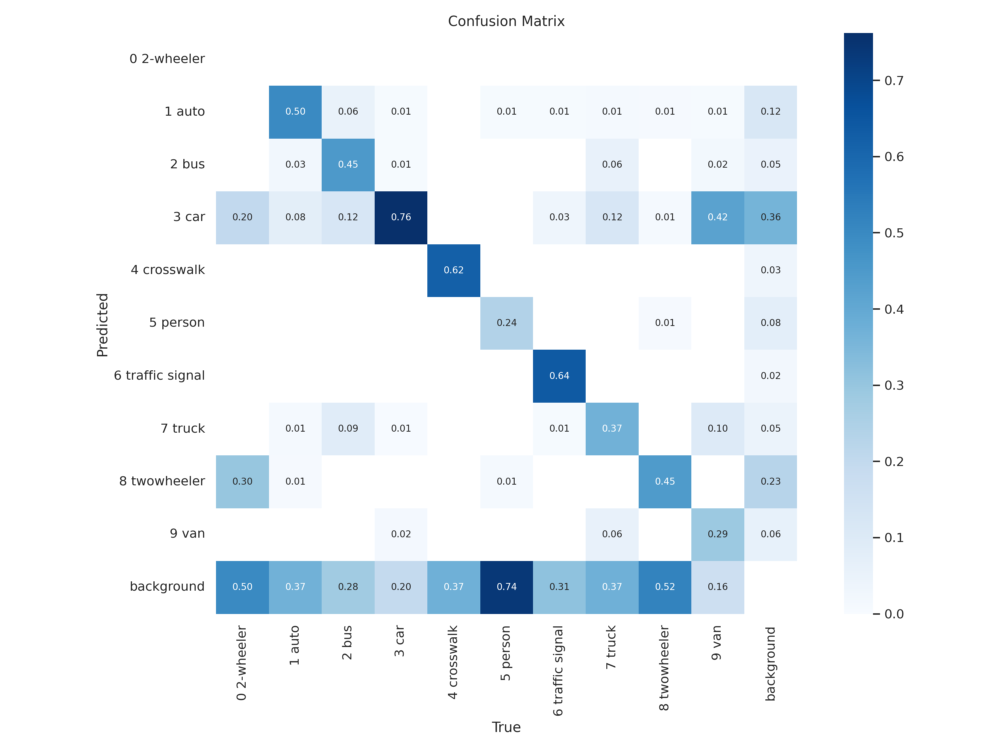

In [ ]:
Image(filename=f'/content/runs/detect/val10/confusion_matrix.png', width=600)

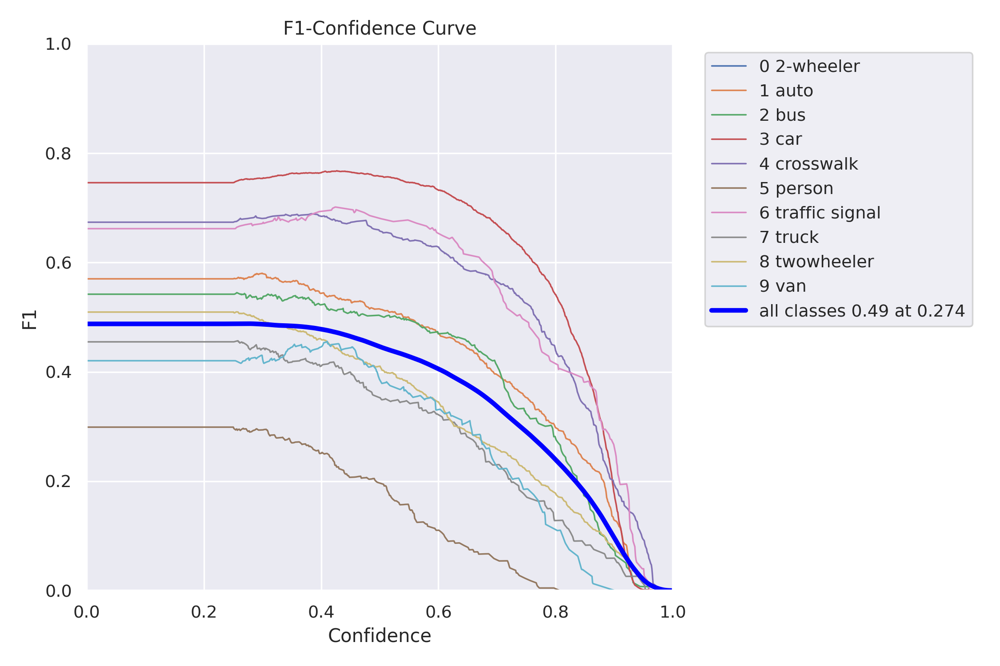

In [ ]:
Image(filename=f'/content/runs/detect/val10/F1_curve.png', width=600)

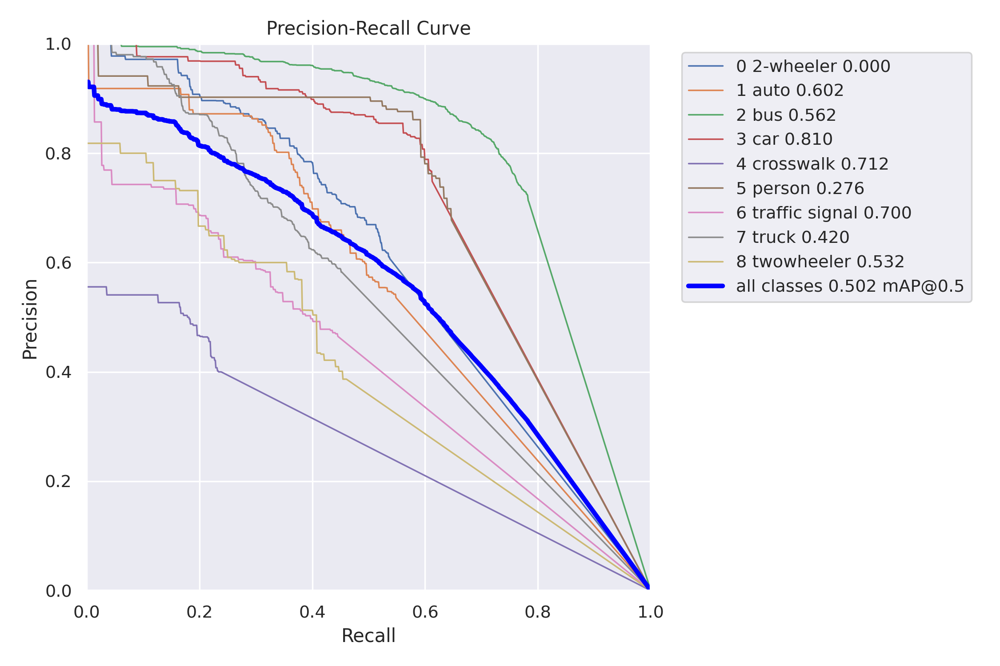

In [ ]:
Image(filename=f'/content/runs/detect/val10/PR_curve.png', width=600)

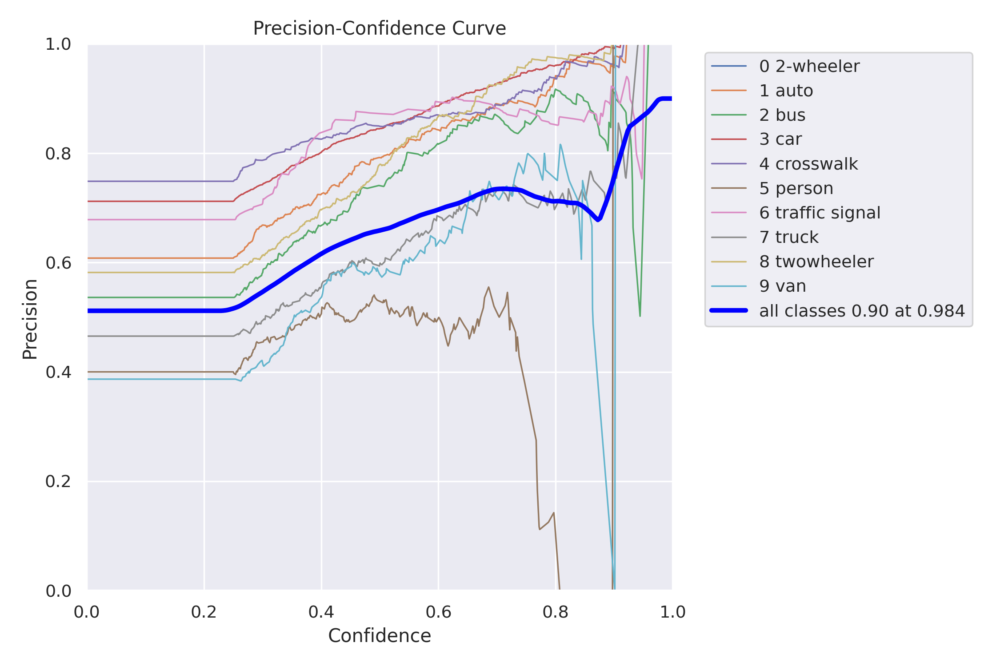

In [ ]:
Image(filename=f'/content/runs/detect/val10/P_curve.png', width=600)

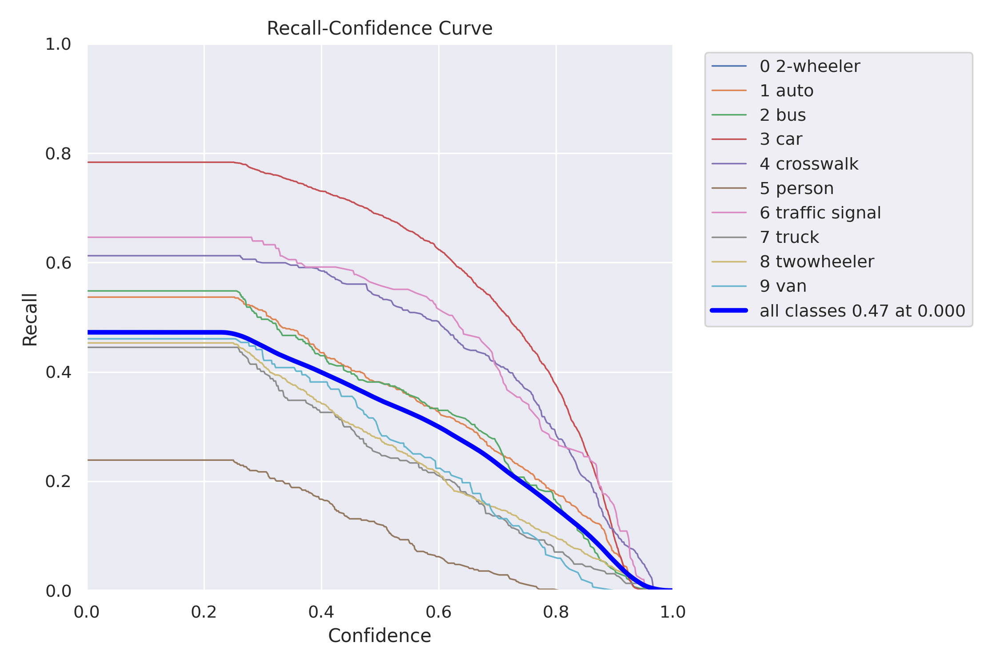

In [ ]:
Image(filename=f'/content/runs/detect/val10/R_curve.png', width=600)

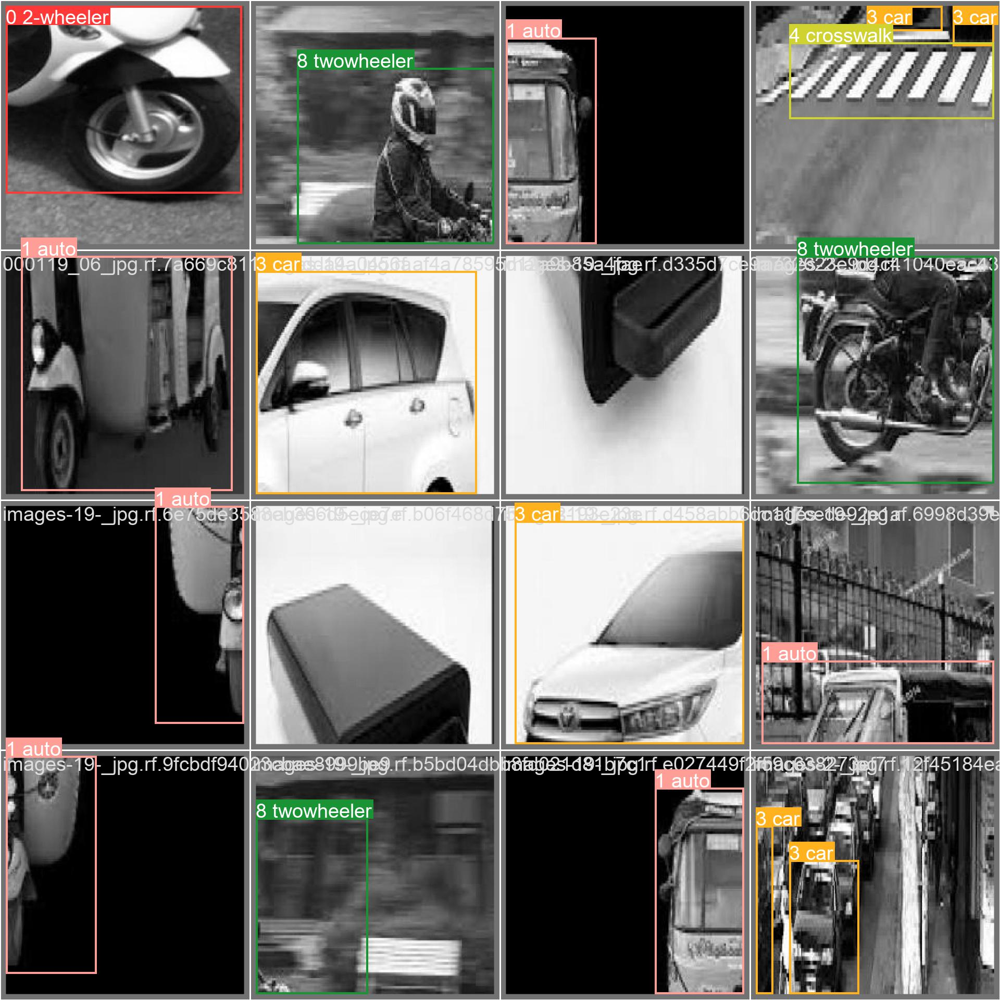

In [ ]:
Image(filename=f'/content/runs/detect/val10/val_batch0_labels.jpg', width=600)

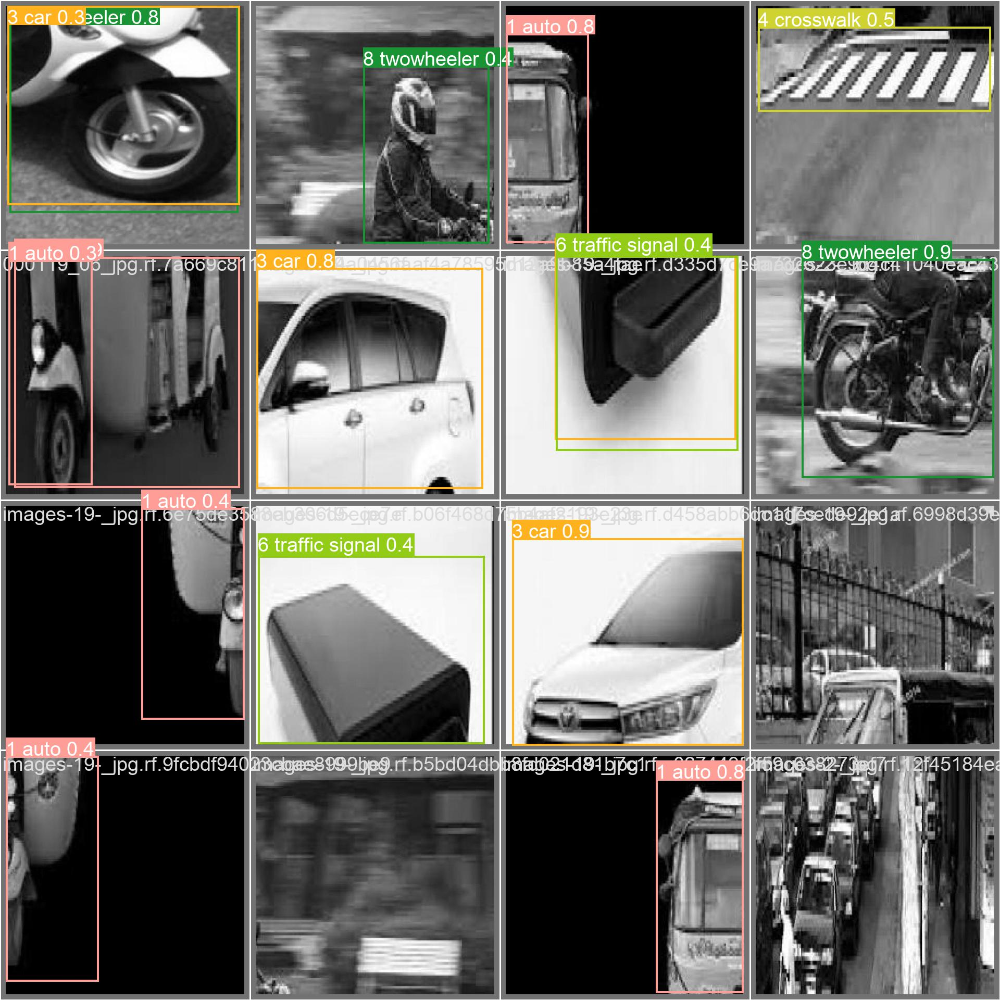

In [ ]:
Image(filename=f'/content/runs/detect/val10/val_batch0_pred.jpg', width=600)

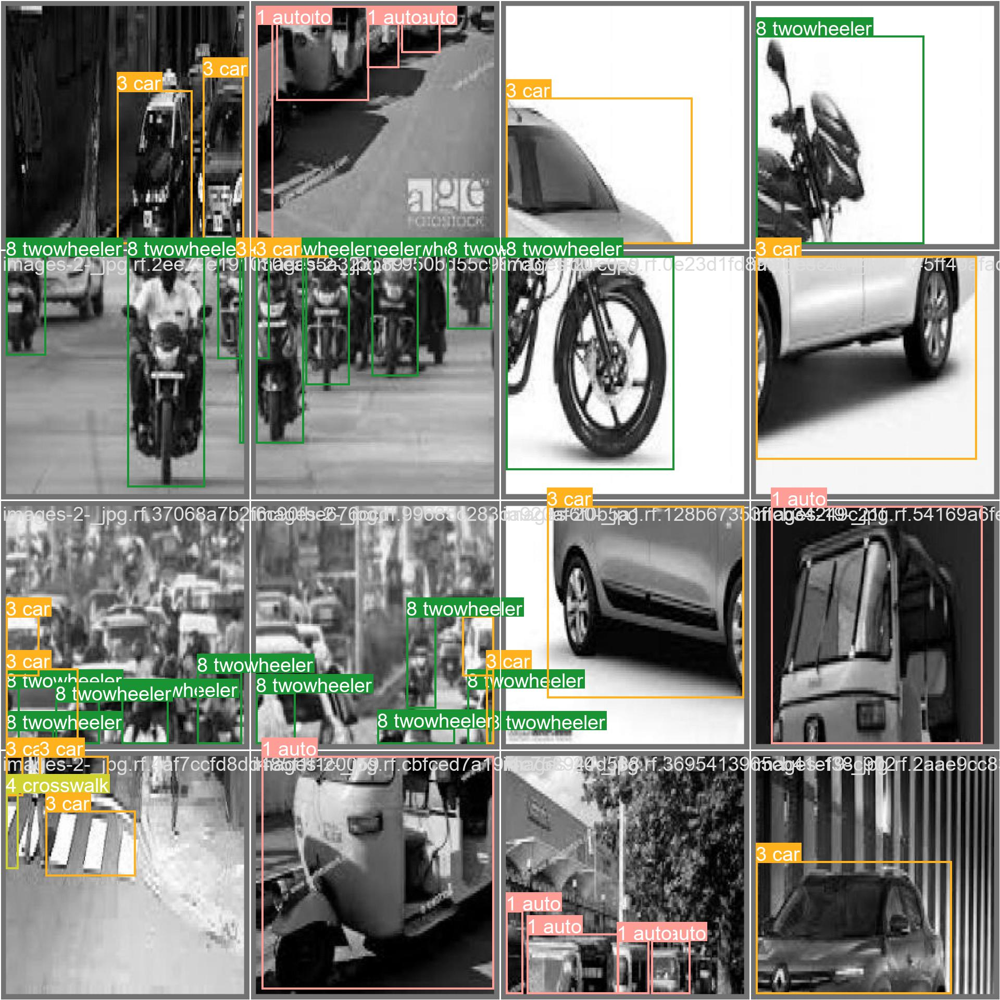

In [ ]:
Image(filename=f'/content/runs/detect/val10/val_batch1_labels.jpg', width=600)

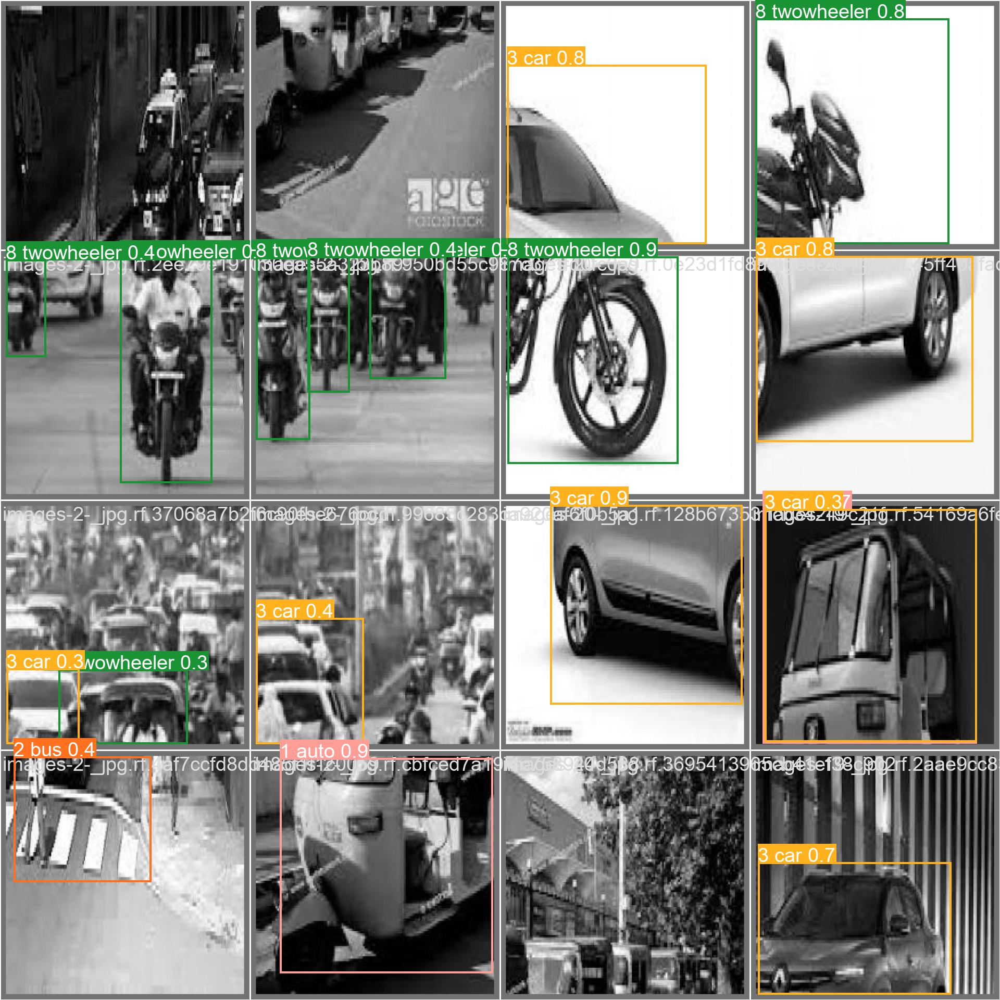

In [ ]:
Image(filename=f'/content/runs/detect/val10/val_batch1_pred.jpg', width=600)

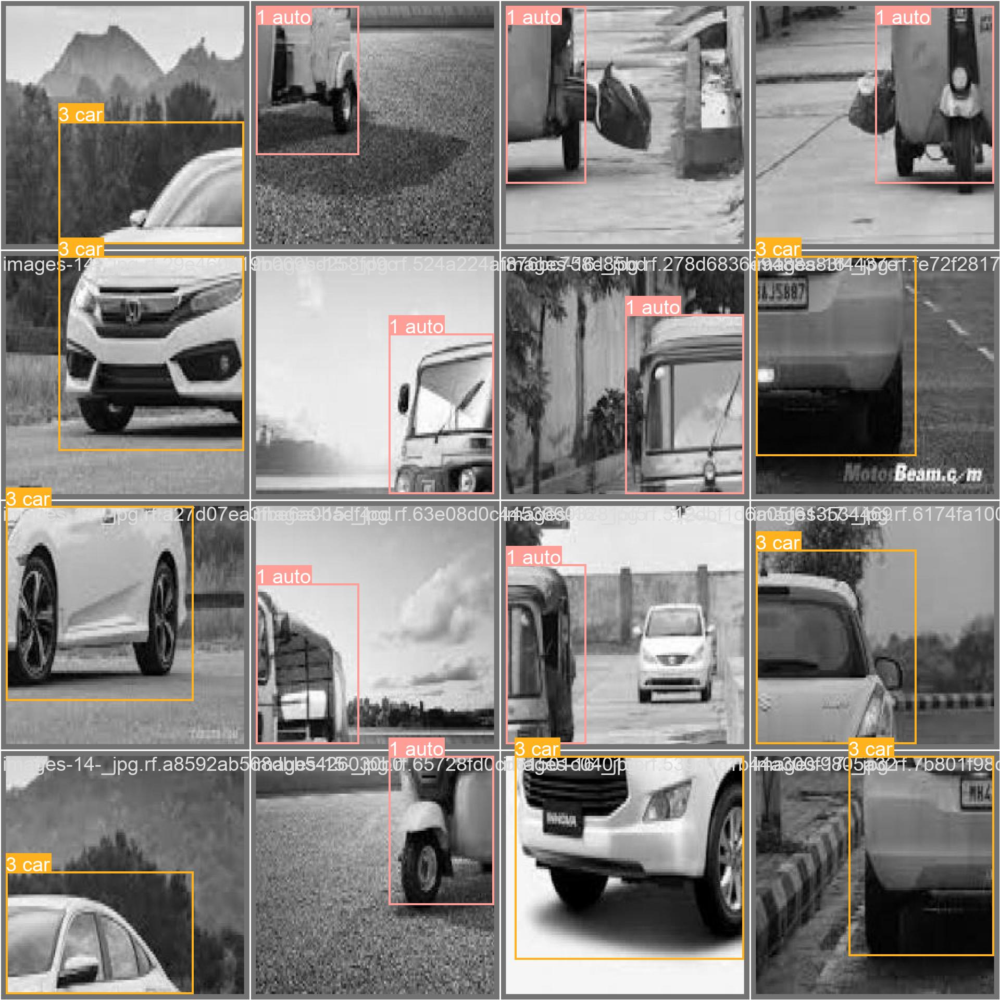

In [ ]:
Image(filename=f'/content/runs/detect/val10/val_batch2_labels.jpg', width=600)

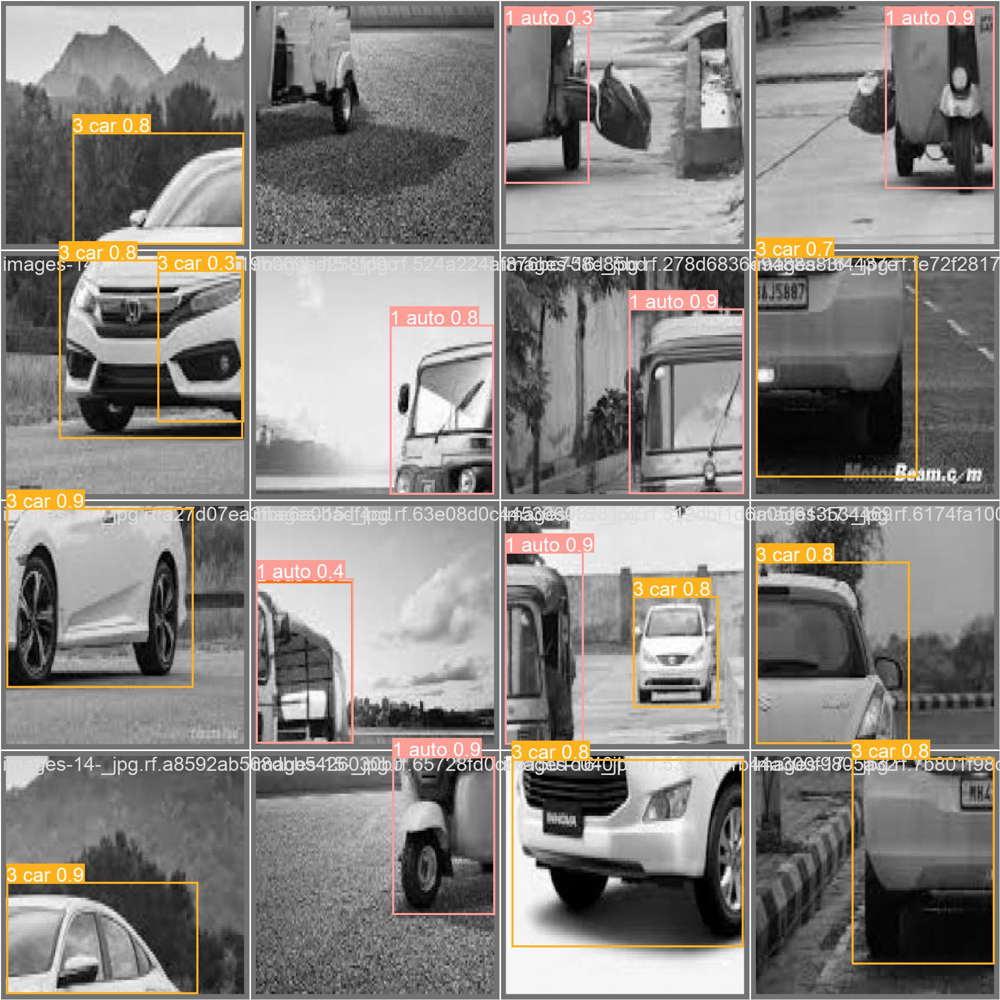

In [ ]:
Image(filename=f'/content/runs/detect/val10/val_batch2_pred.jpg', width=600)

## 1.4.5 Fifth Model
Lastly, the same process will be run for the fifth model.

In [24]:
model = YOLO("/content/runs/detect/train2/weights/best.pt")
results_val_1 = model.val(source='/content/datasets/Deep-Learning---Group-Assignment-1/valid/images', conf=0.25, save=True, save_txt=True, save_conf=True)

Ultralytics YOLOv8.0.47 🚀 Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 11129454 parameters, 0 gradients, 28.5 GFLOPs
val: Scanning /content/datasets/Deep-Learning---Group-Assignment-2/valid/labels.cache... 3896 images, 227 backgrounds, 0 corrupt: 100%|██████████| 3896/3896 [00:00<?, ?it/s]
val: WARNING ⚠️ /content/datasets/Deep-Learning---Group-Assignment-2/valid/images/c3_p1_82_jpg.rf.19a0b0fb05304dd14b75a8d39d277c01.jpg: 1 duplicate labels removed
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 626, len(boxes) = 6028. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 244/244 [01:06<00:00,  3.70it/s]
                   all       3896       6028      0.663      0.524      0.602     

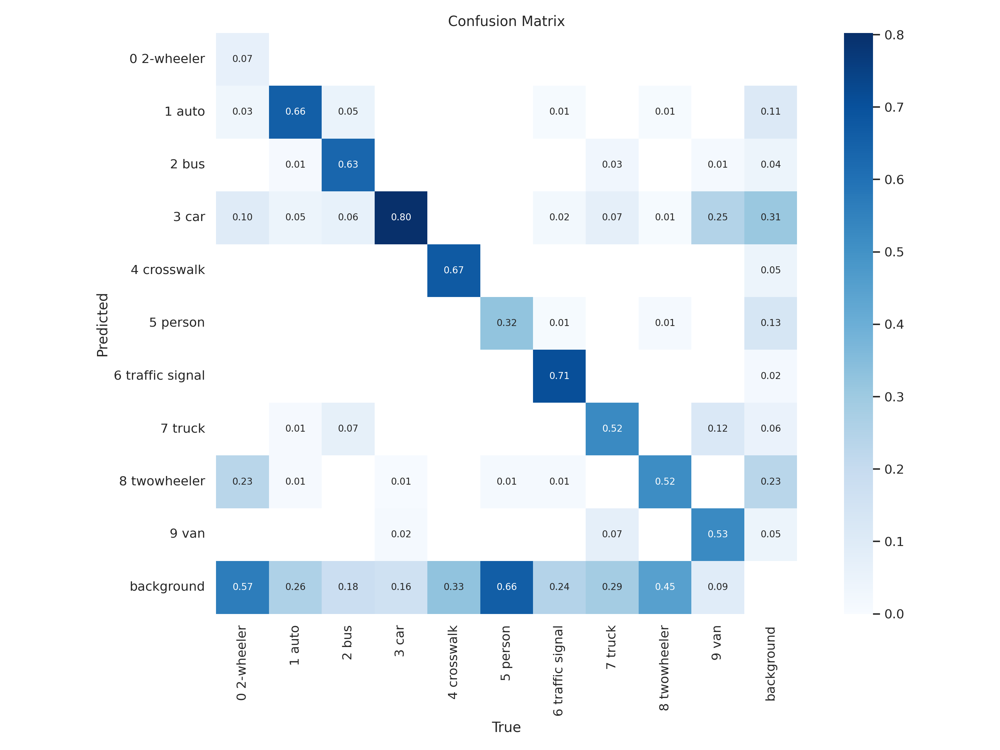

In [25]:
Image(filename=f'/content/runs/detect/val/confusion_matrix.png', width=600)

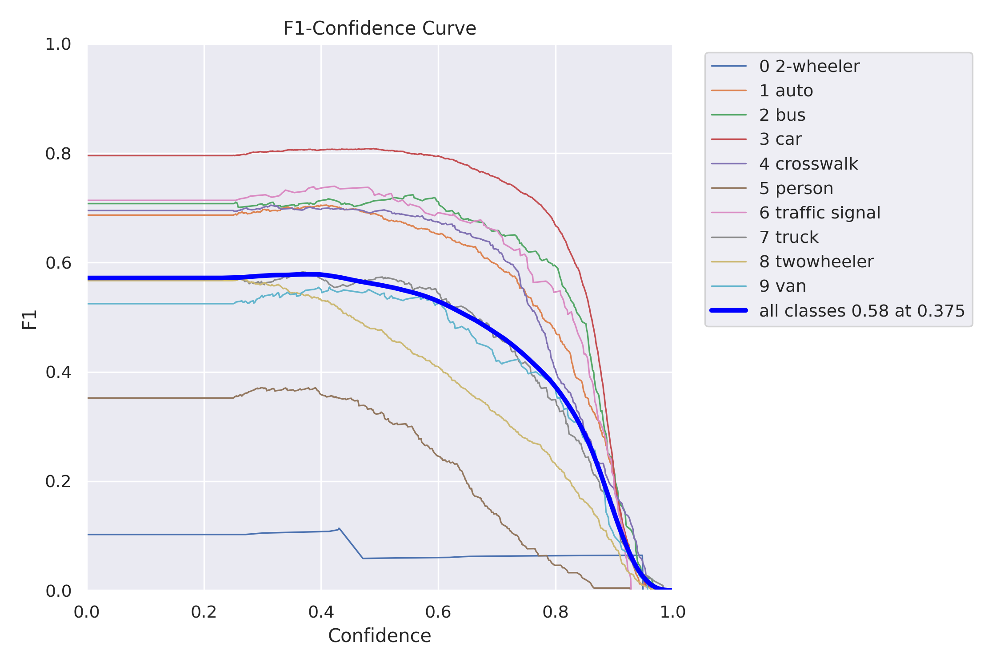

In [26]:
Image(filename=f'/content/runs/detect/val/F1_curve.png', width=600)

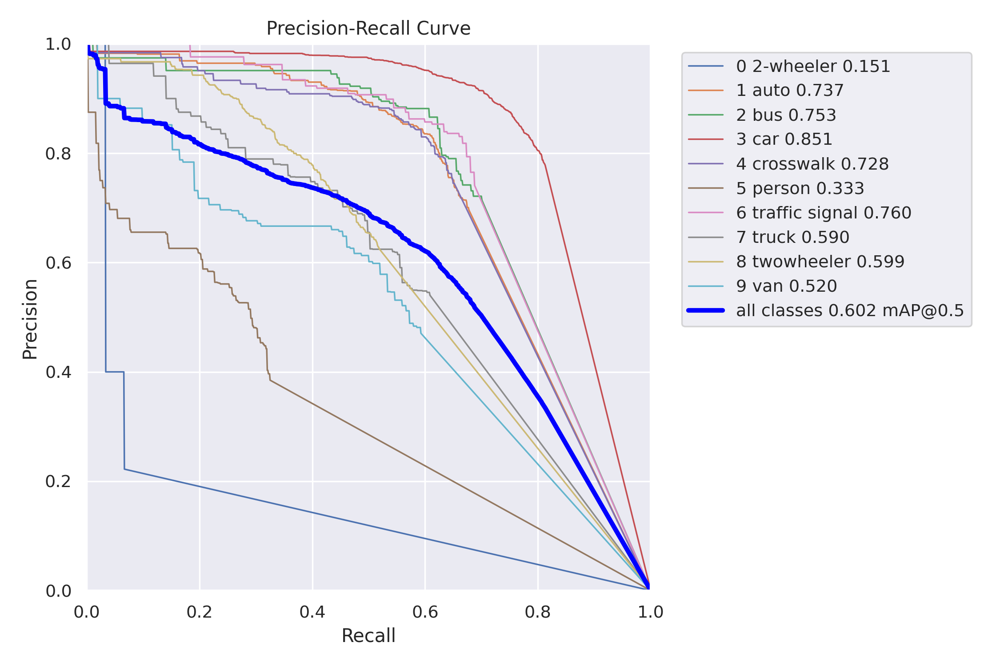

In [27]:
Image(filename=f'/content/runs/detect/val/PR_curve.png', width=600)

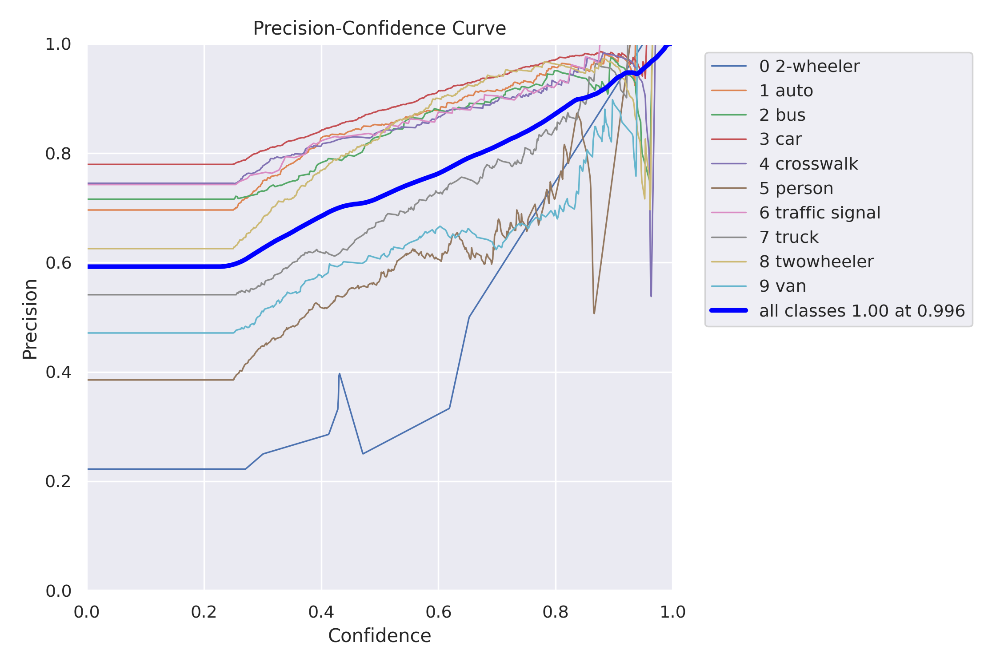

In [28]:
Image(filename=f'/content/runs/detect/val/P_curve.png', width=600)

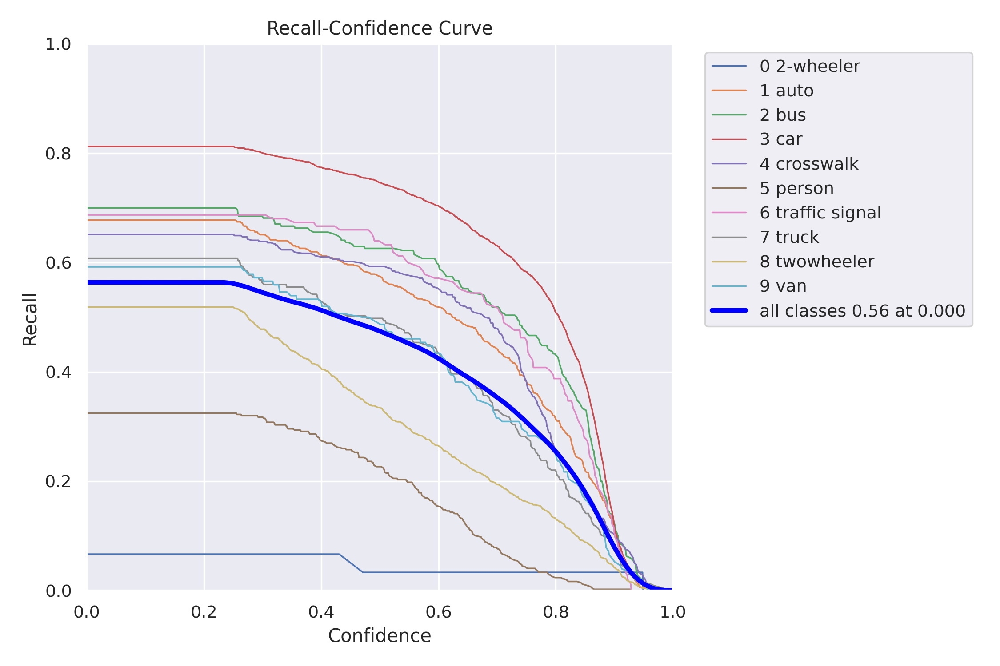

In [29]:
Image(filename=f'/content/runs/detect/val/R_curve.png', width=600)

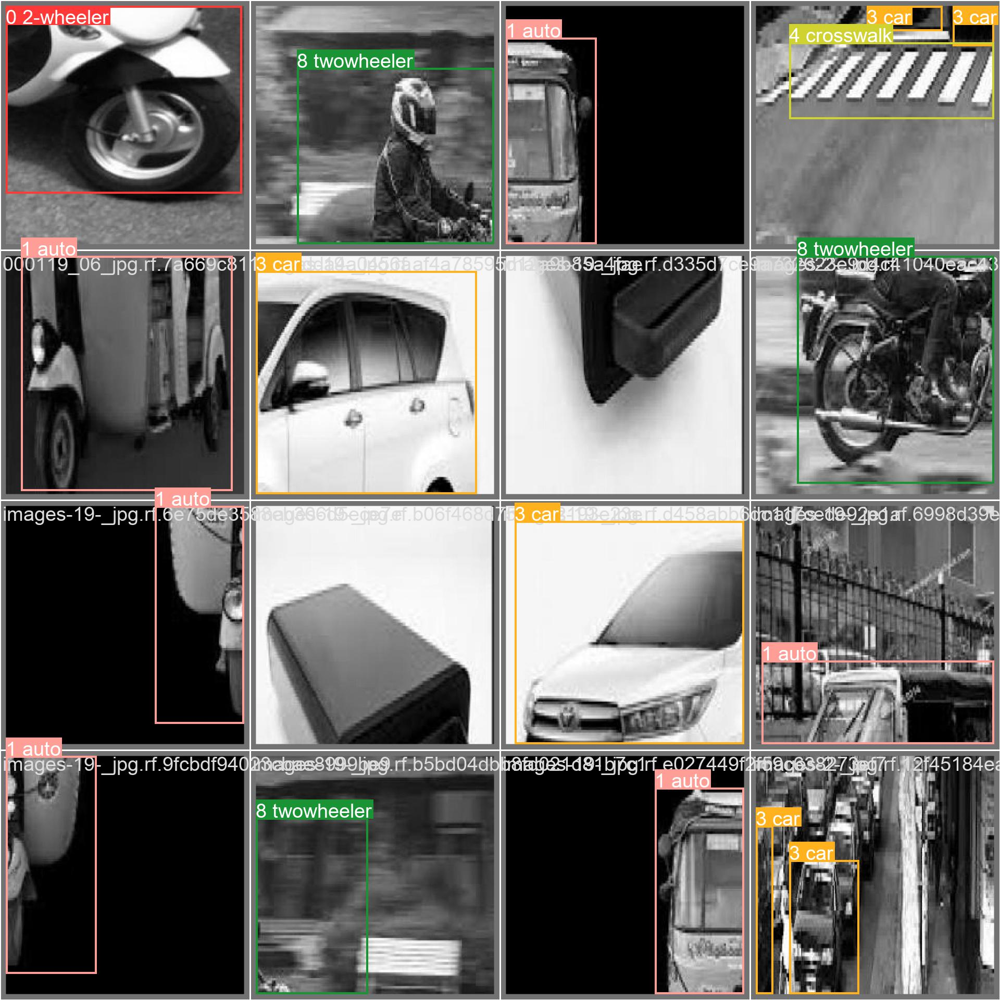

In [30]:
Image(filename=f'/content/runs/detect/val/val_batch0_labels.jpg', width=600)

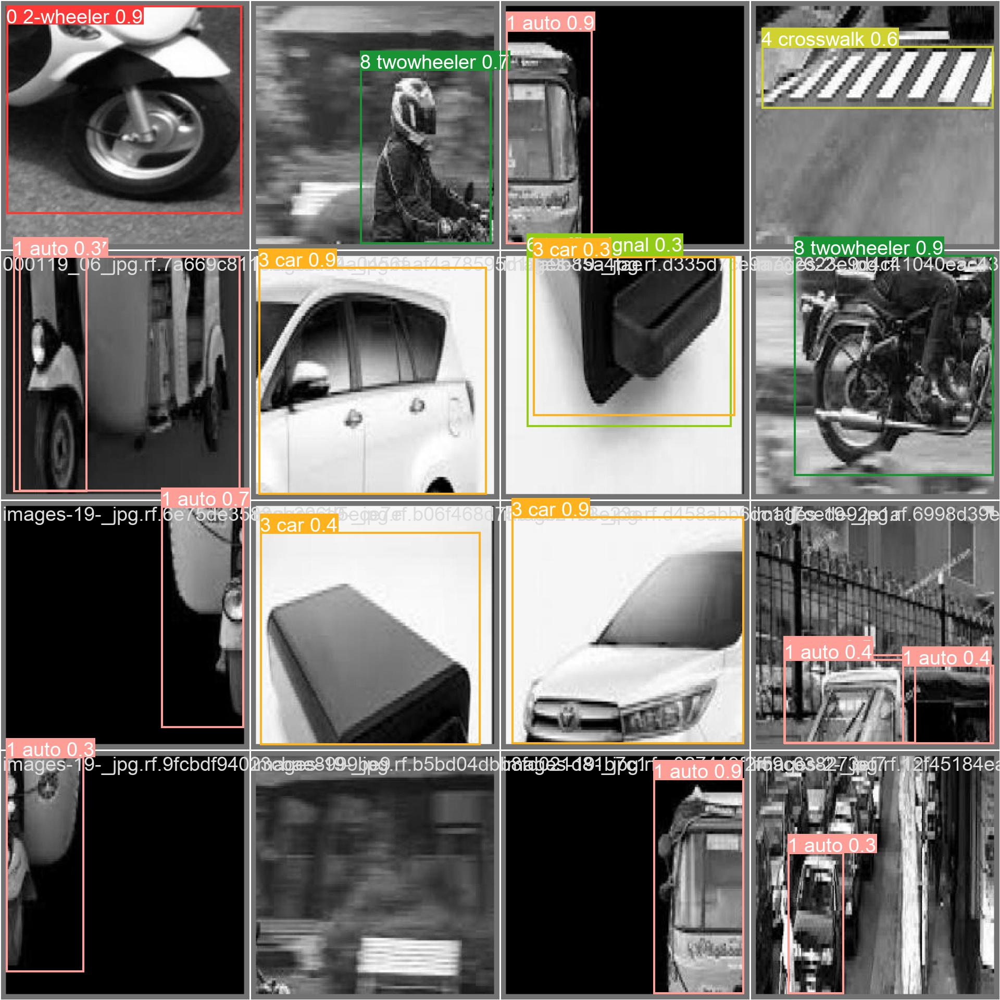

In [31]:
Image(filename=f'/content/runs/detect/val/val_batch0_pred.jpg', width=600)

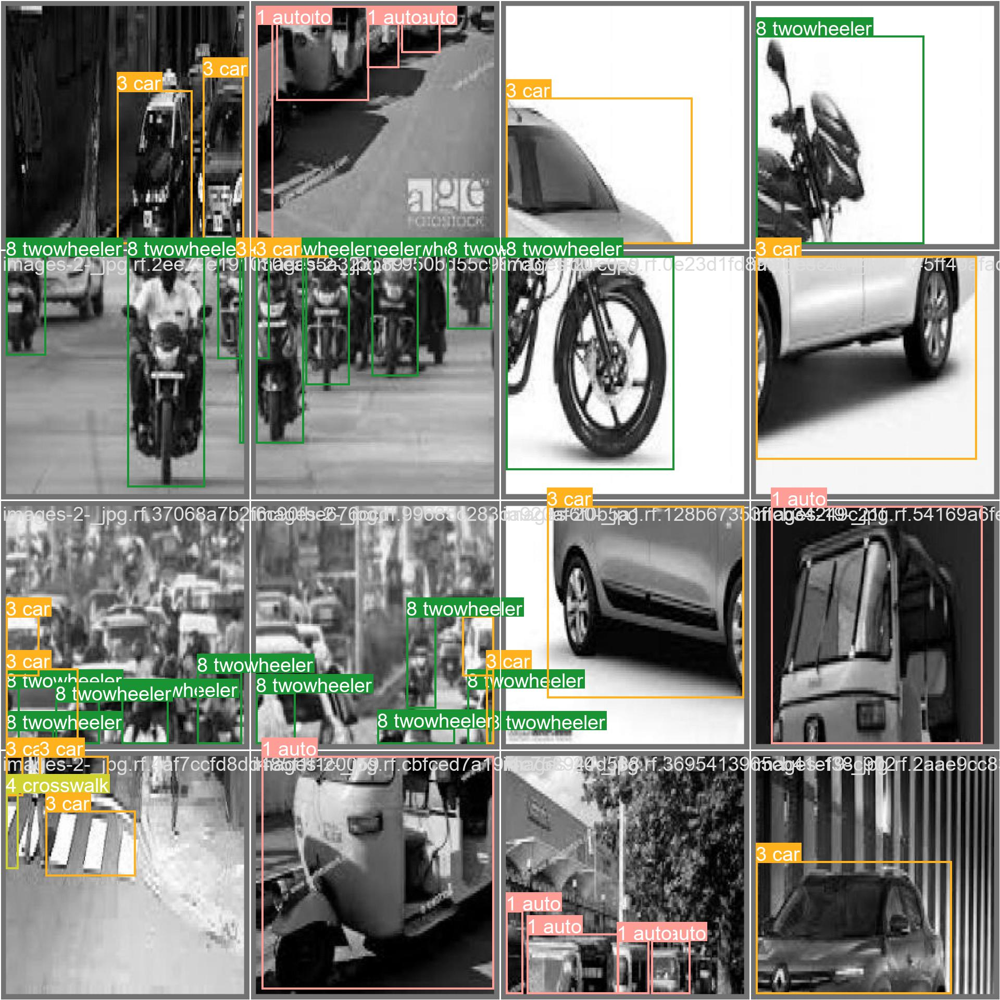

In [32]:
Image(filename=f'/content/runs/detect/val/val_batch1_labels.jpg', width=600)

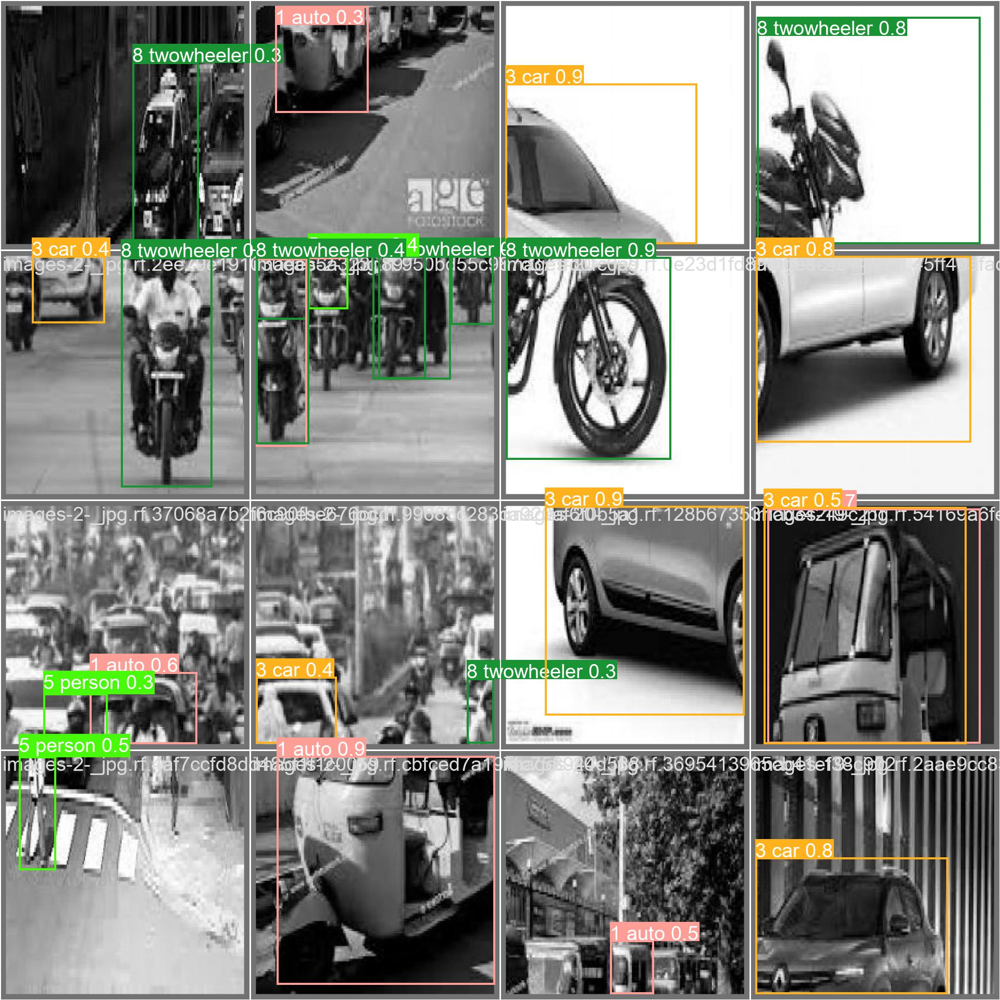

In [33]:
Image(filename=f'/content/runs/detect/val/val_batch1_pred.jpg', width=600)

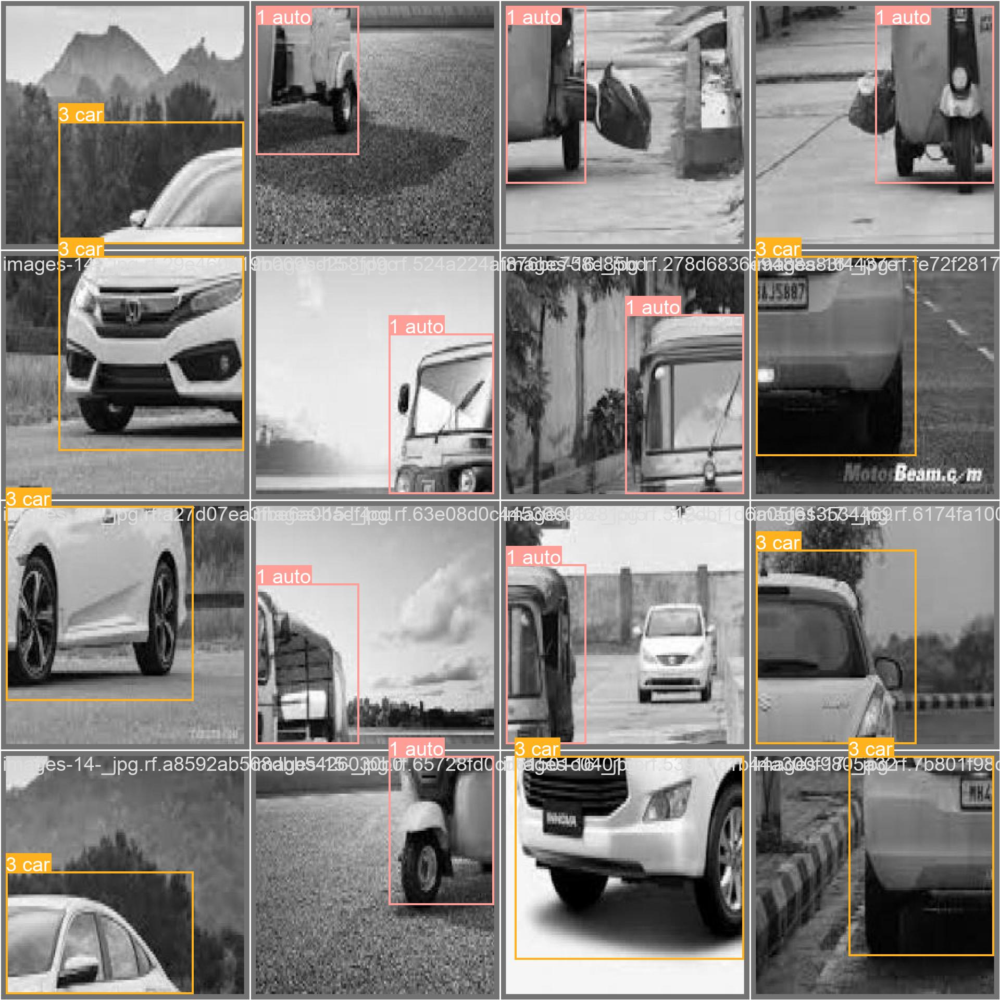

In [34]:
Image(filename=f'/content/runs/detect/val/val_batch2_labels.jpg', width=600)

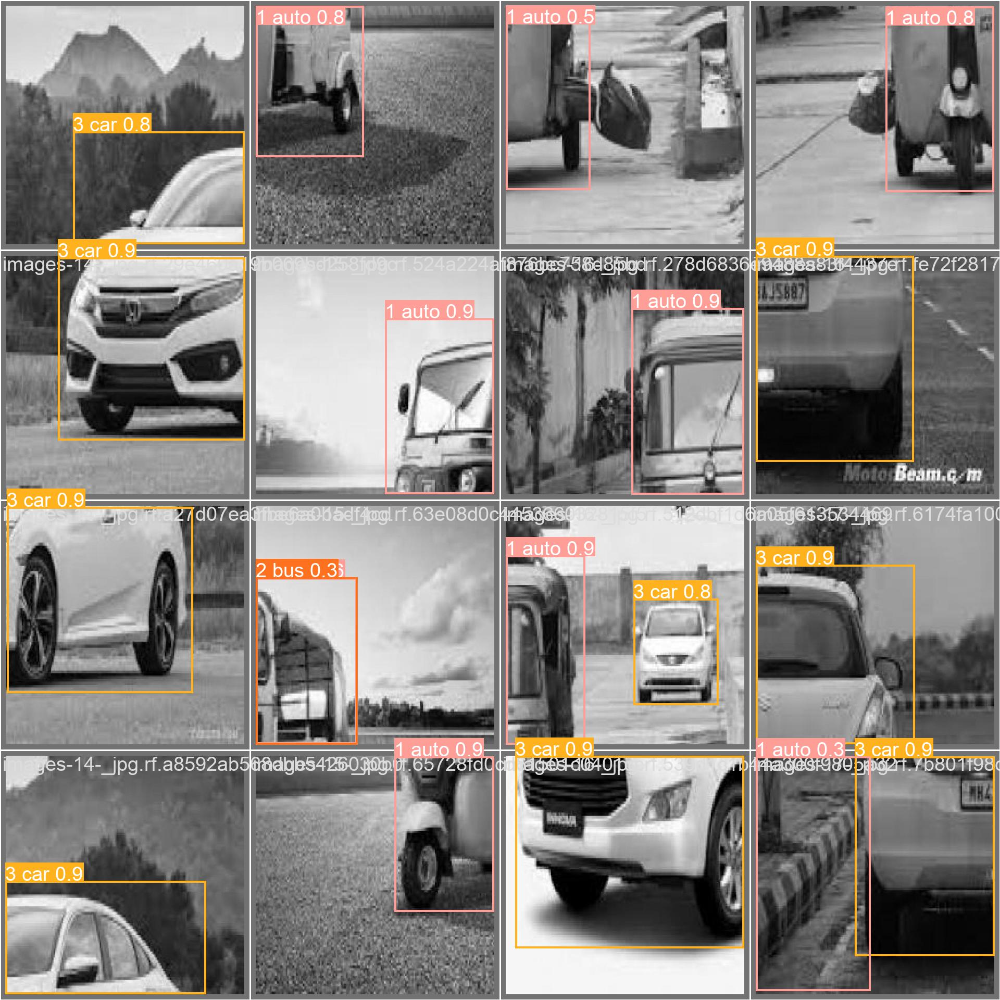

In [35]:
Image(filename=f'/content/runs/detect/val/val_batch2_pred.jpg', width=600)

## Validation conclussions
As it's quite obvious, the best performing model is the last one (model 5). This is the one which will be deployed.

# 1.5 Prediction on test

Now that we have choosed our final model, let's run the best model and predict on the test data set.

Take into account that, although the final model is the fifth one, the prediction on test was run on all models to do this methodically.

## 1.5.1 First Model

In [ ]:
%cd {HOME}
model = YOLO("/content/runs/detect/train/weights/best.pt")
results_1 = model.predict(source='/content/datasets/Deep-Learning---Group-Assignment-1/test/images', conf=0.25, save=True, save_txt=True, save_conf=True)

Ultralytics YOLOv8.0.47 🚀 Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3007598 parameters, 0 gradients, 8.1 GFLOPs



/content


image 1/487 /content/datasets/Deep-Learning---Group-Assignment-1/test/images/00013_jpg.rf.97e3ac7cb4a19417eca0ccb081310f67.jpg: 640x640 1 3 car, 20.0ms
image 2/487 /content/datasets/Deep-Learning---Group-Assignment-1/test/images/000176_01_jpg.rf.b1aece50d22929d16091a0338d6ba6d2.jpg: 640x640 1 1 auto, 17.4ms
image 3/487 /content/datasets/Deep-Learning---Group-Assignment-1/test/images/000203_03_jpg.rf.fc6e5ea7d9265d74802e1585a7b1ad47.jpg: 640x640 1 3 car, 1 8 twowheeler, 16.8ms
image 4/487 /content/datasets/Deep-Learning---Group-Assignment-1/test/images/00030_jpg.rf.78216f40d0b5b9071b245adce99834c4.jpg: 640x640 1 3 car, 17.8ms
image 5/487 /content/datasets/Deep-Learning---Group-Assignment-1/test/images/00050_jpg.rf.7eec1b3e494cc5ef372926fd063771ca.jpg: 640x640 1 3 car, 15.8ms
image 6/487 /content/datasets/Deep-Learning---Group-Assignment-1/test/images/00051_jpg.rf.8c2938943ea199afb834545702982539.jpg: 640x640 1 3 car, 19.9ms
image 7/487 /content/datasets/Deep-Learning---Group-Assignment-

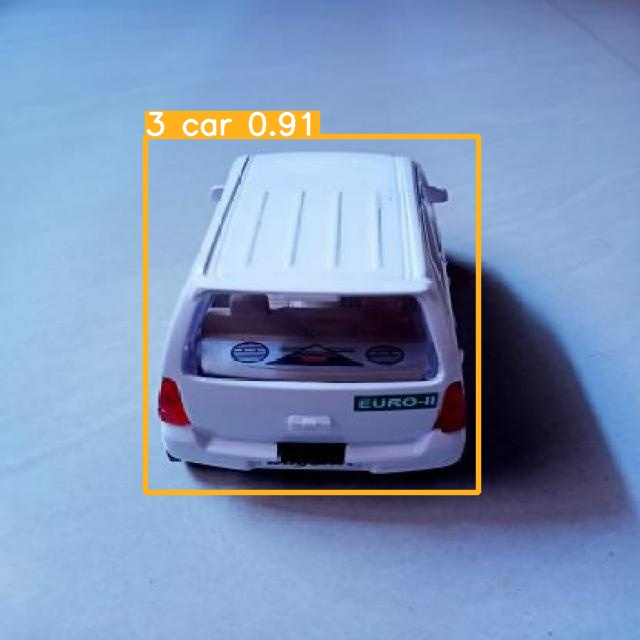

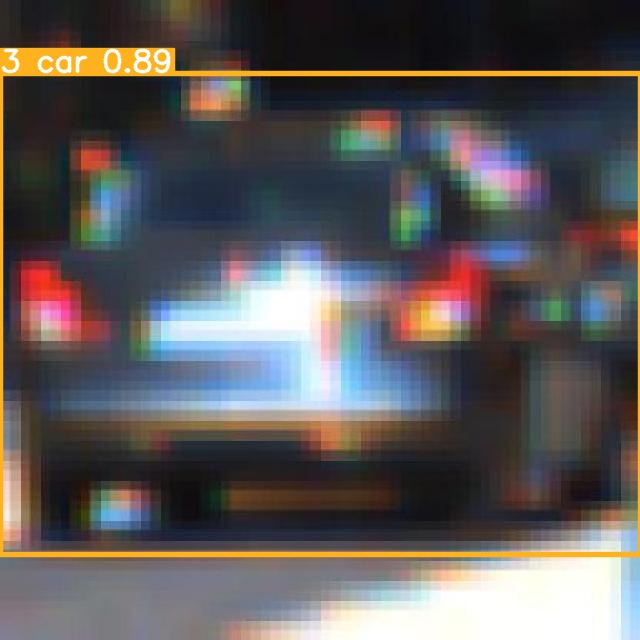

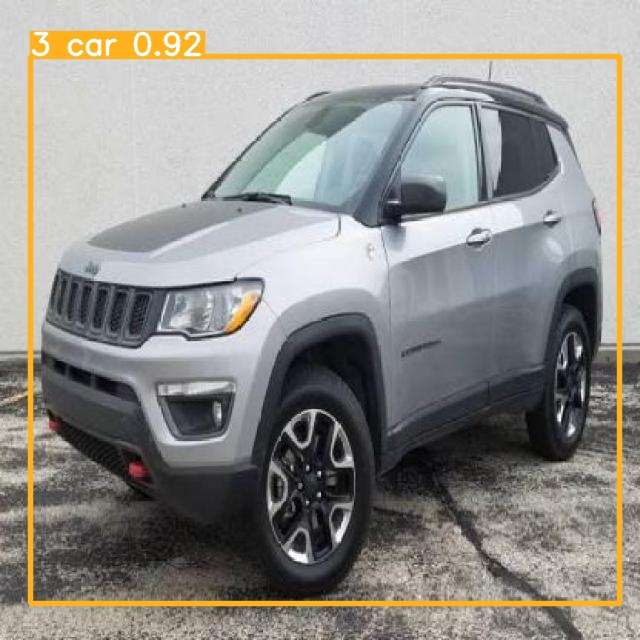

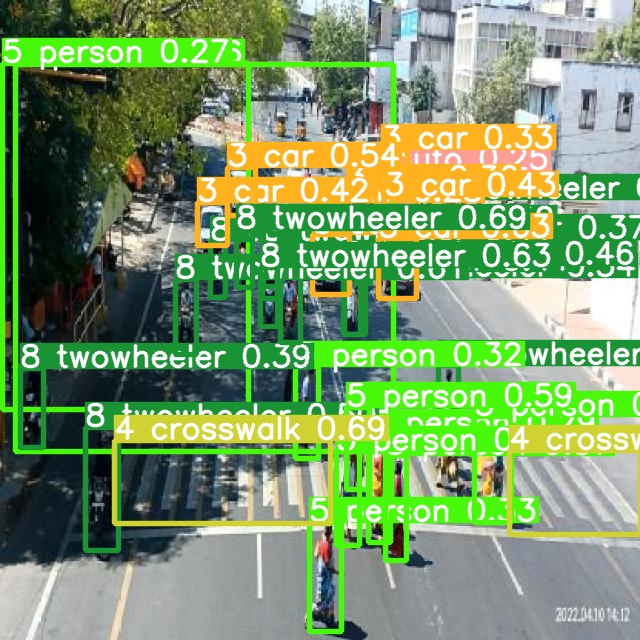

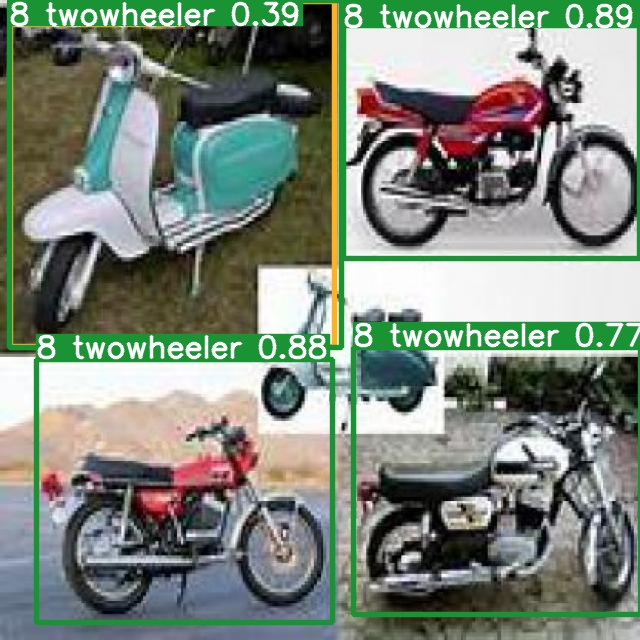

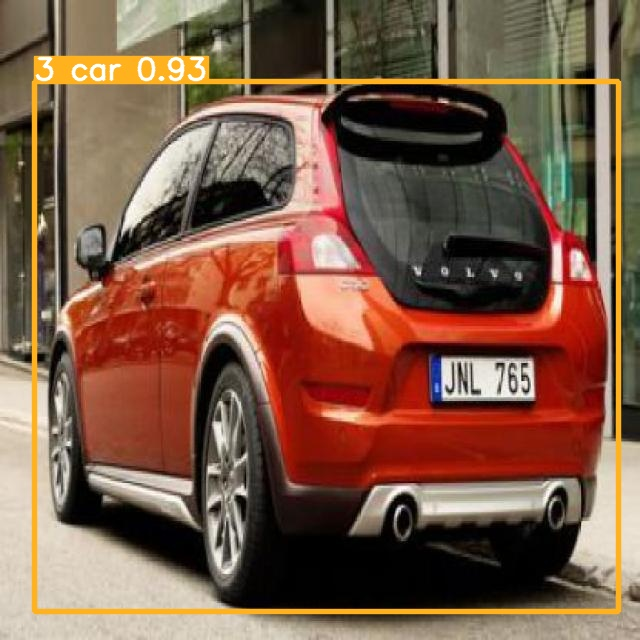

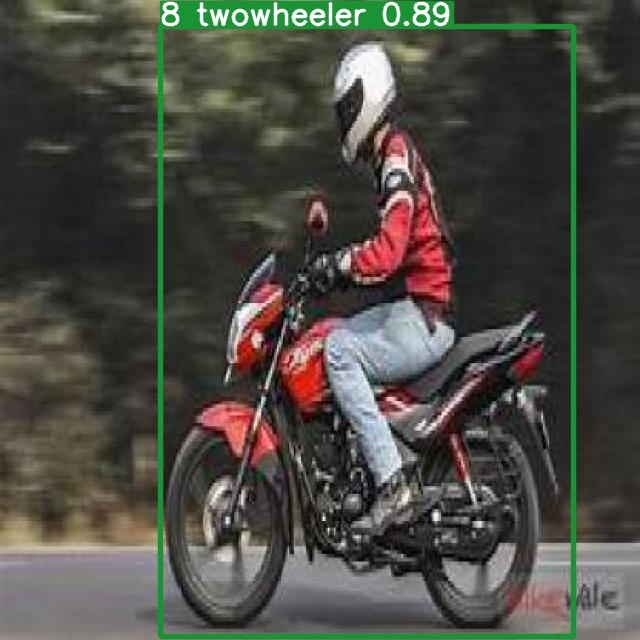

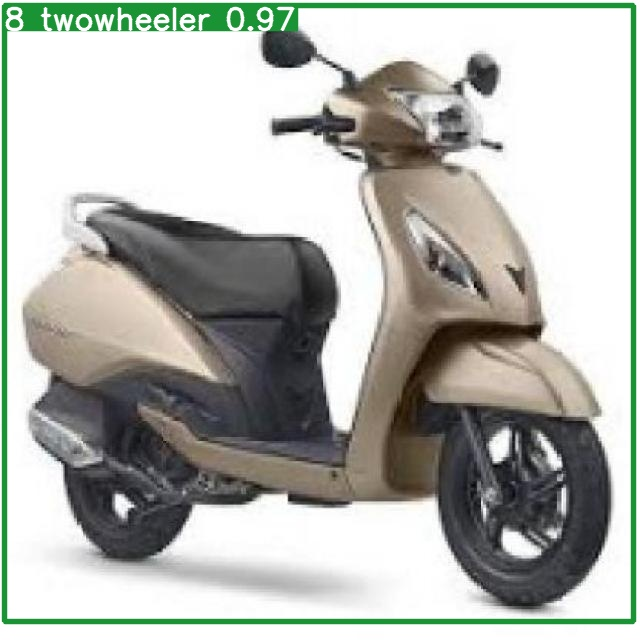

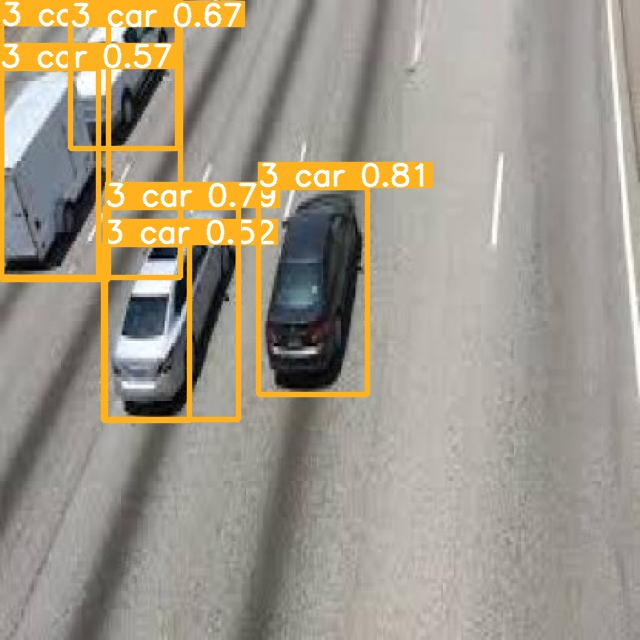

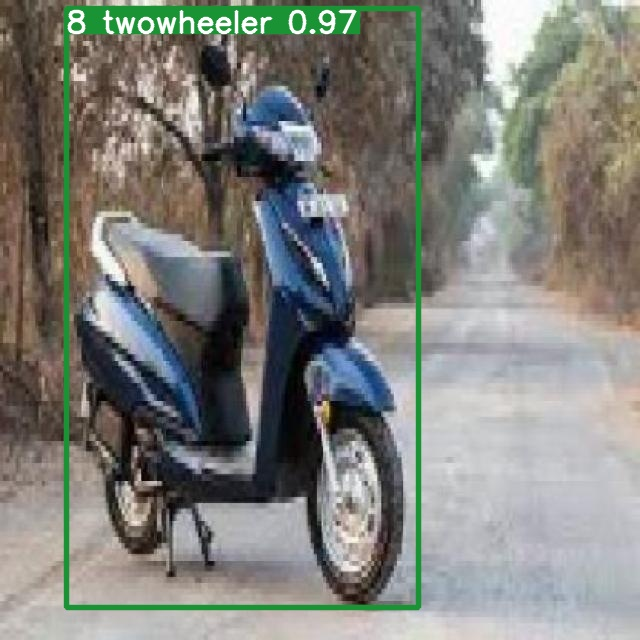

In [ ]:
import glob
from IPython.display import Image, display

for image_path in glob.glob(f'{HOME}/runs/detect/predict3/*.jpg')[:10]:
      display(Image(filename=image_path, width=600))
      print("\n")

## 1.5.2 Second Model

In [ ]:
%cd {HOME}
model = YOLO("/content/runs/detect/train2/weights/best.pt")
results_2 = model.predict(source='/content/datasets/Deep-Learning---Group-Assignment-1/test/images', conf=0.25, save=True, save_txt=True, save_conf=True)

Ultralytics YOLOv8.0.47 🚀 Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3007598 parameters, 0 gradients, 8.1 GFLOPs



/content


image 1/487 /content/datasets/Deep-Learning---Group-Assignment-1/test/images/00013_jpg.rf.97e3ac7cb4a19417eca0ccb081310f67.jpg: 640x640 1 3 car, 14.2ms
image 2/487 /content/datasets/Deep-Learning---Group-Assignment-1/test/images/000176_01_jpg.rf.b1aece50d22929d16091a0338d6ba6d2.jpg: 640x640 1 1 auto, 1 8 twowheeler, 13.2ms
image 3/487 /content/datasets/Deep-Learning---Group-Assignment-1/test/images/000203_03_jpg.rf.fc6e5ea7d9265d74802e1585a7b1ad47.jpg: 640x640 1 8 twowheeler, 13.7ms
image 4/487 /content/datasets/Deep-Learning---Group-Assignment-1/test/images/00030_jpg.rf.78216f40d0b5b9071b245adce99834c4.jpg: 640x640 1 3 car, 13.3ms
image 5/487 /content/datasets/Deep-Learning---Group-Assignment-1/test/images/00050_jpg.rf.7eec1b3e494cc5ef372926fd063771ca.jpg: 640x640 1 3 car, 13.9ms
image 6/487 /content/datasets/Deep-Learning---Group-Assignment-1/test/images/00051_jpg.rf.8c2938943ea199afb834545702982539.jpg: 640x640 1 3 car, 13.8ms
image 7/487 /content/datasets/Deep-Learning---Group-Assi

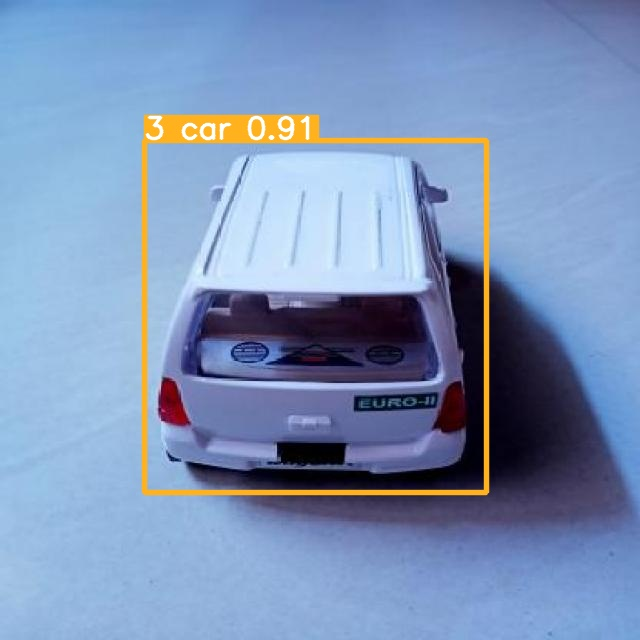

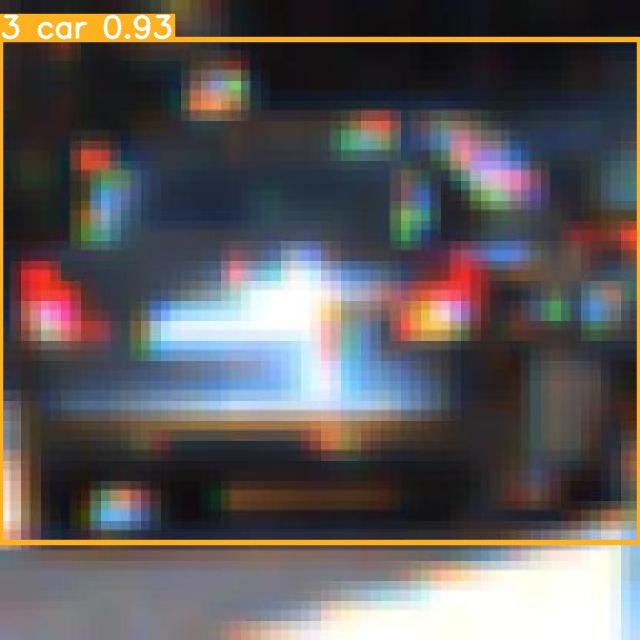

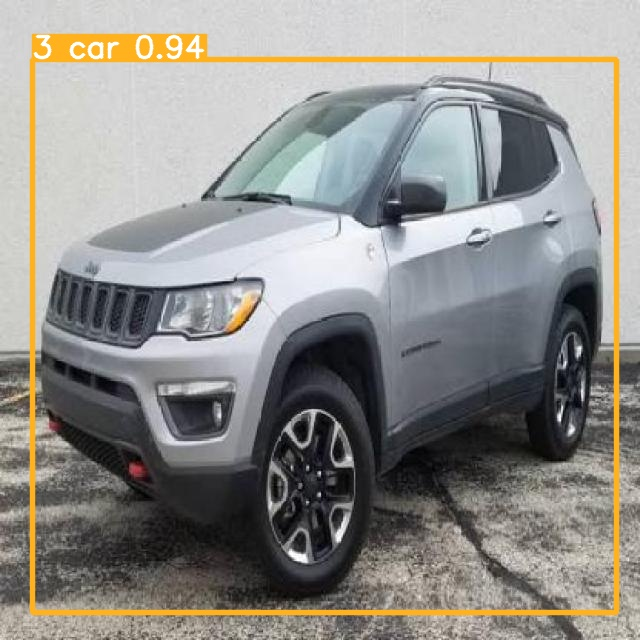

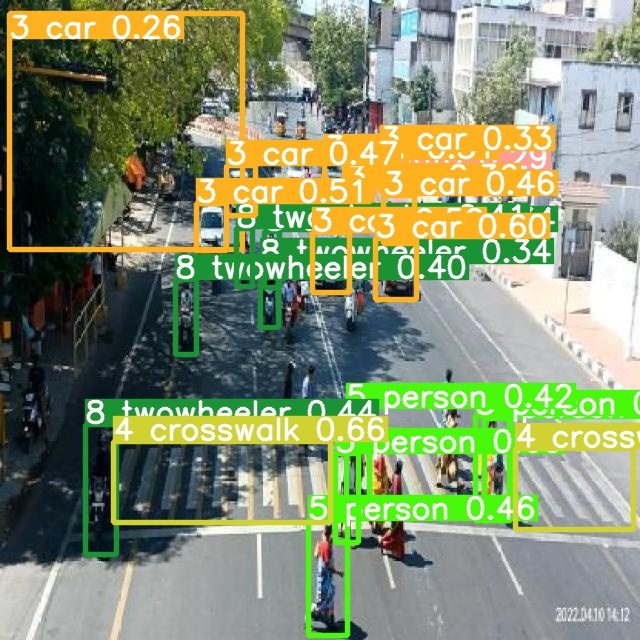

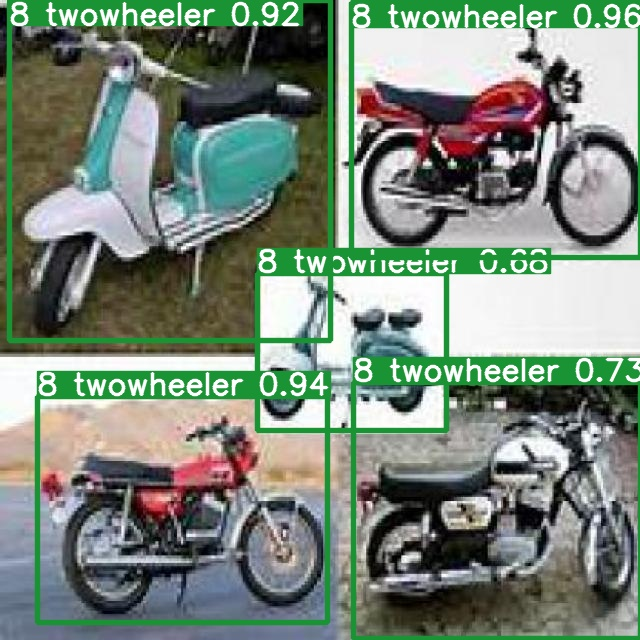

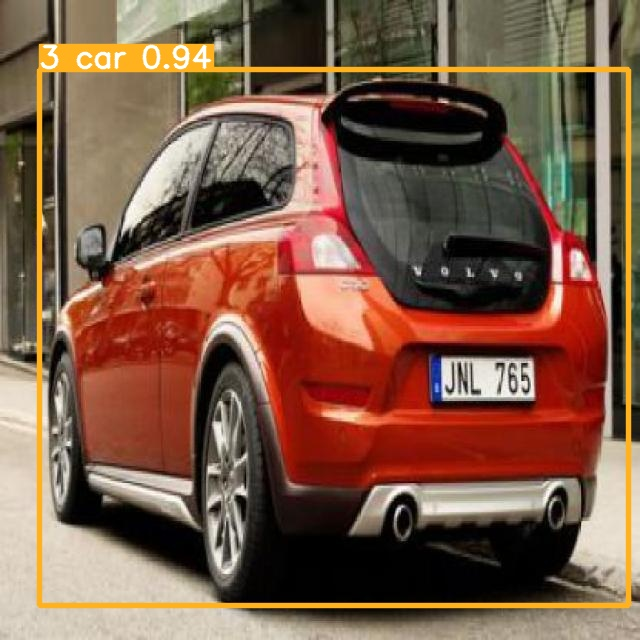

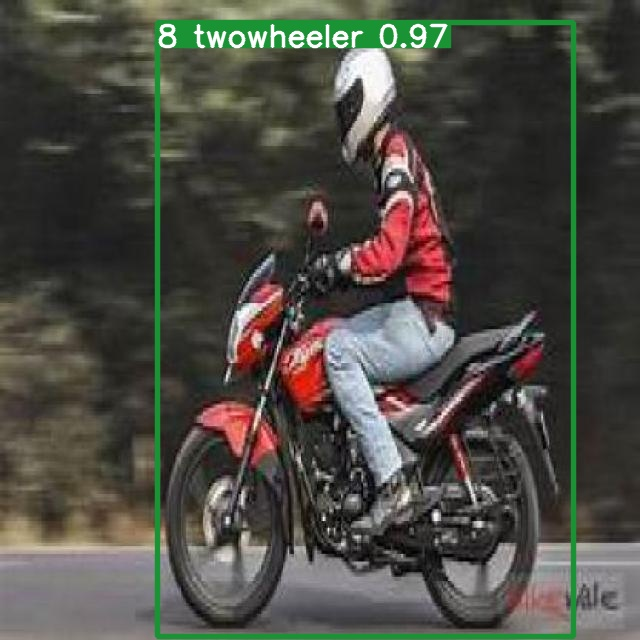

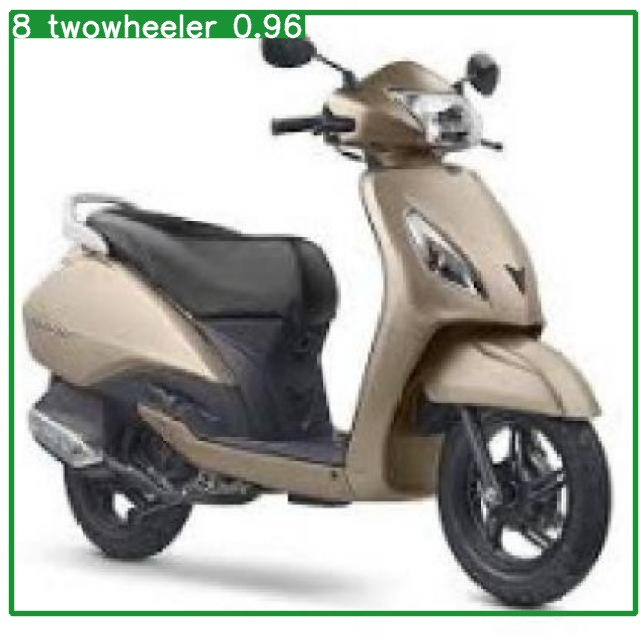

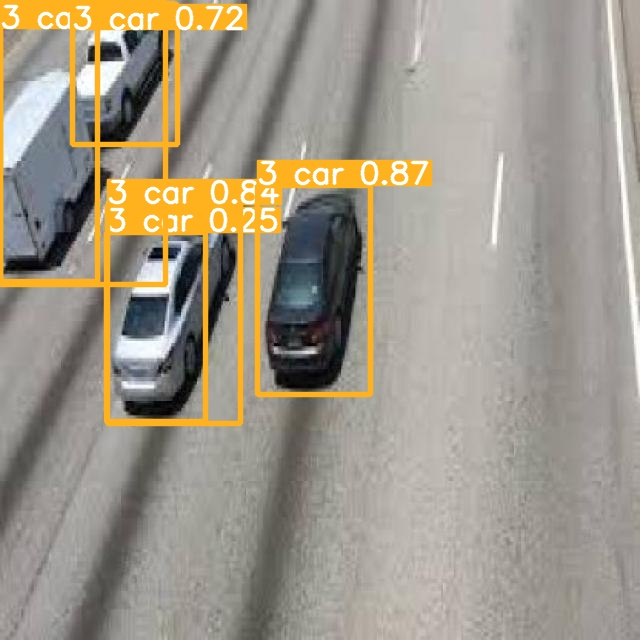

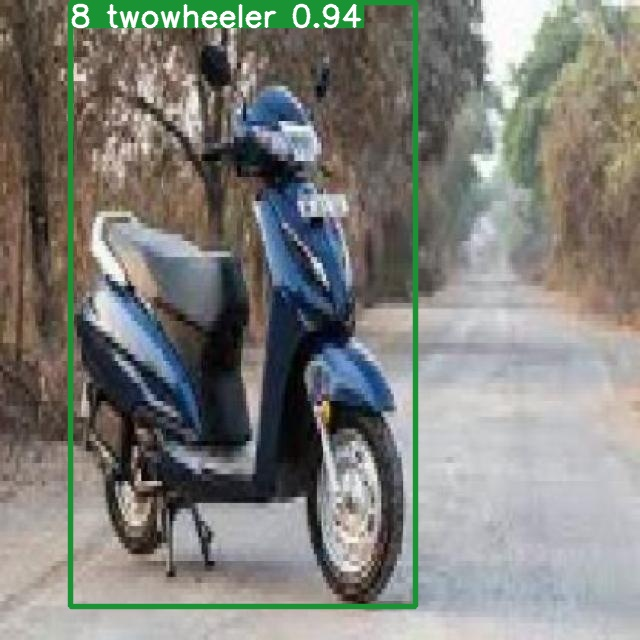

In [ ]:
import glob
from IPython.display import Image, display

for image_path in glob.glob(f'{HOME}/runs/detect/predict4/*.jpg')[:10]:
      display(Image(filename=image_path, width=600))
      print("\n")

## 1.5.3 Third model


In [ ]:
%cd {HOME}
model = YOLO("/content/runs/detect/train3/weights/best.pt")
results_3 = model.predict(source='/content/datasets/Deep-Learning---Group-Assignment-2/test/images', conf=0.25, save=True, save_txt=True, save_conf=True)

Ultralytics YOLOv8.0.47 🚀 Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3007598 parameters, 0 gradients, 8.1 GFLOPs



/content


image 1/1948 /content/datasets/Deep-Learning---Group-Assignment-2/test/images/00013_jpg.rf.0c726f76af42a48751097e7a4f5faf24.jpg: 640x640 2 5 persons, 1 8 twowheeler, 15.8ms
image 2/1948 /content/datasets/Deep-Learning---Group-Assignment-2/test/images/00013_jpg.rf.2492f32995ffbe78f15bd3e532974d23.jpg: 640x640 1 3 car, 16.1ms
image 3/1948 /content/datasets/Deep-Learning---Group-Assignment-2/test/images/00013_jpg.rf.529c970262c1a2f20f1811f238d8a5de.jpg: 640x640 1 3 car, 1 5 person, 15.3ms
image 4/1948 /content/datasets/Deep-Learning---Group-Assignment-2/test/images/00013_jpg.rf.7cf567b771c6f77e877af75551b1855b.jpg: 640x640 1 3 car, 15.3ms
image 5/1948 /content/datasets/Deep-Learning---Group-Assignment-2/test/images/000176_01_jpg.rf.0e48d3e3b41fff84c94b6141b82795a5.jpg: 640x640 1 3 car, 1 5 person, 15.7ms
image 6/1948 /content/datasets/Deep-Learning---Group-Assignment-2/test/images/000176_01_jpg.rf.697014088a47aed0124330eb69f61099.jpg: 640x640 1 8 twowheeler, 19.9ms
image 7/1948 /content/d

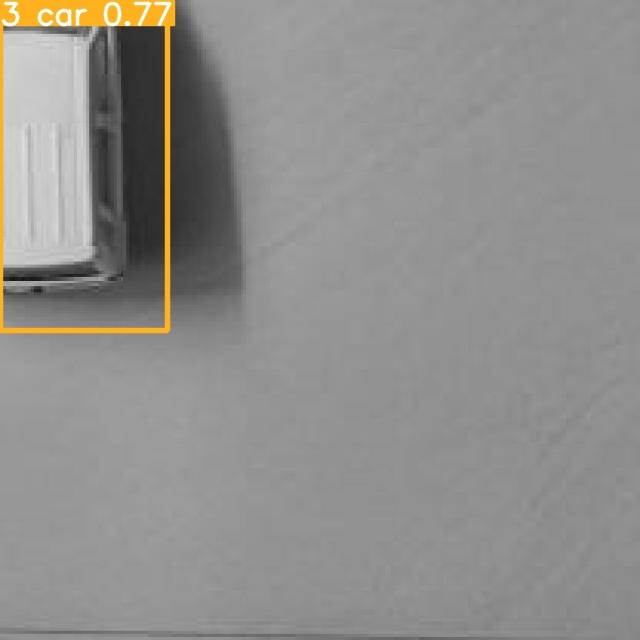

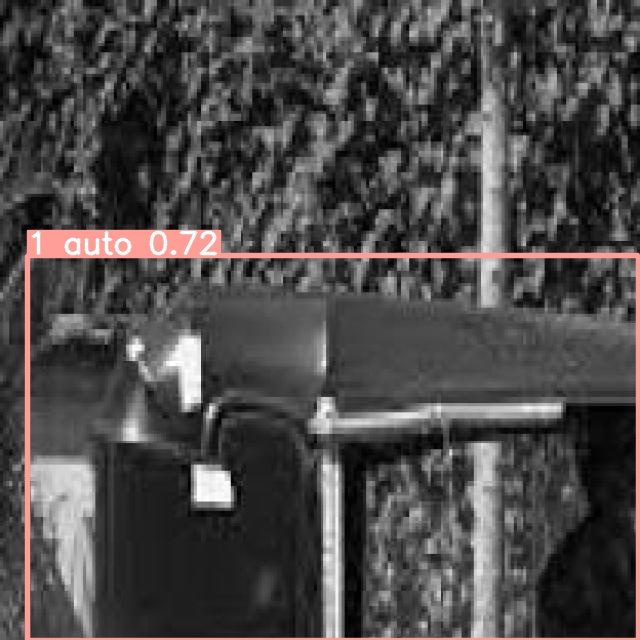

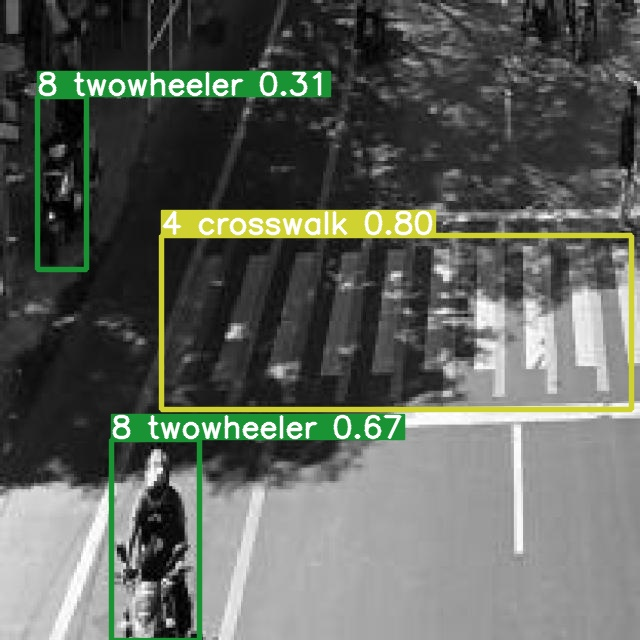

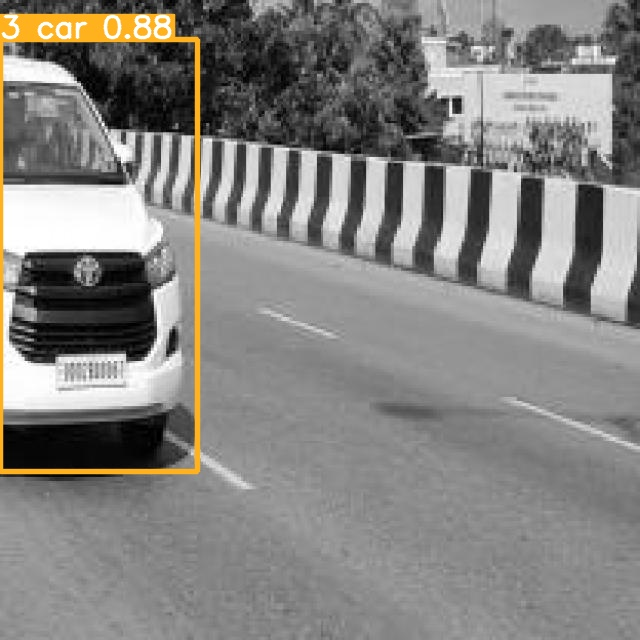

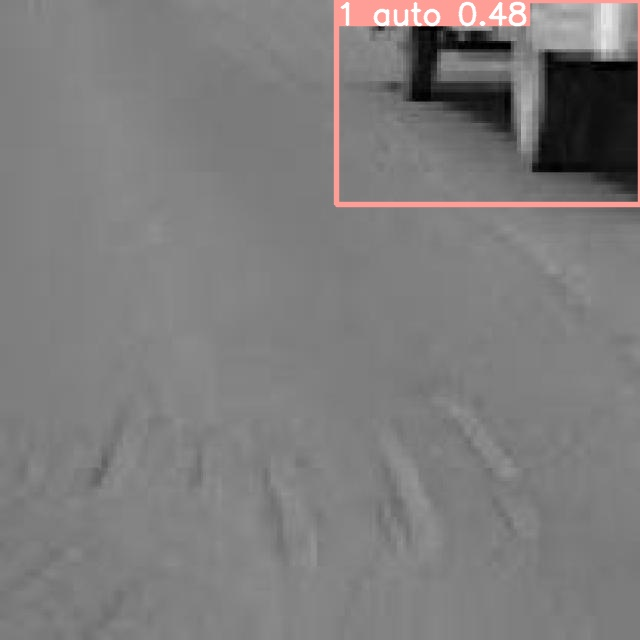

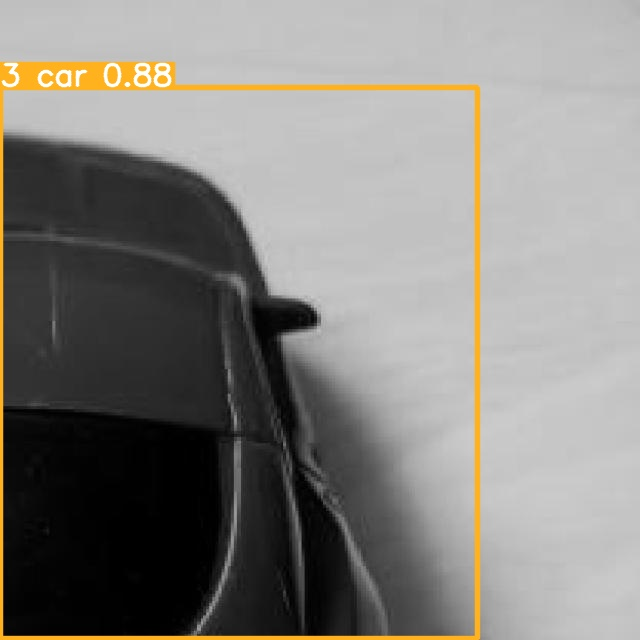

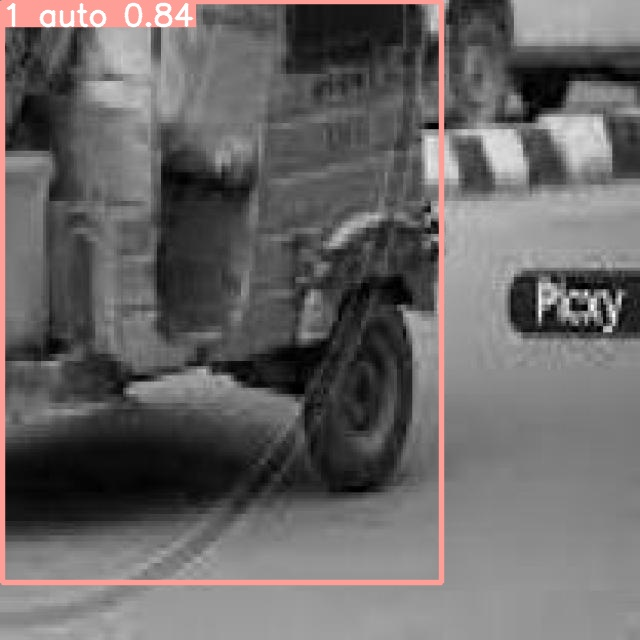

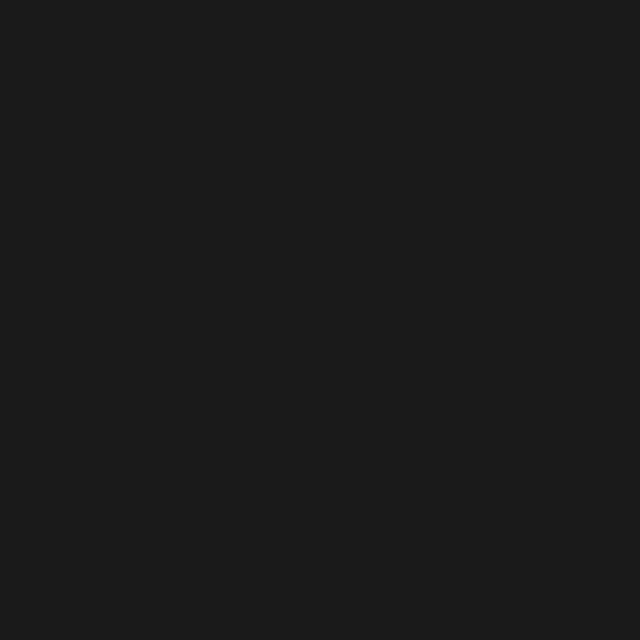

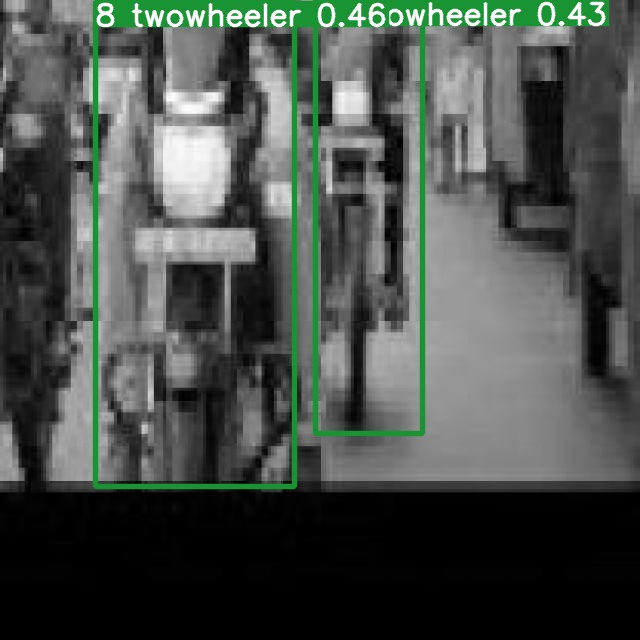

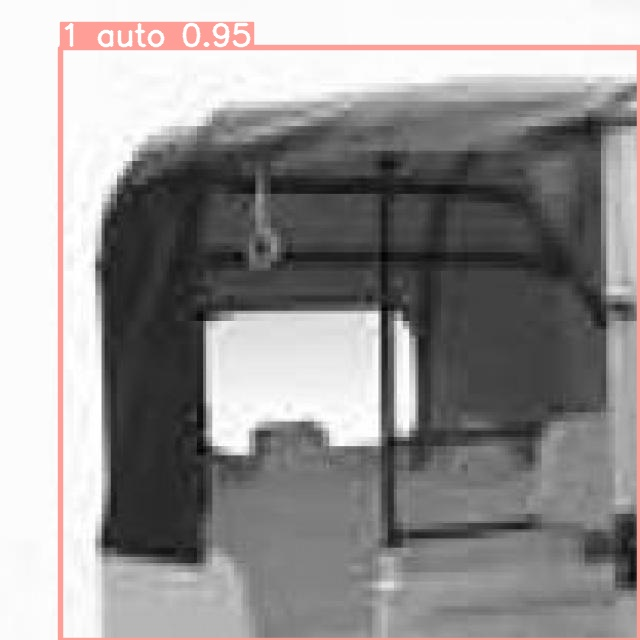

In [ ]:
import glob
from IPython.display import Image, display

for image_path in glob.glob(f'{HOME}/runs/detect/predict5/*.jpg')[:10]:
      display(Image(filename=image_path, width=600))
      print("\n")

## 1.5.4 Fourth model

In [ ]:
%cd {HOME}
model = YOLO("/content/runs/detect/train4/weights/best.pt")
results_3 = model.predict(source='/content/datasets/Deep-Learning---Group-Assignment-2/test/images', conf=0.25, save=True, save_txt=True, save_conf=True)

[Errno 2] No such file or directory: '{HOME}'
/content


Ultralytics YOLOv8.0.47 🚀 Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3007598 parameters, 0 gradients, 8.1 GFLOPs

image 1/1948 /content/datasets/Deep-Learning---Group-Assignment-2/test/images/00013_jpg.rf.0c726f76af42a48751097e7a4f5faf24.jpg: 640x640 1 5 person, 1 8 twowheeler, 9.7ms
image 2/1948 /content/datasets/Deep-Learning---Group-Assignment-2/test/images/00013_jpg.rf.2492f32995ffbe78f15bd3e532974d23.jpg: 640x640 1 3 car, 9.9ms
image 3/1948 /content/datasets/Deep-Learning---Group-Assignment-2/test/images/00013_jpg.rf.529c970262c1a2f20f1811f238d8a5de.jpg: 640x640 1 2 bus, 9.4ms
image 4/1948 /content/datasets/Deep-Learning---Group-Assignment-2/test/images/00013_jpg.rf.7cf567b771c6f77e877af75551b1855b.jpg: 640x640 1 3 car, 9.6ms
image 5/1948 /content/datasets/Deep-Learning---Group-Assignment-2/test/images/000176_01_jpg.rf.0e48d3e3b41fff84c94b6141b82795a5.jpg: 640x640 1 2 bus, 9.2ms
image 6/1948 /content/datasets/Deep-Learning---Gro

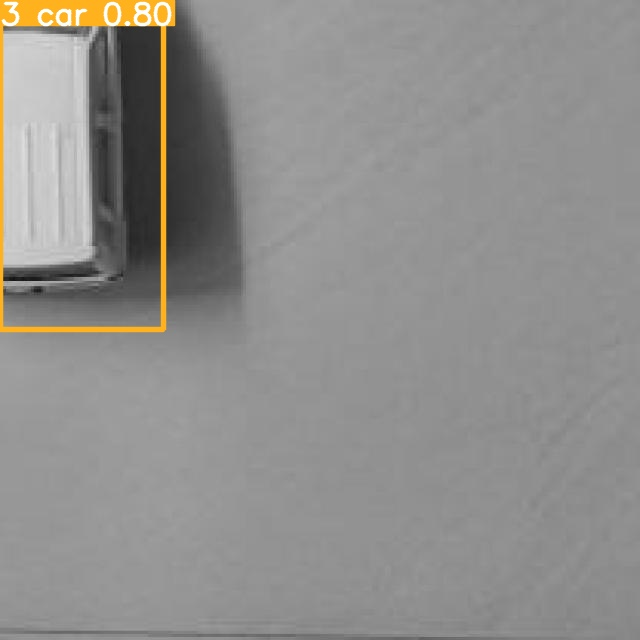

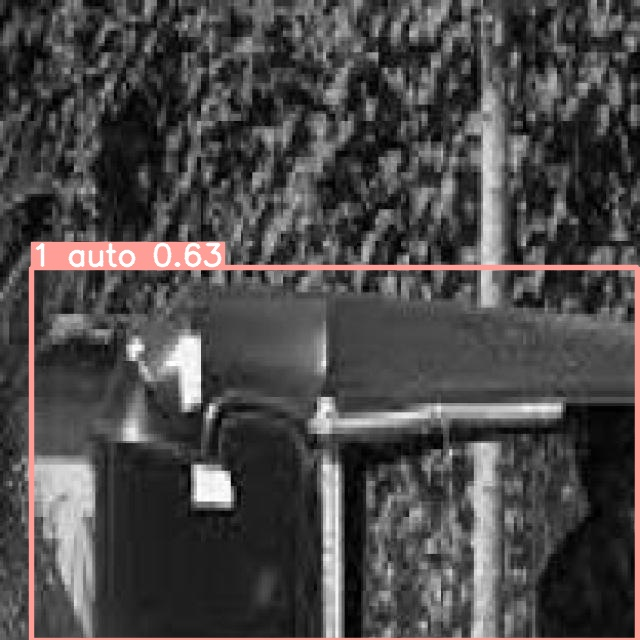

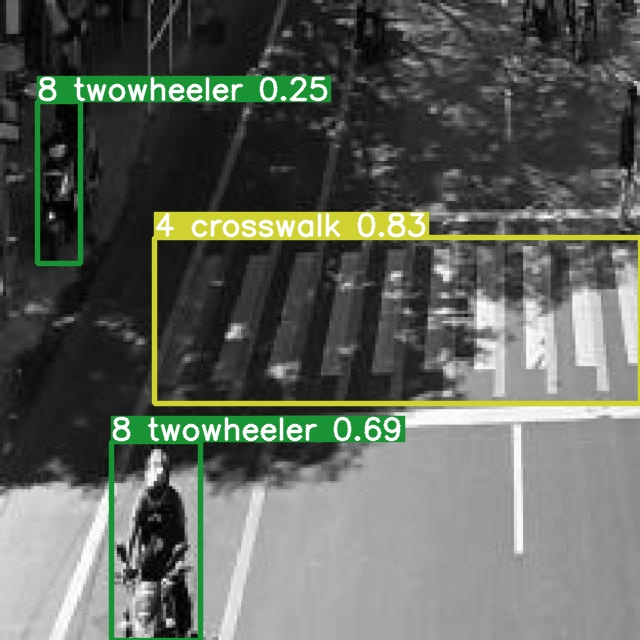

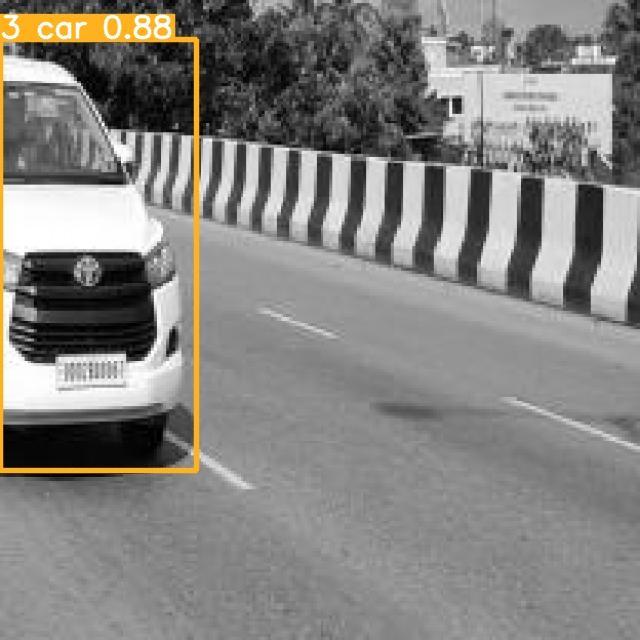

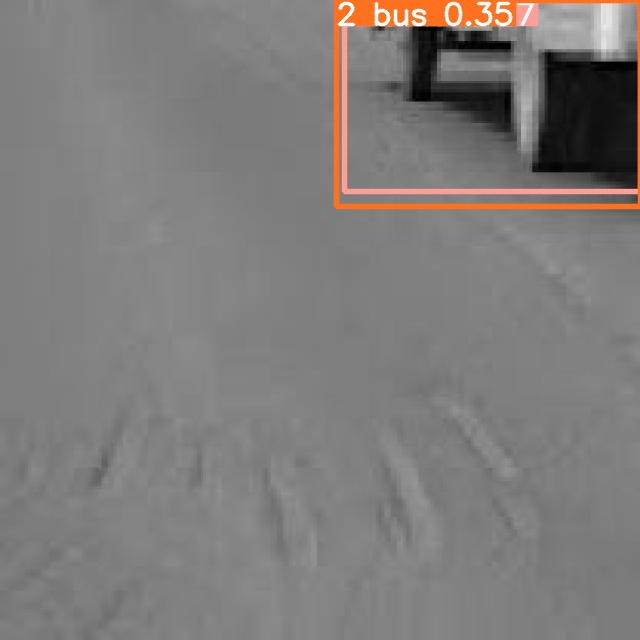

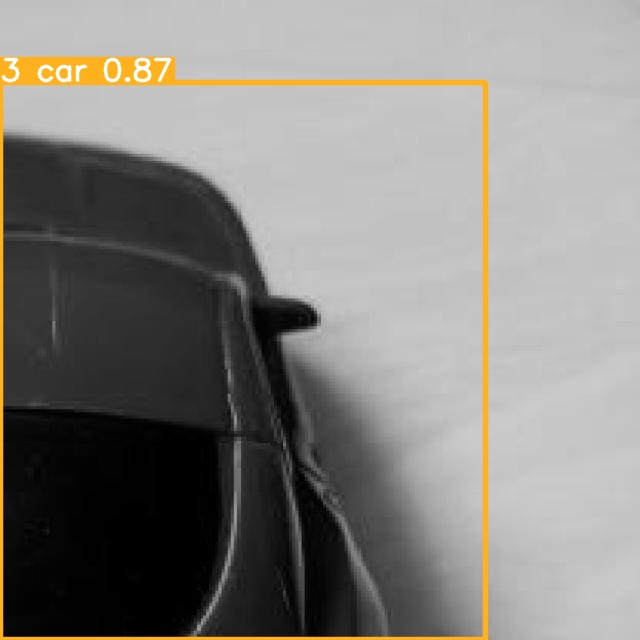

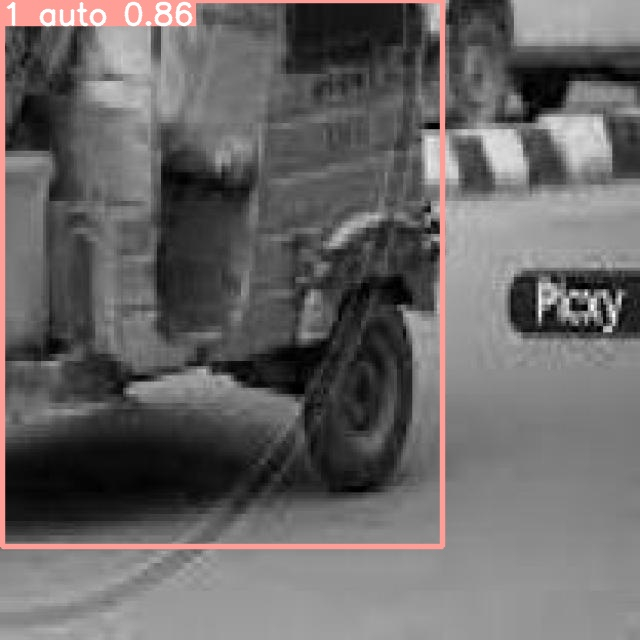

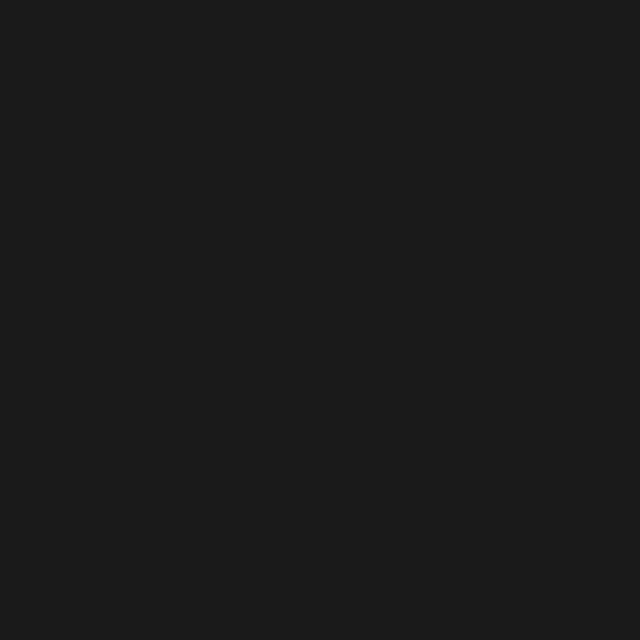

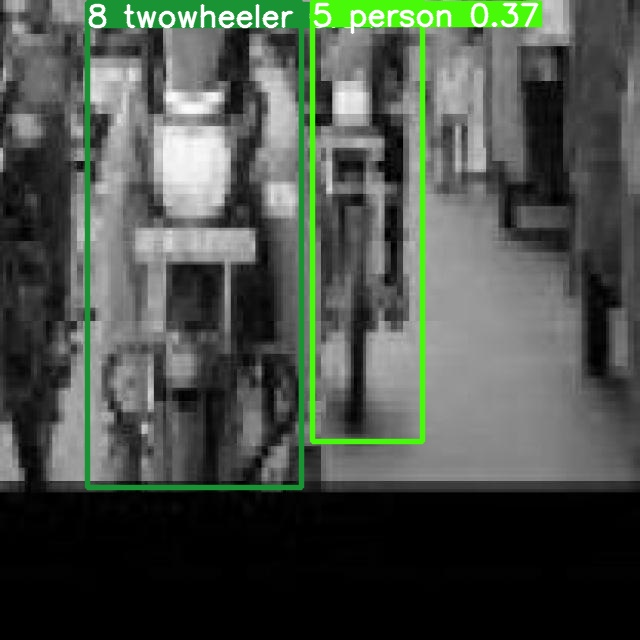

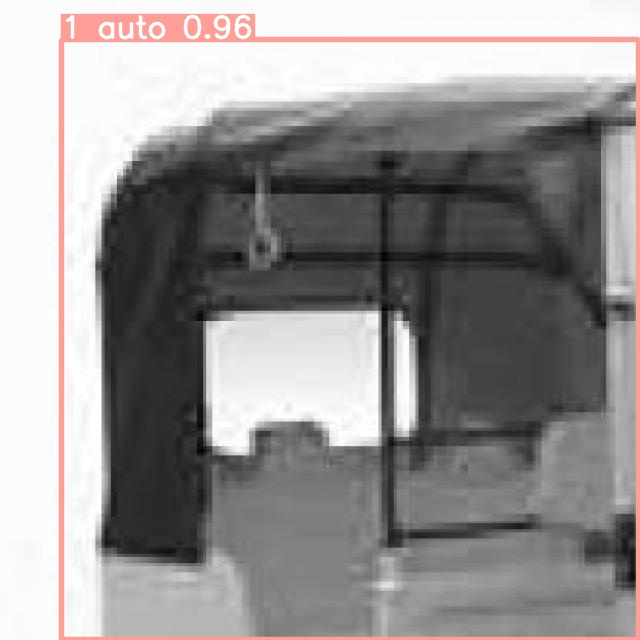

In [ ]:
import glob
from IPython.display import Image, display

for image_path in glob.glob(f'/content/runs/detect/predict10/*.jpg')[:10]:
      display(Image(filename=image_path, width=600))
      print("\n")

## 1.5.5 Fifth model

In [36]:
%cd {HOME}
model = YOLO("/content/runs/detect/train2/weights/best.pt")
results_3 = model.predict(source='/content/datasets/Deep-Learning---Group-Assignment-2/test/images', conf=0.25, save=True, save_txt=True, save_conf=True)

Ultralytics YOLOv8.0.47 🚀 Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)


/content


Model summary (fused): 168 layers, 11129454 parameters, 0 gradients, 28.5 GFLOPs

image 1/1948 /content/datasets/Deep-Learning---Group-Assignment-2/test/images/00013_jpg.rf.0c726f76af42a48751097e7a4f5faf24.jpg: 640x640 1 3 car, 2 5 persons, 25.6ms
image 2/1948 /content/datasets/Deep-Learning---Group-Assignment-2/test/images/00013_jpg.rf.2492f32995ffbe78f15bd3e532974d23.jpg: 640x640 1 3 car, 25.5ms
image 3/1948 /content/datasets/Deep-Learning---Group-Assignment-2/test/images/00013_jpg.rf.529c970262c1a2f20f1811f238d8a5de.jpg: 640x640 1 3 car, 25.5ms
image 4/1948 /content/datasets/Deep-Learning---Group-Assignment-2/test/images/00013_jpg.rf.7cf567b771c6f77e877af75551b1855b.jpg: 640x640 1 3 car, 25.6ms
image 5/1948 /content/datasets/Deep-Learning---Group-Assignment-2/test/images/000176_01_jpg.rf.0e48d3e3b41fff84c94b6141b82795a5.jpg: 640x640 1 5 person, 25.6ms
image 6/1948 /content/datasets/Deep-Learning---Group-Assignment-2/test/images/000176_01_jpg.rf.697014088a47aed0124330eb69f61099.jpg: 

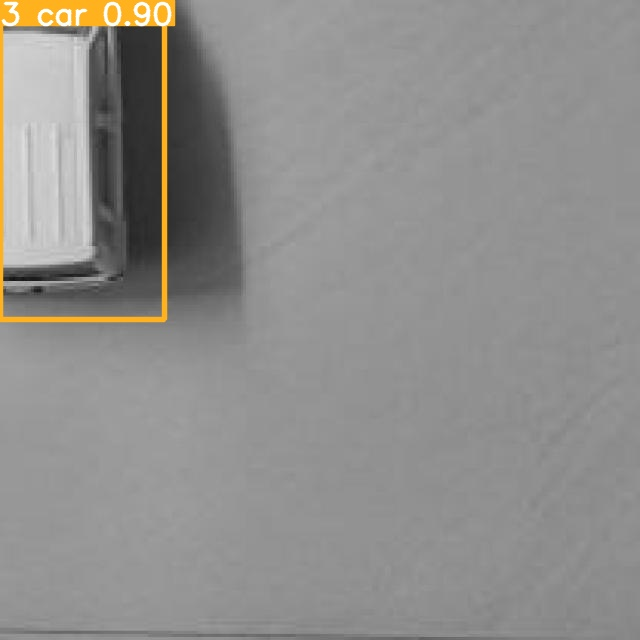

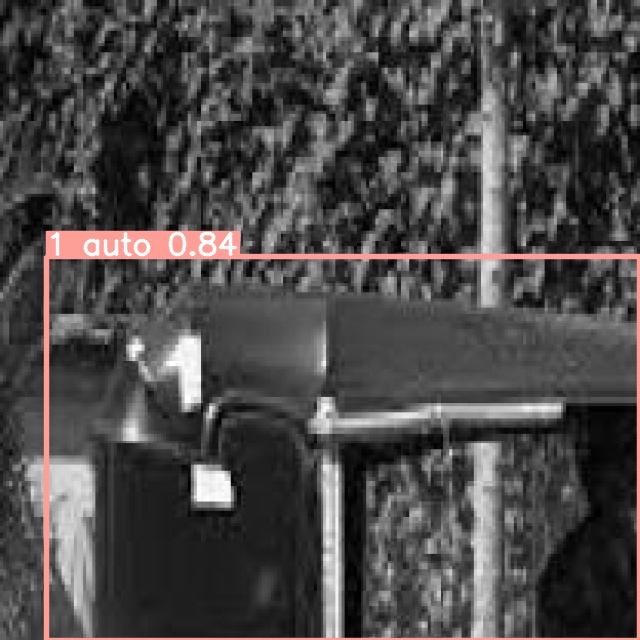

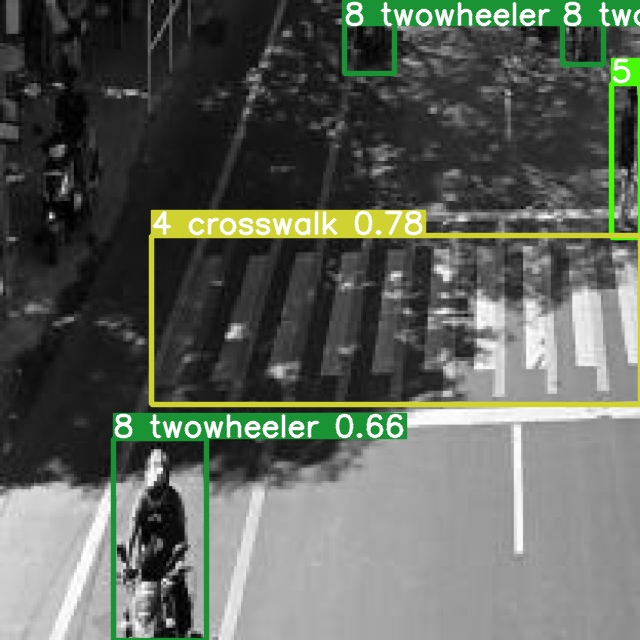

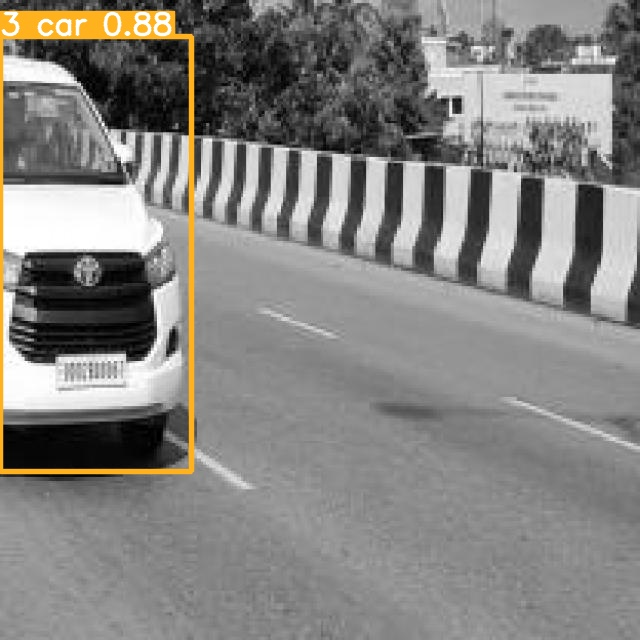

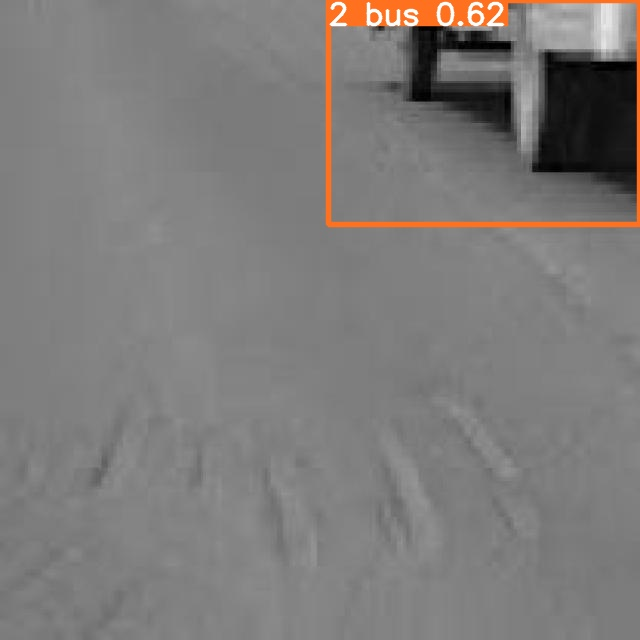

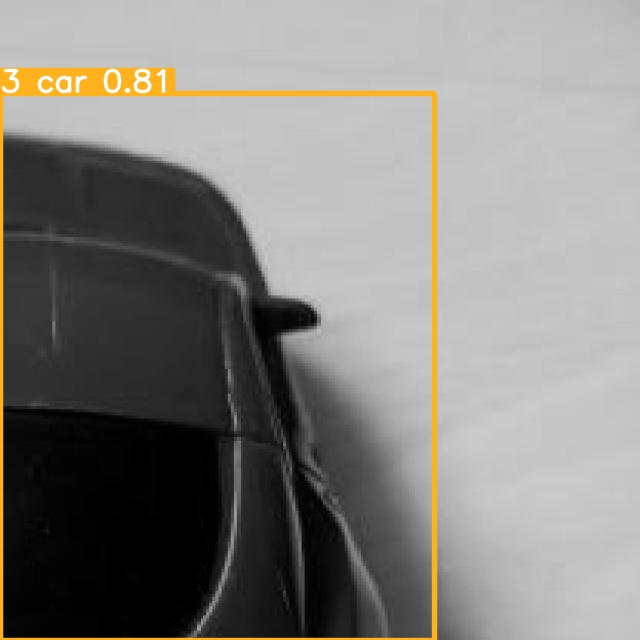

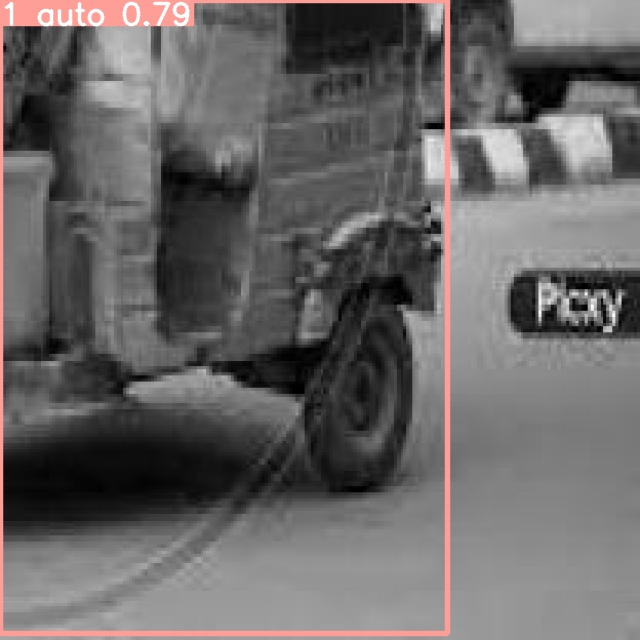

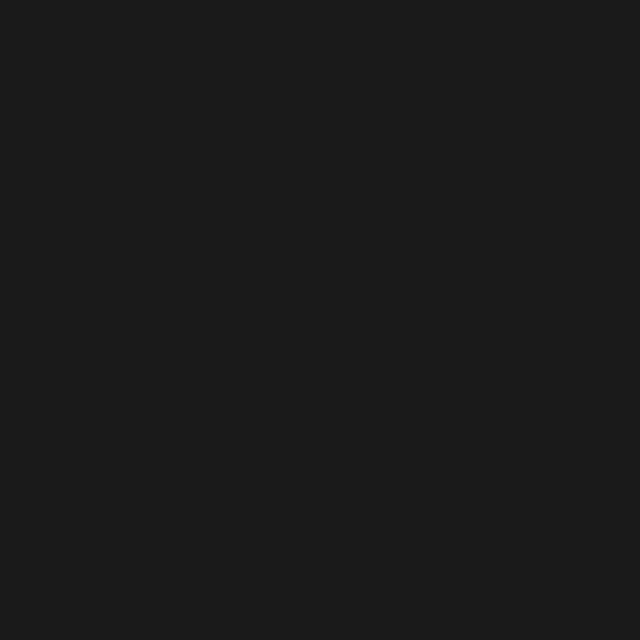

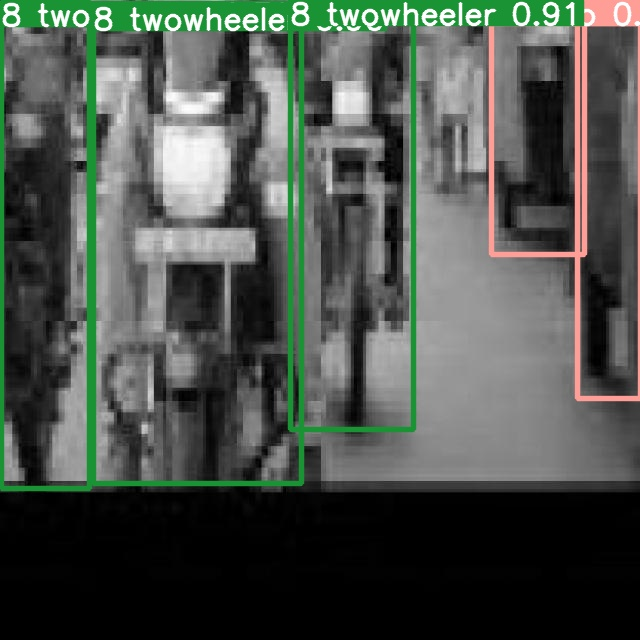

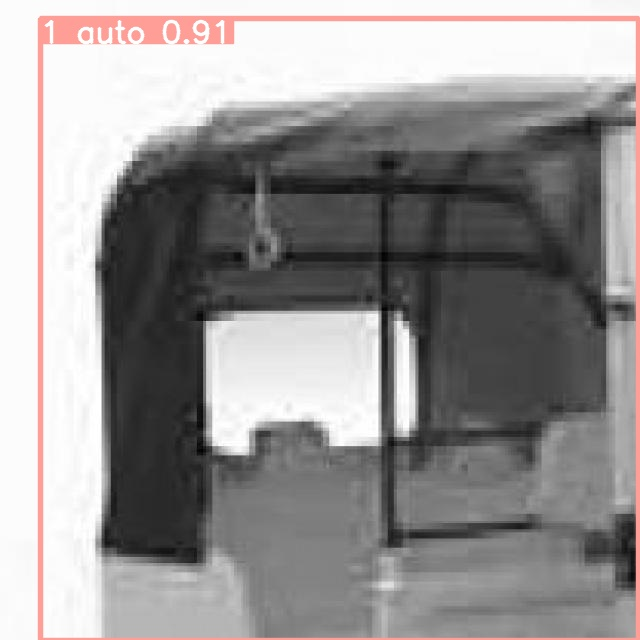

In [37]:
import glob
from IPython.display import Image, display

for image_path in glob.glob(f'/content/runs/detect/predict3/*.jpg')[:10]:
      display(Image(filename=image_path, width=600))
      print("\n")

# 1.6 Real time test

Finally, the test will be done on a video. Again, despite the final model being number 5, the real time test will be performed on every model.

## 1.6.1 First Model

In [ ]:
model = YOLO("/content/runs/detect/train/weights/best.pt")
results_test_video = model.predict(source = '/content/Video_test_driving_NY.mp4', save = True)

Ultralytics YOLOv8.0.47 🚀 Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3007598 parameters, 0 gradients, 8.1 GFLOPs

video 1/1 (1/4210) /content/Video_test_driving_NY.mp4: 384x640 (no detections), 14.6ms
video 1/1 (2/4210) /content/Video_test_driving_NY.mp4: 384x640 (no detections), 15.4ms
video 1/1 (3/4210) /content/Video_test_driving_NY.mp4: 384x640 (no detections), 13.2ms
video 1/1 (4/4210) /content/Video_test_driving_NY.mp4: 384x640 (no detections), 12.9ms
video 1/1 (5/4210) /content/Video_test_driving_NY.mp4: 384x640 (no detections), 13.6ms
video 1/1 (6/4210) /content/Video_test_driving_NY.mp4: 384x640 (no detections), 15.6ms
video 1/1 (7/4210) /content/Video_test_driving_NY.mp4: 384x640 (no detections), 13.0ms
video 1/1 (8/4210) /content/Video_test_driving_NY.mp4: 384x640 (no detections), 13.0ms
video 1/1 (9/4210) /content/Video_test_driving_NY.mp4: 384x640 (no detections), 13.4ms
video 1/1 (10/4210) /content/Video_test_driving_NY

## 1.6.2 Second Model

In [ ]:
model = YOLO("/content/runs/detect/train2/weights/best.pt")
results_test_video = model.predict(source = '/content/Video_test_driving_NY.mp4', save = True)

Ultralytics YOLOv8.0.47 🚀 Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3007598 parameters, 0 gradients, 8.1 GFLOPs

video 1/1 (1/4210) /content/Video_test_driving_NY.mp4: 384x640 1 2 bus, 15.2ms
video 1/1 (2/4210) /content/Video_test_driving_NY.mp4: 384x640 1 2 bus, 9.7ms
video 1/1 (3/4210) /content/Video_test_driving_NY.mp4: 384x640 1 2 bus, 9.6ms
video 1/1 (4/4210) /content/Video_test_driving_NY.mp4: 384x640 1 2 bus, 9.1ms
video 1/1 (5/4210) /content/Video_test_driving_NY.mp4: 384x640 1 2 bus, 9.1ms
video 1/1 (6/4210) /content/Video_test_driving_NY.mp4: 384x640 1 2 bus, 8.9ms
video 1/1 (7/4210) /content/Video_test_driving_NY.mp4: 384x640 1 2 bus, 9.3ms
video 1/1 (8/4210) /content/Video_test_driving_NY.mp4: 384x640 1 2 bus, 9.2ms
video 1/1 (9/4210) /content/Video_test_driving_NY.mp4: 384x640 1 2 bus, 9.1ms
video 1/1 (10/4210) /content/Video_test_driving_NY.mp4: 384x640 1 2 bus, 10.3ms
video 1/1 (11/4210) /content/Video_test_driving_NY

## 1.6.3 Third Model

In [ ]:
model = YOLO("/content/runs/detect/train3/weights/best.pt")
results_test_video = model.predict(source = '/content/Video_test_driving_NY.mp4', save = True)

Ultralytics YOLOv8.0.47 🚀 Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3007598 parameters, 0 gradients, 8.1 GFLOPs

video 1/1 (1/4210) /content/Video_test_driving_NY.mp4: 384x640 (no detections), 14.6ms
video 1/1 (2/4210) /content/Video_test_driving_NY.mp4: 384x640 (no detections), 9.4ms
video 1/1 (3/4210) /content/Video_test_driving_NY.mp4: 384x640 (no detections), 9.3ms
video 1/1 (4/4210) /content/Video_test_driving_NY.mp4: 384x640 (no detections), 8.7ms
video 1/1 (5/4210) /content/Video_test_driving_NY.mp4: 384x640 (no detections), 9.3ms
video 1/1 (6/4210) /content/Video_test_driving_NY.mp4: 384x640 (no detections), 8.7ms
video 1/1 (7/4210) /content/Video_test_driving_NY.mp4: 384x640 (no detections), 9.5ms
video 1/1 (8/4210) /content/Video_test_driving_NY.mp4: 384x640 (no detections), 8.6ms
video 1/1 (9/4210) /content/Video_test_driving_NY.mp4: 384x640 (no detections), 9.1ms
video 1/1 (10/4210) /content/Video_test_driving_NY.mp4: 38

## 1.6.4 Fourth Model

In [10]:
model = YOLO("/content/runs/detect/train/weights/best.pt")
results_test_video = model.predict(source = '/content/Video_test_driving_Delhi.mp4', save = True)

Ultralytics YOLOv8.0.47 🚀 Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3007598 parameters, 0 gradients, 8.1 GFLOPs

video 1/1 (1/1877) /content/Video_test_driving_Delhi.mp4: 384x640 1 3 car, 13.0ms
video 1/1 (2/1877) /content/Video_test_driving_Delhi.mp4: 384x640 2 3 cars, 13.5ms
video 1/1 (3/1877) /content/Video_test_driving_Delhi.mp4: 384x640 2 3 cars, 14.7ms
video 1/1 (4/1877) /content/Video_test_driving_Delhi.mp4: 384x640 2 3 cars, 16.1ms
video 1/1 (5/1877) /content/Video_test_driving_Delhi.mp4: 384x640 2 3 cars, 13.6ms
video 1/1 (6/1877) /content/Video_test_driving_Delhi.mp4: 384x640 1 3 car, 13.3ms
video 1/1 (7/1877) /content/Video_test_driving_Delhi.mp4: 384x640 1 3 car, 13.0ms
video 1/1 (8/1877) /content/Video_test_driving_Delhi.mp4: 384x640 2 3 cars, 13.0ms
video 1/1 (9/1877) /content/Video_test_driving_Delhi.mp4: 384x640 1 3 car, 13.2ms
video 1/1 (10/1877) /content/Video_test_driving_Delhi.mp4: 384x640 1 3 car, 13.0ms
video 1

## 1.6.5 Fifth Model

In [14]:
model = YOLO("/content/runs/detect/train2/weights/best.pt")
results_test_video = model.predict(source = '/content/Video_test_driving_Delhi.mp4', save = True)

Ultralytics YOLOv8.0.47 🚀 Python-3.8.10 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 11129454 parameters, 0 gradients, 28.5 GFLOPs

video 1/1 (1/1877) /content/Video_test_driving_Delhi.mp4: 384x640 3 3 cars, 14.9ms
video 1/1 (2/1877) /content/Video_test_driving_Delhi.mp4: 384x640 3 3 cars, 13.7ms
video 1/1 (3/1877) /content/Video_test_driving_Delhi.mp4: 384x640 3 3 cars, 13.7ms
video 1/1 (4/1877) /content/Video_test_driving_Delhi.mp4: 384x640 3 3 cars, 1 8 twowheeler, 13.3ms
video 1/1 (5/1877) /content/Video_test_driving_Delhi.mp4: 384x640 3 3 cars, 13.5ms
video 1/1 (6/1877) /content/Video_test_driving_Delhi.mp4: 384x640 2 3 cars, 15.3ms
video 1/1 (7/1877) /content/Video_test_driving_Delhi.mp4: 384x640 3 3 cars, 17.4ms
video 1/1 (8/1877) /content/Video_test_driving_Delhi.mp4: 384x640 2 3 cars, 15.9ms
video 1/1 (9/1877) /content/Video_test_driving_Delhi.mp4: 384x640 2 3 cars, 15.0ms
video 1/1 (10/1877) /content/Video_test_driving_Delhi.mp4: 384x640 2

# 1.7 Exporting the results

In [ ]:
!zip -r /content/results.zip /content/runs/detect

In [12]:
from google.colab import files
files.download("/content/results.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>